In [1]:
import pandas as pd
#pd.set_option('display.max_rows', None)
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib import path
import os
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
import numpy as np
import netCDF4 as nc
np.set_printoptions(threshold=100000)
from shapely.geometry import Polygon, Point, MultiPoint
from shapely.ops import cascaded_union
from datetime import datetime, timedelta
import time
import warnings
import datetime
import math
from scipy.ndimage.interpolation import shift
import shapely.wkt
from scipy.stats import pearsonr,spearmanr,kendalltau
from scipy.optimize import curve_fit 

warnings.filterwarnings('ignore')
import seaborn as sns
sns.set(font_scale=1.4) 
from my_functions import sat_vap_press, vap_press, hot_dry_windy, haines
from sklearn.metrics import r2_score


In [2]:
def plot_correlations(df_all, fig_title,correlation_type):
    #make the correlation matrix
    corrMatrix = df_all.corr(method=correlation_type)
    
    #plot it
    fig,ax=plt.subplots(figsize=(35,35))
    sns.heatmap(corrMatrix, annot=True,vmin=-1, vmax=1, cmap='seismic', annot_kws={'fontsize':28})
    plt.title(fig_title, fontsize=20)
    plt.show()

In [3]:
#plots two lines, on one or on the same axis
# IN: datax, x axis vector (time)
# IN: datay, 2*n vector of the data
# IN: linelabels, string vector of the labels of each line, to go in the legend
# IN: axis labels, labels of the axis
# IN: title, string for title of figire
# IN: twoaxis, if 1 plot data on two separate axes, else plot on the same axis
# OUT: a graph
def plot_twoline(datax, datay, title, linelabels, axislabels, twoaxis,xtickspacing):
    fig, ax = plt.subplots(figsize=(20,6)) #set up the figure
    if twoaxis==1:
        ax.plot(datax, datay[0,:], 'ro-') # plot the first line
        ax.set_ylabel(axislabels[0], fontsize=24, color='red')
        #ax.set_ylim(bottom=0,top = np.nanmax(datay))
        ax2=ax.twinx()
        ax2.plot(datax, datay[1,:], 'bo-') #plot the second line
        ax2.set_ylabel(axislabels[1], fontsize=24, color='blue')
        #ax2.set_ylim(bottom=0,top = np.nanmax(datay))
    else:
        ax.plot(datax, datay[0,:], 'ro-') # plot the first line
        ax.plot(datax, datay[1,:], 'bo-') # plot the second line
        ax.set_ylabel(axislabels, fontsize=24) 
    #print(np.arange(1,len(datax.values),6))
    plt.xticks(np.arange(1,len(datax.values),xtickspacing))    
    plt.legend(linelabels,fontsize=24)
    plt.title(title,fontsize=24)
    plt.grid()
    plt.show()


In [4]:
#IN df_to_shift: the dataframe we want to shift
#IN ndays: how many days we want to shift, ndays>0 shift forward, ndays<0 shift backward
def shift_ndays(df_to_shift,ndays,name_col_to_shift, name_shifted_col):
    df_shifted = df_to_shift.set_index(pd.to_datetime(df_to_shift['day'])).drop(columns=['day'])
    df_shifted=df_shifted.resample('24H',origin='start').asfreq()
    #process some daily changes in FRP
    for ii in range(len(name_shifted_col)):
        df_shifted[name_shifted_col[ii]] = df_shifted[name_col_to_shift[ii]].shift(ndays)
    inds = df_shifted.index.isin(df_to_shift['day'])
    return df_shifted[inds].reset_index()

In [5]:
def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):
    fig,ax=plt.subplots(figsize=(10,10))
    sns.scatterplot(data =df_plot, x=x_plot,y=y_plot,hue=point_hue,
                    style=point_style,size=point_size,sizes=point_size_range,ax=ax,cmap='jet')
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
    plt.title(plot_title)
    plt.show()

In [6]:
# Medium post on error metrics https://towardsdatascience.com/time-series-forecast-error-metrics-you-should-know-cc88b8c67f27
def RMSE(y_pred,y_test):
    return np.sqrt(np.mean(((y_pred)-(y_test))**2))

def MAD(y_pred,y_test): #aka mean error
    return np.mean(np.abs(y_pred-y_test))

def mean_percent_error(y_pred,y_test):
    return(np.mean(np.abs(100*(y_pred-y_test)/y_test)))

def fractional_error(y_pred, y_test):
    num=np.sum(np.abs(y_pred-y_test))
    denom=np.sum((y_pred+y_test)/2)
    return(num/denom)

def mdrae(y_test, y_pred, bnchmrk):
    return np.median(np.abs(y_test - y_pred)/np.abs(y_test - bnchmrk))

def REC(y_pred, y_test):
    percent_error = np.abs((y_pred-y_test)/y_test)*100
    thresholds = np.linspace(0,300, 61) #5% increments

    #percent_error = np.abs(y_pred-y_test)
    #thresholds = np.linspace(0, 0.5e-6, 61) #5% increments
    acc = np.zeros(thresholds.shape)
    for ii in range(len(thresholds)):
        n_correct = len(percent_error[percent_error<=thresholds[ii]])
        acc[ii] = n_correct*100/len(y_test)
    return thresholds, acc

def AUC(acc):
    return(np.sum(acc*5)) #left hand approximation, assuming bins are 5 wide

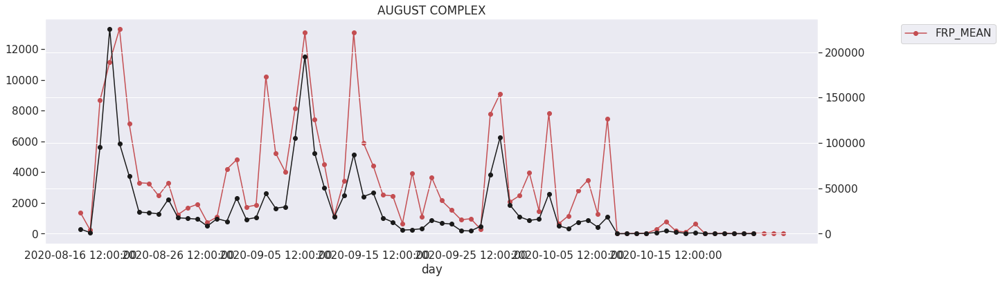

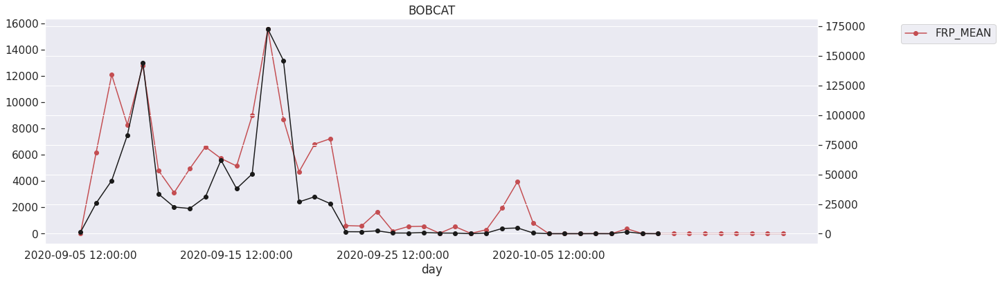

In [20]:
# line plots of FRP from all test cases, daily sum of FRP for 3km data
#fire_incidents = ['204 COW', 'GRANITE GULCH', 'SHADY', 'WILLIAMS FLATS', 'PEDRO MOUNTAIN', 'WALKER',
#                 'AUGUST COMPLEX','BOBCAT', 'CAMERON PEAK']
fire_incidents = ['AUGUST COMPLEX','BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features_3/'
path_features_coarse='/data2/lthapa/ML_daily/fire_features/'

start_time=12

for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    rave_coarse = pd.read_csv(path_features_coarse+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    
    fig, ax = plt.subplots(figsize=(20,15)) 
    rave.plot(x='day', y=['FRP_MEAN'],
                            figsize=(20,6),style='ro-',ax=ax )
    rave_coarse.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    ax.legend(h1, l1,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(fire_incidents[ii])
    plt.show()

## Put all of the cases together

In [24]:
def combine_fires(inci_name_list):
    #most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
    hrrr_ws_all = pd.DataFrame()
    names_all = pd.DataFrame()
    resources_all = pd.DataFrame()
    fuel_loading_all = pd.DataFrame()
    days_all = pd.DataFrame()
    rave_all = pd.DataFrame()
    fwi_all = pd.DataFrame()
    smops_all = pd.DataFrame()
    pws_all = pd.DataFrame()
    ncar_all = pd.DataFrame()
    chi_all = pd.DataFrame()
    pft_all = pd.DataFrame()
    
    path_features='/data2/lthapa/ML_daily/fire_features/'
    path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
    suffix_poly = 'Z_day_start.geojson'
    start_time=12
    for ii in range(len(inci_name_list)):
        file_prefix = inci_name_list[ii].lower().replace(' ', '_')
        print(file_prefix)

        #load in the data
        rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
        #hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
        hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_HDW2_'+str(start_time)+'Z_day_start.csv')
        resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')
        fuels = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
        #slopes = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
        fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_NoAve_'+str(start_time)+'Z_day_start.csv')
        smops = pd.read_csv(path_features+file_prefix+'_Daily_SMOPS_'+str(start_time)+'Z_day_start.csv')
        pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv')
        ncar = pd.read_csv(path_features+file_prefix+'_Daily_NCAR_Moisture_'+str(start_time)+'Z_day_start.csv')
        chi = pd.read_csv(path_features+file_prefix+'_Daily_CHI_'+str(start_time)+'Z_day_start.csv')
        pft = pd.read_csv(path_features+file_prefix+'_Daily_PFT_'+str(start_time)+'Z_day_start.csv')


        #derive some additional stuff
        names = pd.DataFrame({'name':[inci_name_list[ii]]*len(rave)})
        days = pd.DataFrame({'day':np.zeros(len(rave))})
        days['day'] = rave['day'].values

        #do the shift
        rave_shifted = shift_ndays(rave, 1, ['Mean_FRP'], ['Yesterday_FRP'])
        hrrr_ws_shifted = shift_ndays(hrrr_ws, 1, ['hd0w0','hd1w0','hwp'],['Yesterday_hd0w0', 'Yesterday_hd1w0','Yesterday_hwp'])
        fwi_shifted = shift_ndays(fwi, 1,['IMERG.FINAL.v6_FWI'],['Yesterday_fwi'])
        resources_shifted = shift_ndays(resources,1,['percent_contained'],['Yesterday_percent_contained'])
        ncar_shifted = shift_ndays(ncar, 1, ['FMCG2D','FMCGLH2D'],['Yesterday_FMCG2D','Yesterday_FMCGLH2D'])
        chi_shifted = shift_ndays(chi,1,['chi'],['Yesterday_chi'])

        if inci_name_list[ii] =='HOLIDAY FARM':#holiday farm is missing the first day in reosurces, drop it
            rave_shifted = rave_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            hrrr_ws_shifted = hrrr_ws_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            names = names.drop(labels=0,axis=0).reset_index(drop=True)
            fuels = fuels.drop(labels=0,axis=0).reset_index(drop=True)
            days = days.drop(labels=0,axis=0).reset_index(drop=True)
            fwi_shifted = fwi_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            smops = smops.drop(labels=0,axis=0).reset_index(drop=True)
            pws = pws.drop(labels=0,axis=0).reset_index(drop=True)
            ncar_shifted=ncar_shifted.drop(labels=0, axis=0).reset_index(drop=True)
            chi_shifted = chi_shifted.drop(labels=0, axis=0).reset_index(drop=True)
            pft = pft.drop(labels=0, axis=0).reset_index(drop=True)

            
        inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

        hrrr_ws_all = pd.concat([hrrr_ws_all, hrrr_ws_shifted.iloc[inds_active]],axis=0)
        names_all = pd.concat([names_all, names.iloc[inds_active]],axis=0)
        resources_all = pd.concat([resources_all, resources_shifted.iloc[inds_active]],axis=0)
        fuel_loading_all = pd.concat([fuel_loading_all, fuels.iloc[inds_active]],axis=0)
        days_all = pd.concat([days_all, days.iloc[inds_active]],axis=0)
        fwi_all = pd.concat([fwi_all, fwi_shifted.iloc[inds_active]])
        rave_all = pd.concat([rave_all, rave_shifted.iloc[inds_active]],axis=0)
        smops_all = pd.concat([smops_all,smops.iloc[inds_active]],axis=0)
        pws_all = pd.concat([pws_all,pws.iloc[inds_active]],axis=0)
        ncar_all = pd.concat([ncar_all, ncar_shifted.iloc[inds_active]],axis=0)
        chi_all = pd.concat([chi_all,chi_shifted.iloc[inds_active]],axis=0)
        pft_all = pd.concat([pft_all, pft.iloc[inds_active]],axis=0)
        
    #put the features together
    print(fwi_all)
    print(days_all)
    features_list = [days_all[['day']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                hrrr_ws_all[['vpd_2m','hd0w0','hd1w0','hwp','Yesterday_hd0w0','Yesterday_hwp']].reset_index(drop=True),
                resources_all[['Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['Low_N','Moderate_N','High_N','VeryHigh_N','Extreme_N']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FFMC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_DC',
                         'IMERG.FINAL.v6_FWI','Yesterday_fwi']].reset_index(drop=True),
                smops_all[['Blended_SM']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True),
                ncar_all[['FMCG2D','FMCGLH2D','Yesterday_FMCG2D','Yesterday_FMCGLH2D']].reset_index(drop=True),
                chi_all[['temp_850','temp_700','dewpt_850','ca','cb','chi','Yesterday_chi']].reset_index(drop=True),
                pft_all[['PFT']].reset_index(drop=True)

                ]
    features = pd.concat(features_list,axis=1)
    
    return features

In [25]:
incidents = ['AUGUST COMPLEX','BOBCAT', 'DOLAN', 'HOLIDAY FARM','CREEK', 'LAKE', 'CAMERON PEAK', 'PINE GULCH','EAST TROUBLESOME']
features= combine_fires(incidents)
features

features['Mean_FRP_GW'] = features['Mean_FRP']/1000

august_complex
bobcat
dolan
holiday_farm
creek
lake
cameron_peak
pine_gulch
east_troublesome
          day  Unnamed: 0  IMERG.FINAL.v6_DC  IMERG.FINAL.v6_DMC  \
0  2020-08-16         0.0         951.252930          215.804047   
1  2020-08-17         1.0         938.127686          118.552208   
2  2020-08-18         2.0         911.440247           84.243073   
3  2020-08-19         3.0         920.865845           90.447594   
4  2020-08-20         4.0         930.258179           96.561996   
..        ...         ...                ...                 ...   
7  2020-10-20         7.0        1056.612549          255.526077   
8  2020-10-21         8.0         997.124991          222.501411   
9  2020-10-22         9.0        1015.799331          232.974718   
10 2020-10-23        10.0         969.306320          206.479928   
11 2020-10-24        11.0         976.234089          209.852808   

    IMERG.FINAL.v6_FFMC  IMERG.FINAL.v6_ISI  IMERG.FINAL.v6_BUI  \
0             98.260033

## VPD Plots for Pablo

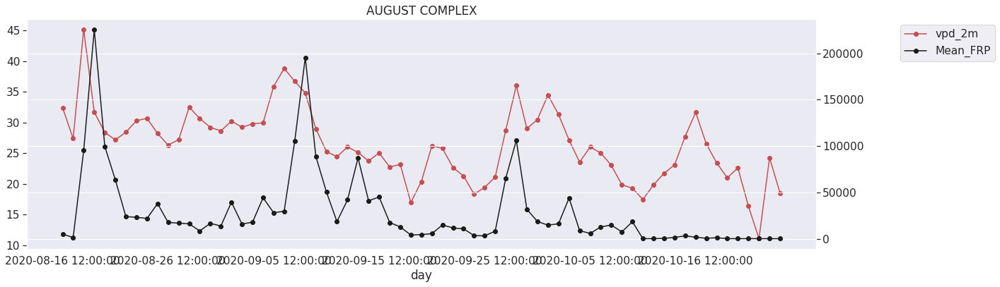

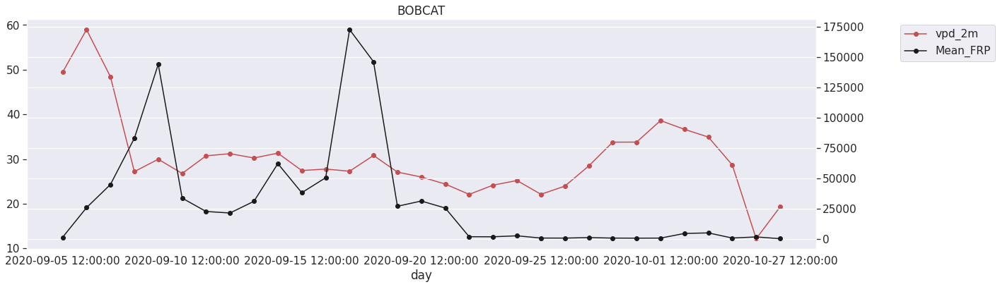

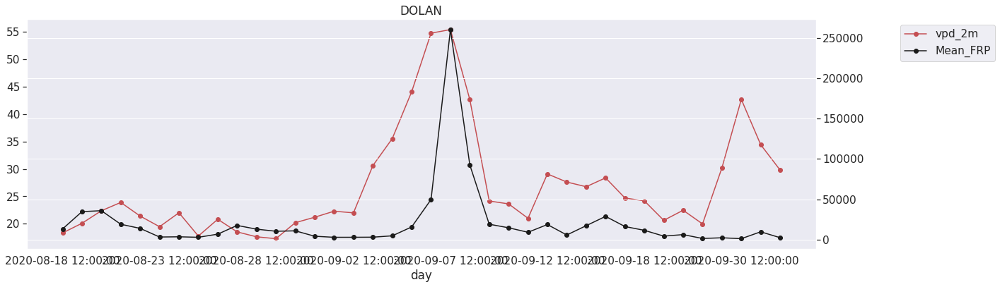

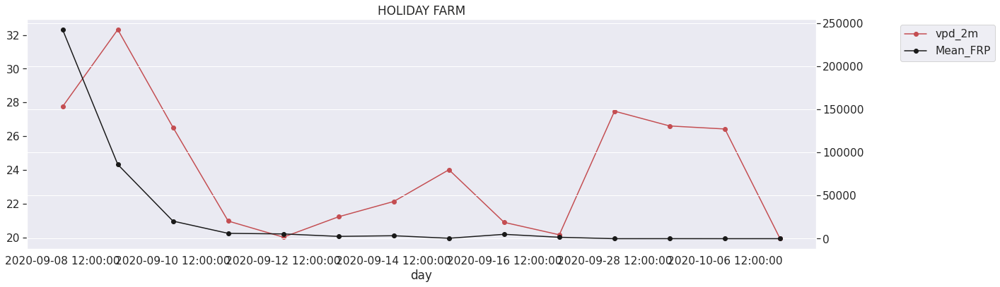

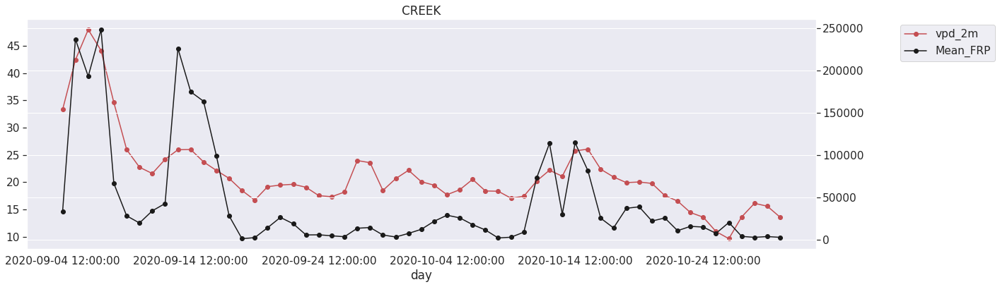

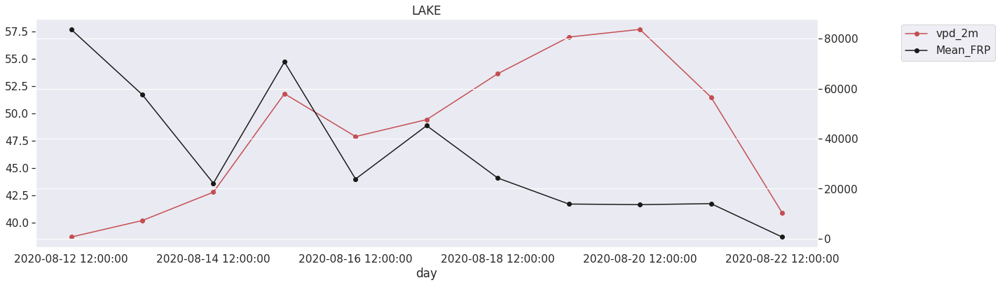

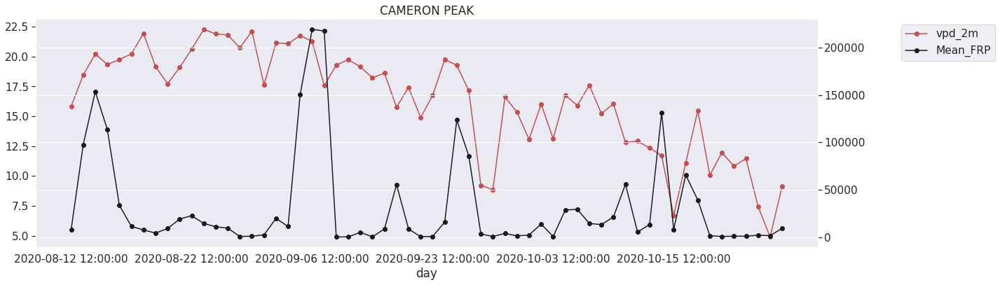

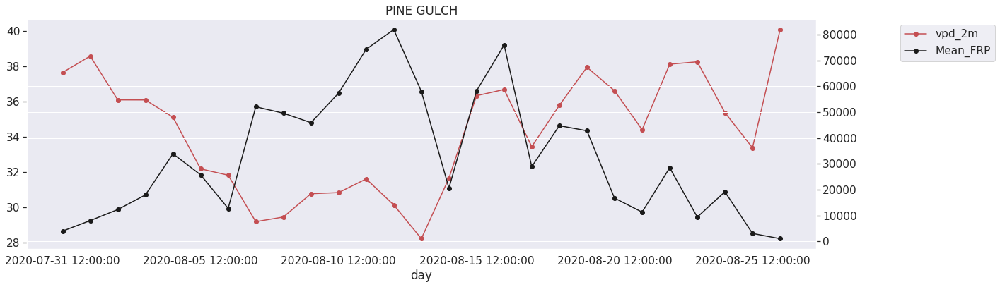

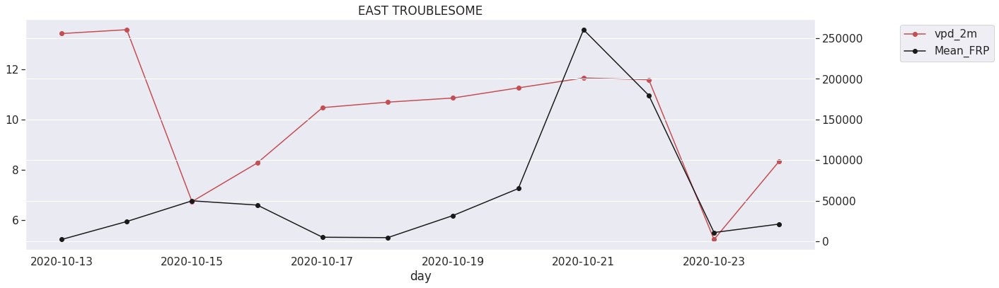

In [10]:
for ii in range(len(incidents)):
    features_plot = features[features['name']==incidents[ii]]
    #plot the predictions
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['vpd_2m'],
                                figsize=(20,6),style='ro-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                                figsize=(20,6),style='ko-',ax=ax )

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(incidents[ii])
    plt.show()

## Correlation plot for all fires, all variables


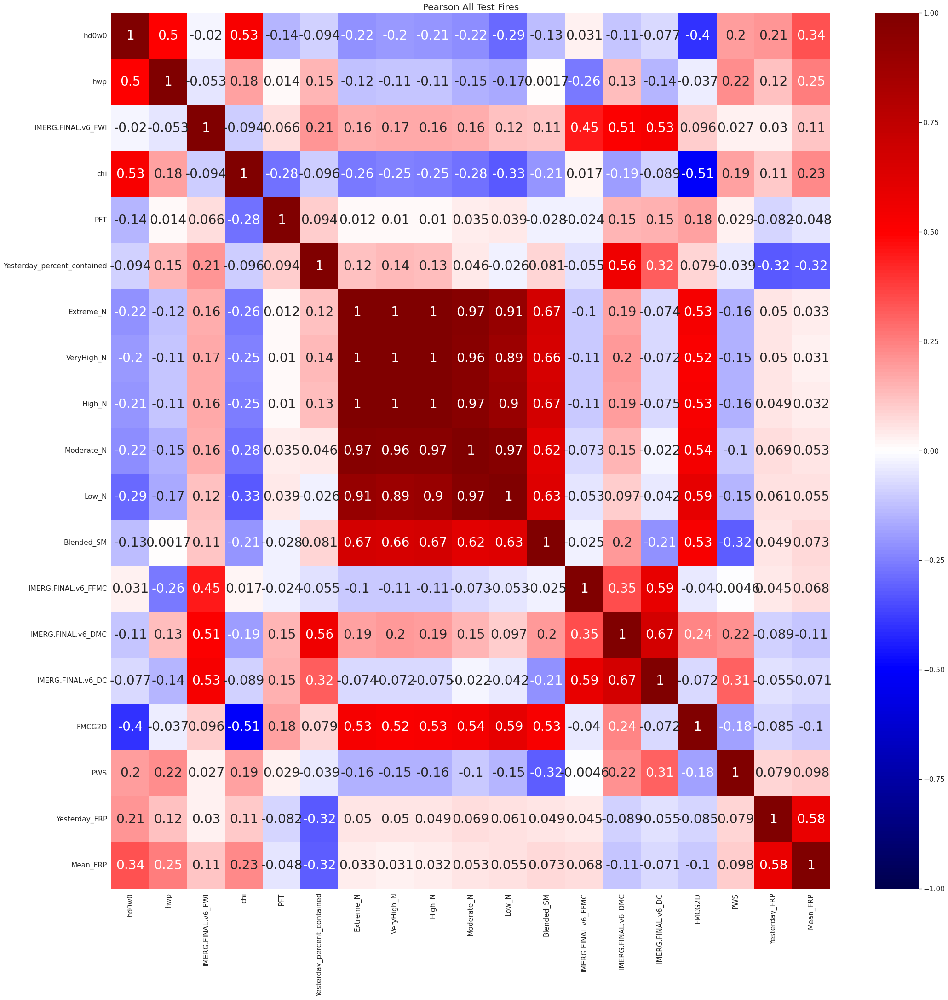

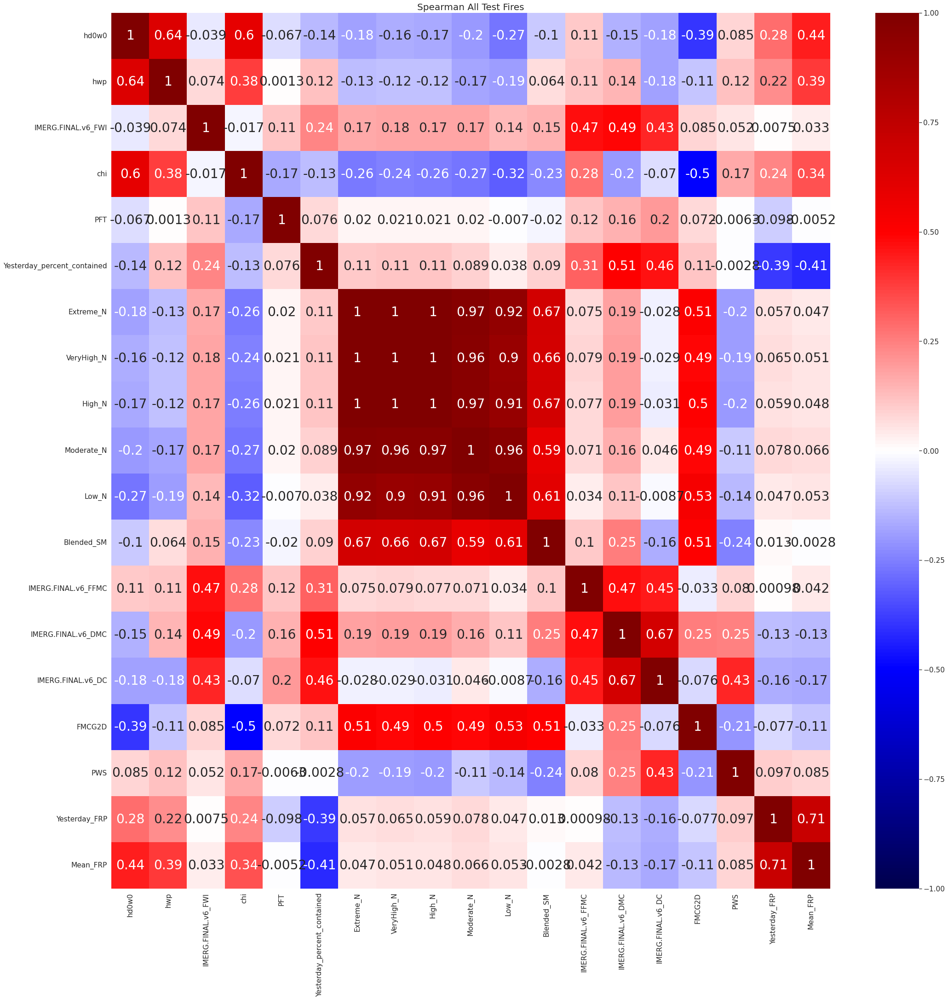

In [26]:
varis = ['hd0w0','hwp','IMERG.FINAL.v6_FWI', #weather
         'chi', 'PFT',#stability
         'Yesterday_percent_contained', #firefighting
         'Extreme_N','VeryHigh_N','High_N','Moderate_N','Low_N', #fuel loading
         'Blended_SM','IMERG.FINAL.v6_FFMC','IMERG.FINAL.v6_DMC','IMERG.FINAL.v6_DC','FMCG2D', #fuel moisture
         'PWS',
         'Yesterday_FRP','Mean_FRP']
plot_correlations(features[varis], 'Pearson All Test Fires','pearson')
plot_correlations(features[varis], 'Spearman All Test Fires','spearman')

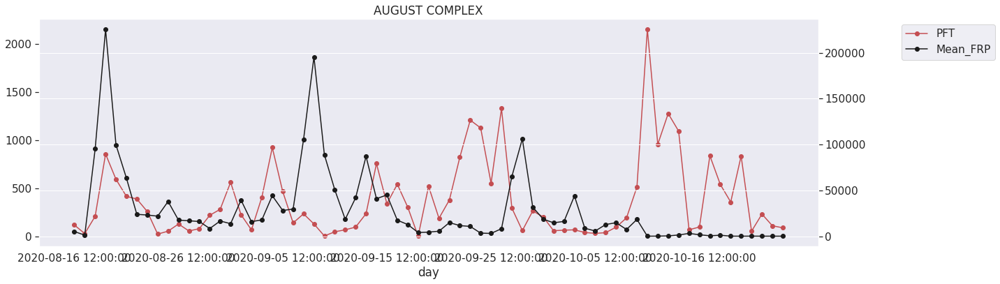

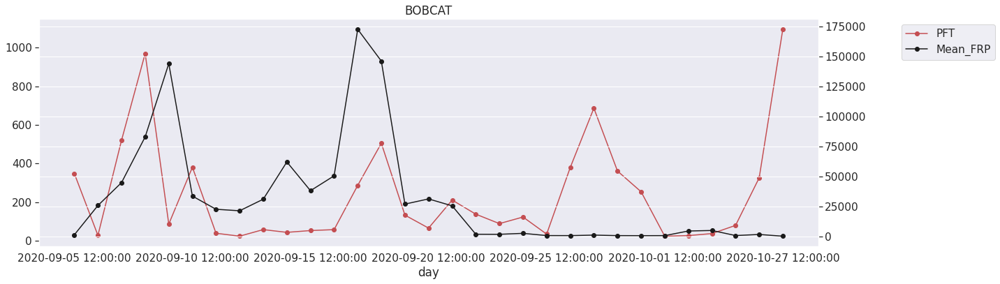

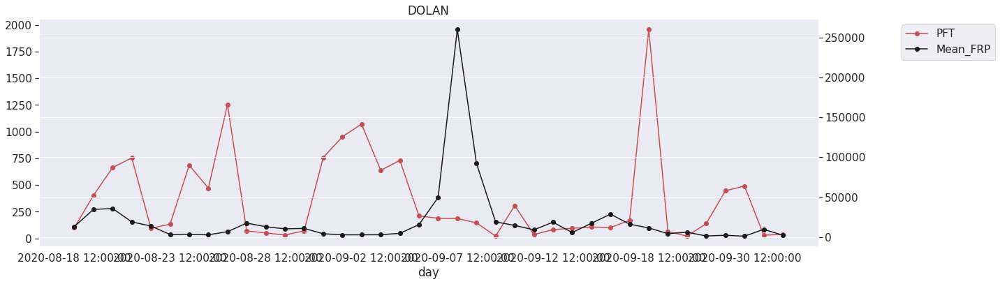

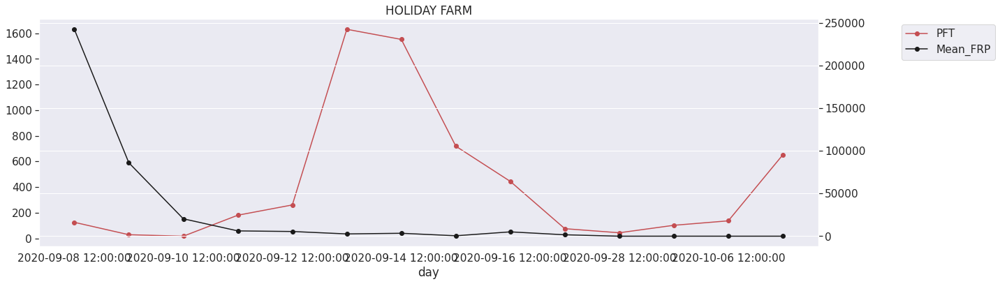

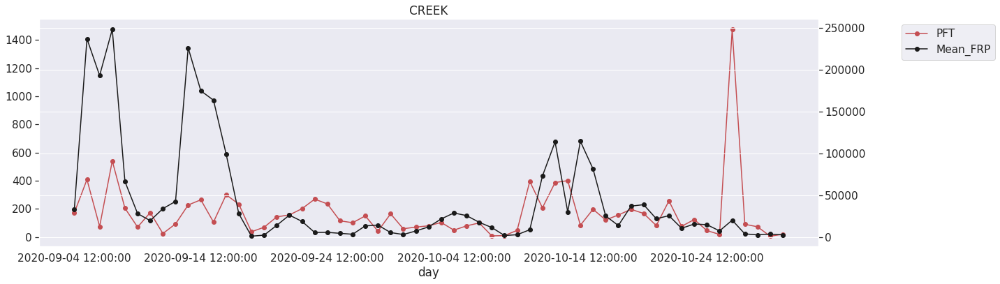

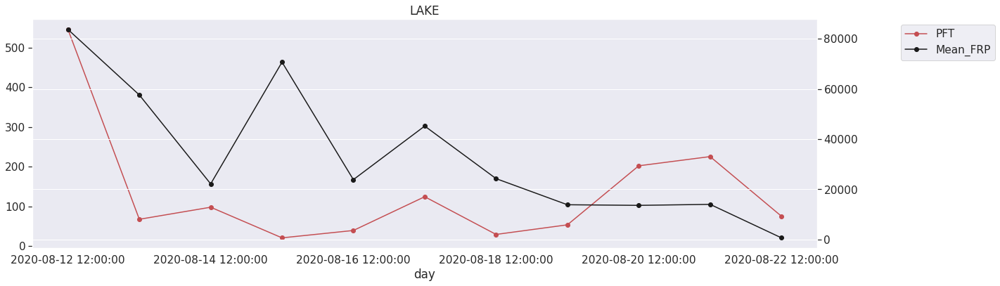

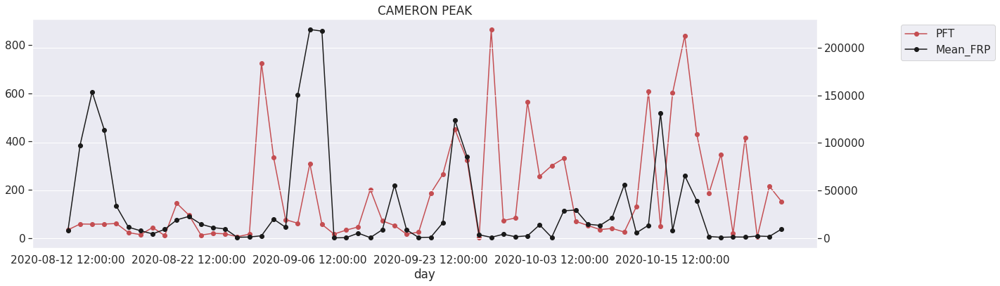

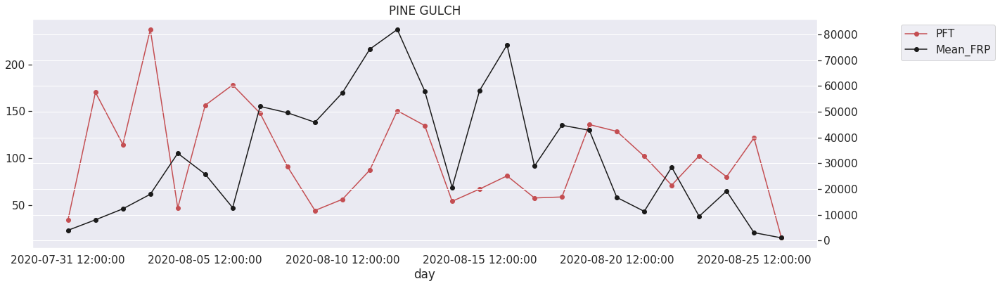

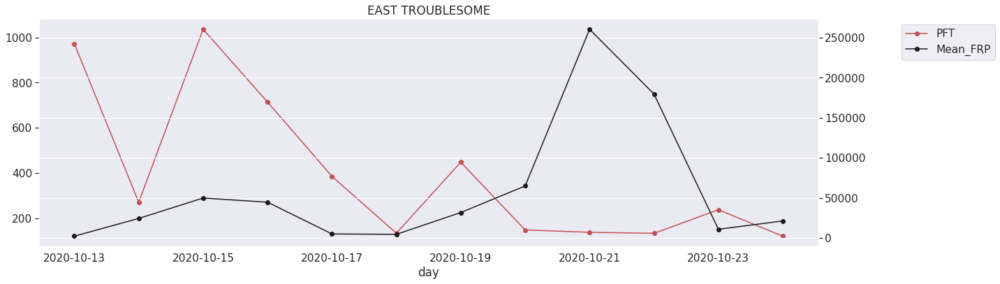

In [29]:
for ii in range(len(incidents)):
    features_plot = features[features['name']==incidents[ii]]
    #plot the predictions
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['PFT'],
                                figsize=(20,6),style='ro-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                                figsize=(20,6),style='ko-',ax=ax )

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(incidents[ii])
    plt.show()

## CHI for all fires

In [53]:
#persistence FRP with HDW, HWP, FWI and CHI
features['FRP1_rel_hd0w0'] = features['Yesterday_FRP']*features['hd0w0']/features['Yesterday_hd0w0']
features['FRP1_rel_hwp'] = features['Yesterday_FRP']*features['hwp']/features['Yesterday_hwp']
features['FRP1_rel_fwi'] = features['Yesterday_FRP']*features['IMERG.FINAL.v6_FWI']/features['Yesterday_fwi']
features['FRP1_rel_chi'] = features['Yesterday_FRP']*features['chi']/features['Yesterday_chi']

features['chi_hd0w0'] = features['chi']*features['hd0w0']/10
features['Yesterday_chi_hd0w0']

Index(['day', 'name', 'hd0w0', 'hd1w0', 'hwp', 'Yesterday_hd0w0',
       'Yesterday_hwp', 'Yesterday_percent_contained', 'Low_N', 'Moderate_N',
       'High_N', 'VeryHigh_N', 'Extreme_N', 'IMERG.FINAL.v6_FFMC',
       'IMERG.FINAL.v6_DMC', 'IMERG.FINAL.v6_DC', 'IMERG.FINAL.v6_FWI',
       'Yesterday_fwi', 'Blended_SM', 'PWS', 'Mean_FRP', 'Yesterday_FRP',
       'FMCG2D', 'FMCGLH2D', 'Yesterday_FMCG2D', 'Yesterday_FMCGLH2D',
       'temp_850', 'temp_700', 'dewpt_850', 'ca', 'cb', 'chi', 'Yesterday_chi',
       'FRP1_rel_hd0w0', 'FRP1_rel_hwp', 'FRP1_rel_fwi', 'FRP1_rel_chi',
       'chi_hd0w0'],
      dtype='object')


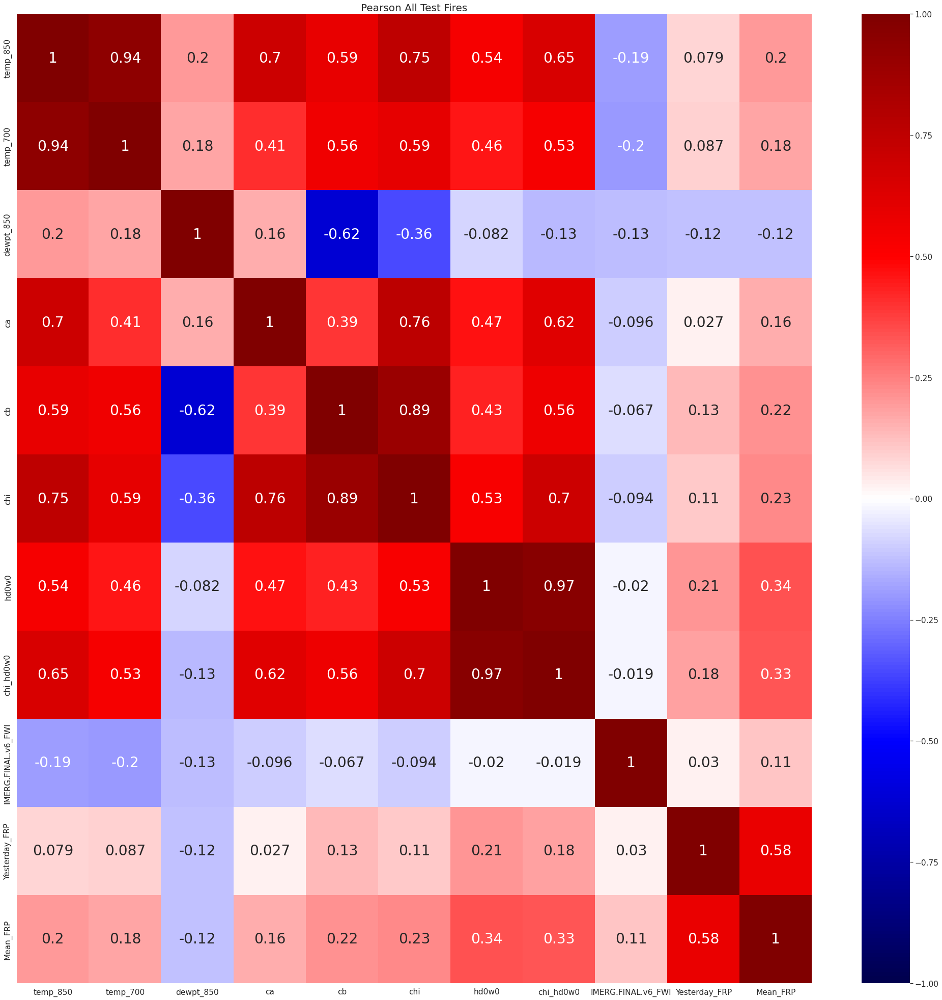

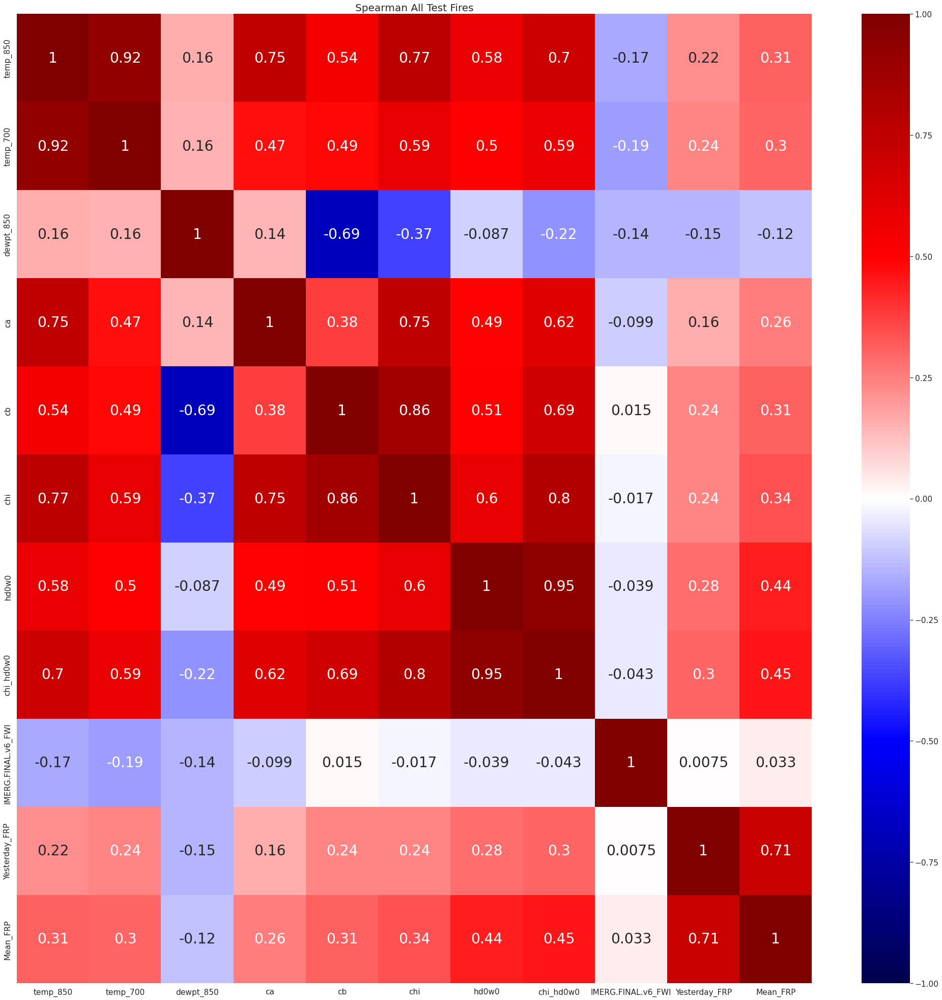

In [55]:
print(features.columns)
varis = ['temp_850','temp_700','dewpt_850','ca','cb','chi','hd0w0','chi_hd0w0','IMERG.FINAL.v6_FWI','Yesterday_FRP','Mean_FRP']
plot_correlations(features[varis], 'Pearson All Test Fires','pearson')
plot_correlations(features[varis], 'Spearman All Test Fires','spearman')

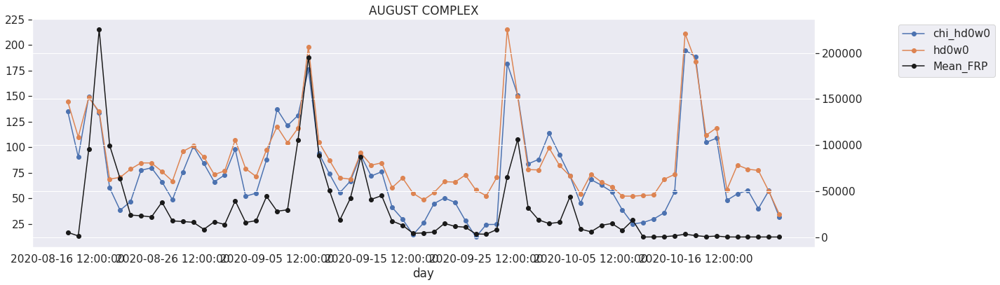

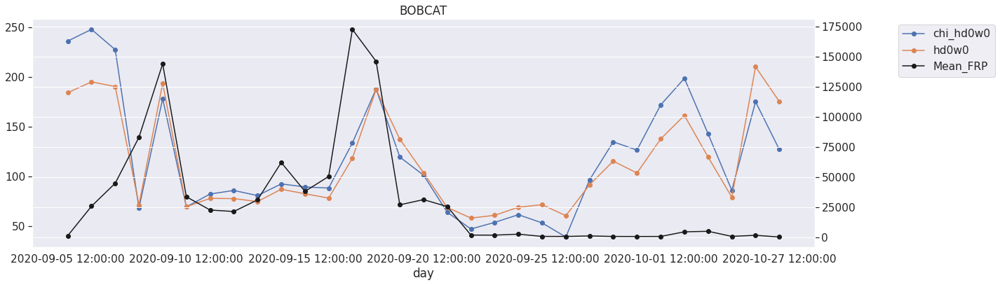

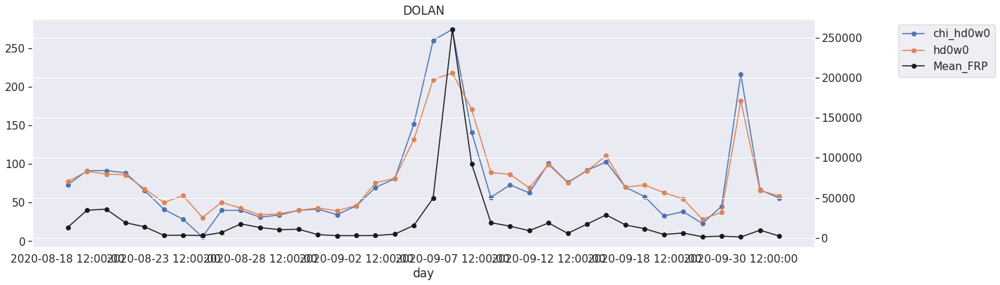

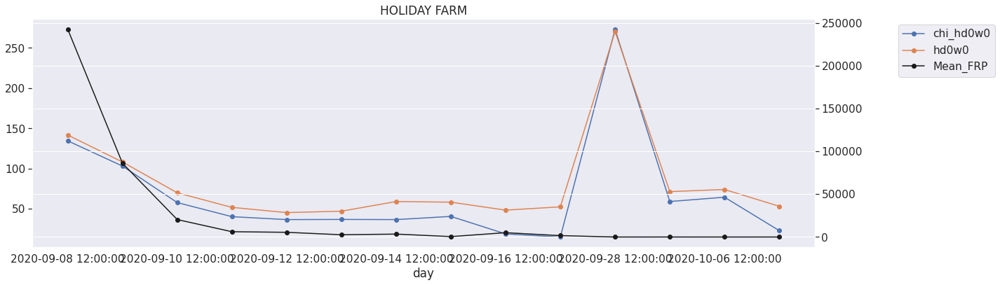

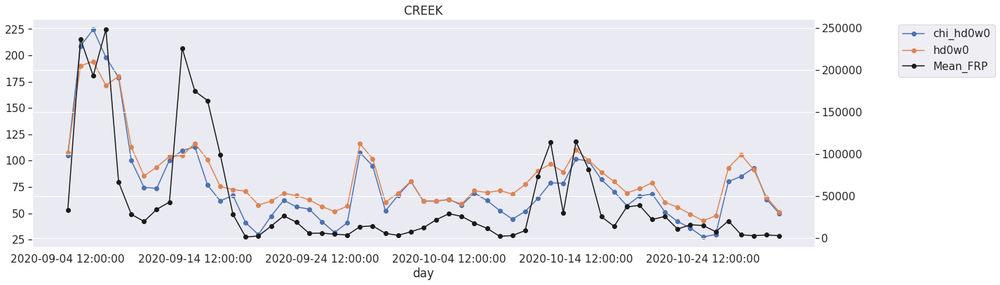

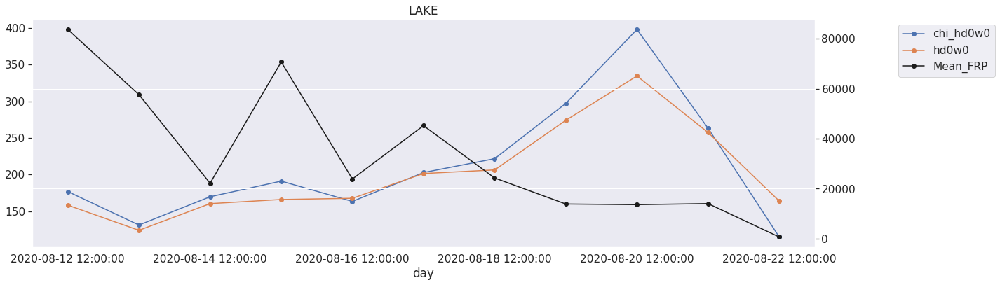

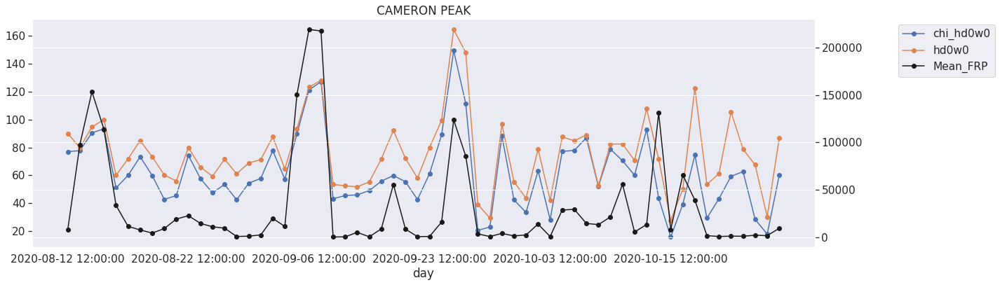

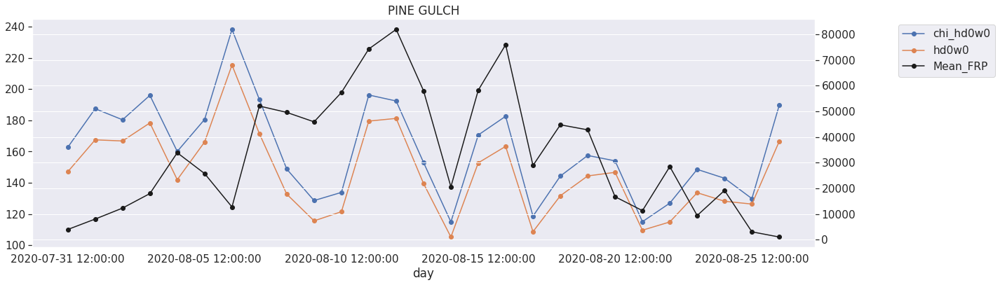

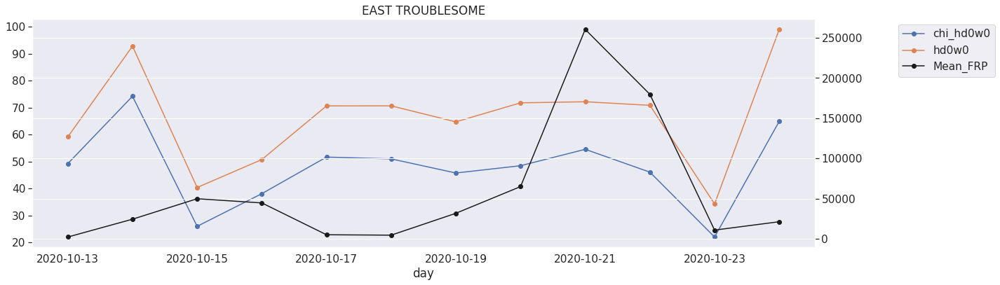

In [54]:
for ii in range(len(incidents)):
    features_plot = features[features['name']==incidents[ii]]
    #plot the predictions
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['chi_hd0w0', 'hd0w0'],
                                figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                                figsize=(20,6),style='ko-',ax=ax )

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(incidents[ii])
    plt.show()

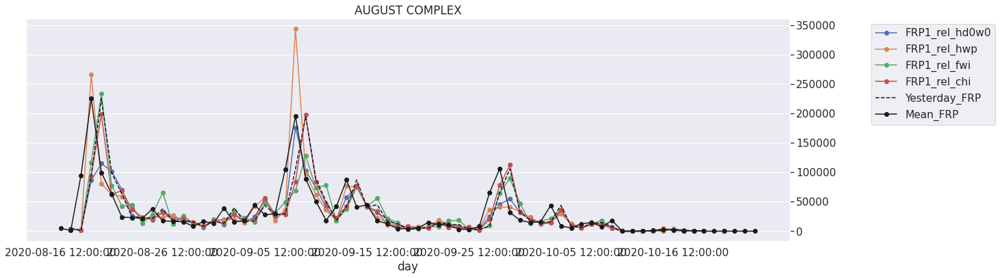

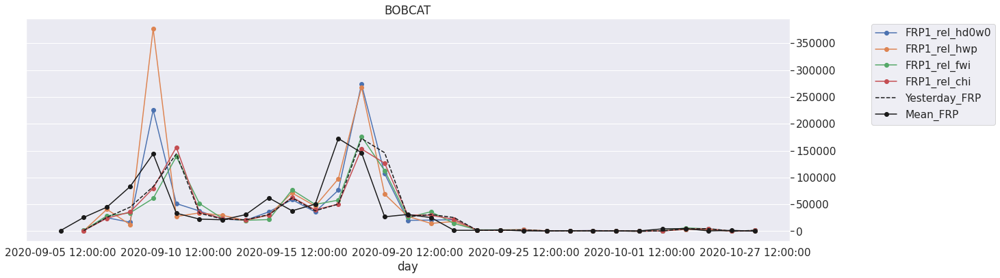

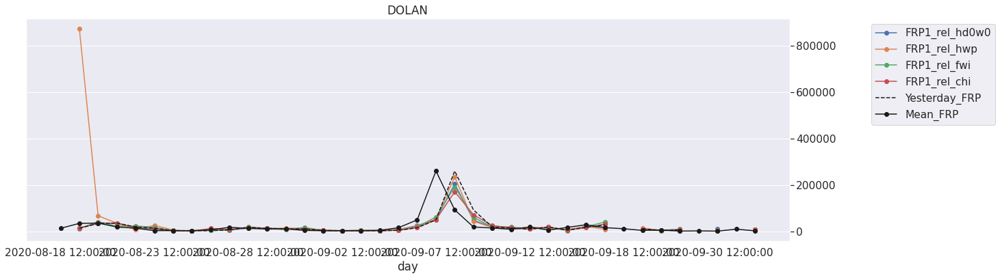

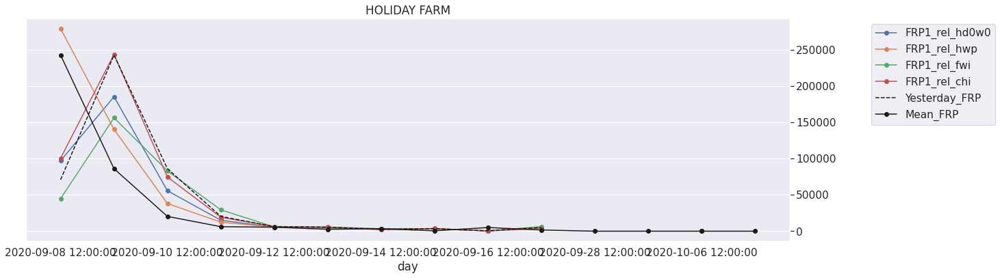

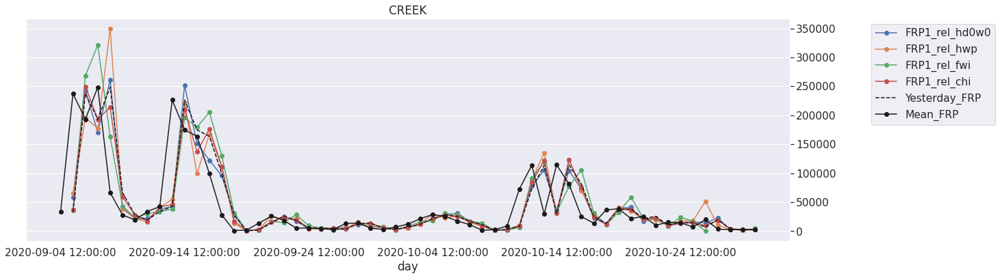

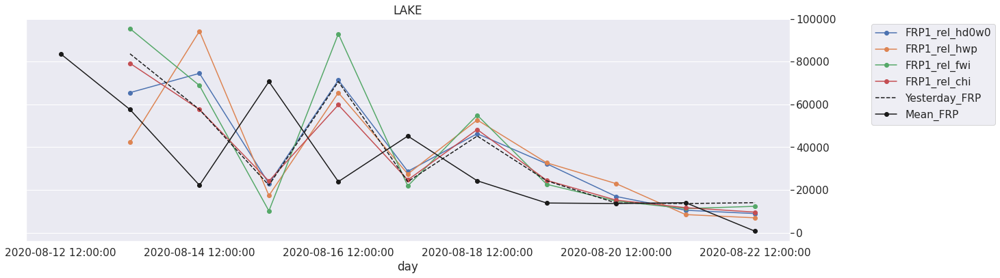

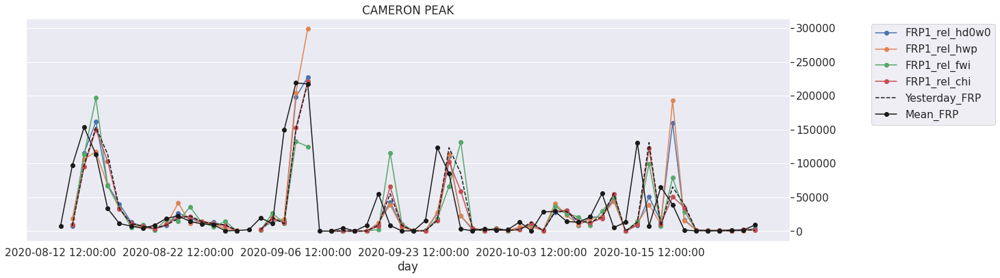

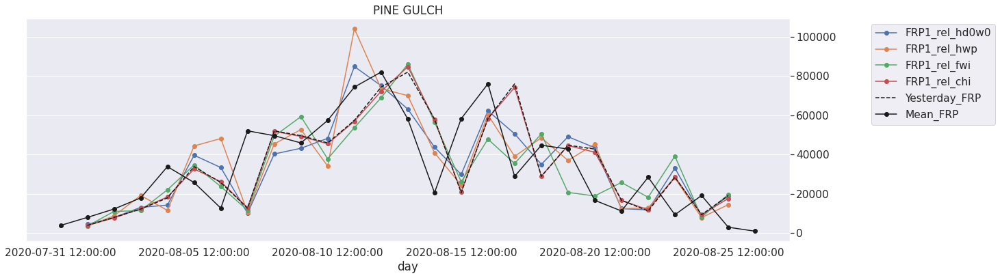

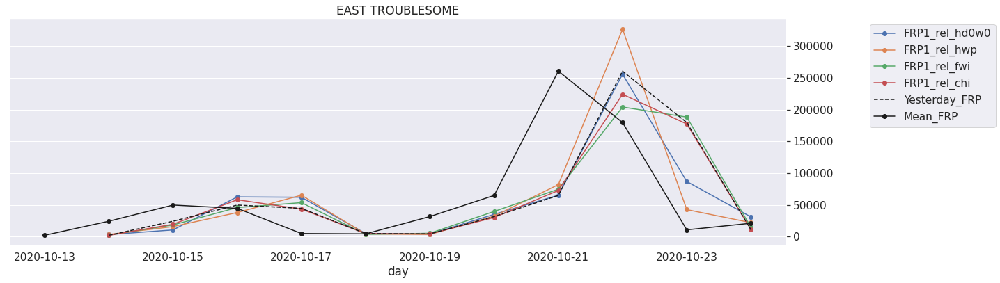

In [42]:
for ii in range(len(incidents)):
    features_plot = features[features['name']==incidents[ii]]
    #plot the predictions
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['FRP1_rel_hd0w0', 'FRP1_rel_hwp','FRP1_rel_fwi','FRP1_rel_chi'],secondary_y=True,
                                figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                                figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                                figsize=(20,6),style='ko-',ax=ax )

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(incidents[ii])
    plt.show()

In [43]:
pd.set_option('mode.use_inf_as_na', True)
features_score = features.dropna(axis=0,how='any')
features_scaled = ['Mean_FRP','Yesterday_FRP',
                'FRP1_rel_hd0w0',
                'FRP1_rel_hwp',
                'FRP1_rel_fwi',
                'FRP1_rel_chi']


print('R2 scores:')
print('Scaled method:')
for ii in range(len(features_scaled)):
    print(features_scaled[ii] +' score is: ' + str(r2_score(features_score['Mean_FRP'],features_score[features_scaled[ii]])))

print()
print('RMSE:')
print('Scaled method:')
for ii in range(len(features_scaled)):
    print(features_scaled[ii] +' score is: ' + str(RMSE(features_score['Mean_FRP'],features_score[features_scaled[ii]])))
    
print()
print('Mean Absolute Error:')
print('Scaled method:')
for ii in range(len(features_scaled)):
    print(features_scaled[ii] +' score is: ' + str(MAD(features_score['Mean_FRP'],features_score[features_scaled[ii]])))
    
print()
print('Mean Absolute Error Relative to Persistence:')
print('Scaled method:')
for ii in range(len(features_scaled)):
    print(features_scaled[ii] +' score is: ' + str(mdrae(features_score['Mean_FRP'], 
                                                         features_score[features_scaled[ii]], 
                                                         features_score['Yesterday_FRP'])) )
print()
print('AUC:')
print('Scaled method: ')
for ii in range(len(features_scaled)):
    thresh, acc = REC(features_score[features_scaled[ii]], features_score['Mean_FRP'])
    print(features_scaled[ii] +' score is: ' + str(AUC(acc) ))

R2 scores:
Scaled method:
Mean_FRP score is: 1.0
Yesterday_FRP score is: 0.20790286854628282
FRP1_rel_hd0w0 score is: 0.34881815927220794
FRP1_rel_hwp score is: -0.7627695521502809
FRP1_rel_fwi score is: 0.23347159623974412
FRP1_rel_chi score is: 0.29567785148313896

RMSE:
Scaled method:
Mean_FRP score is: 0.0
Yesterday_FRP score is: 44074.250886880436
FRP1_rel_hd0w0 score is: 39961.96726891698
FRP1_rel_hwp score is: 65749.65668308924
FRP1_rel_fwi score is: 43357.06199140182
FRP1_rel_chi score is: 41560.56012786332

Mean Absolute Error:
Scaled method:
Mean_FRP score is: 0.0
Yesterday_FRP score is: 23337.307838963934
FRP1_rel_hd0w0 score is: 20737.774714342737
FRP1_rel_hwp score is: 23932.867294733576
FRP1_rel_fwi score is: 23879.292427906625
FRP1_rel_chi score is: 21978.879620150317

Mean Absolute Error Relative to Persistence:
Scaled method:
Mean_FRP score is: 0.0
Yesterday_FRP score is: 1.0
FRP1_rel_hd0w0 score is: 0.9707842409396309
FRP1_rel_hwp score is: 0.9718626453025418
FRP1_rel

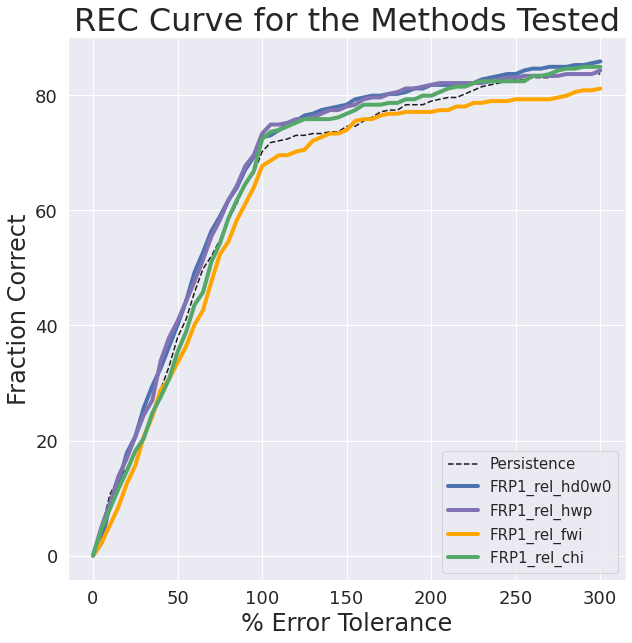

In [45]:

#REC CURVES
thresholds_persistence, accuracy_persistence = REC(features['Yesterday_FRP'].values, features['Mean_FRP'].values)
thresh_hdw, accuracies_hdw = REC(features['FRP1_rel_hd0w0'].values, features['Mean_FRP'].values)
thresh_hwp, accuracies_hwp = REC(features['FRP1_rel_hwp'].values, features['Mean_FRP'].values)
thresh_fwi, accuracies_fwi = REC(features['FRP1_rel_fwi'].values, features['Mean_FRP'].values)
thresh_chi, accuracies_chi = REC(features['FRP1_rel_chi'].values, features['Mean_FRP'].values)

plt.figure(figsize=(10,10))
plt.plot(thresholds_persistence, accuracy_persistence,'k--')
plt.plot(thresh_hdw, accuracies_hdw,'b-',linewidth=4)
plt.plot(thresh_hwp, accuracies_hwp,'m-',linewidth=4)
plt.plot(thresh_fwi, accuracies_fwi,linestyle='-',color='orange',linewidth=4)
plt.plot(thresh_chi, accuracies_chi,'g-',linewidth=4)

plt.legend(['Persistence', 'FRP1_rel_hd0w0','FRP1_rel_hwp','FRP1_rel_fwi','FRP1_rel_chi '],fontsize=15)
plt.title('REC Curve for the Methods Tested', fontsize=32)
plt.ylabel('Fraction Correct', fontsize=24)
plt.xlabel('% Error Tolerance', fontsize=24)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(True)
plt.show()

# Old Code from analyzing the CA fires only

## Prepare the Data

In [ ]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                igbp_all[['Dominant Fuel Category']].reset_index(drop=True),
                igbp_simplified[['Dominant Simple Fuel Category','forest','savanna','grassland']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                fireline_all[['total_length','yesterday_total_length','morning_length','afternoon_length','time_morning','time_afternoon']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)

esi_cat = pd.cut(df_hrrr['ESI'].values, bins=[-5,0,5],labels=['Negative ESI','Positive ESI'])
df_hrrr['ESI Category'] = esi_cat

pws_cat = pd.cut(df_hrrr['PWS'].values, bins=[0,1,1.5,2],labels=['low hazard','medium hazard','high hazard'])
df_hrrr['PWS Category'] = pws_cat

containment_cat = pd.cut(df_hrrr['percent_contained'].values, bins=[0,70,100],labels=['mostly uncontained','mostly contained'])
df_hrrr['Containment Category'] = containment_cat

df_hrrr['hd1'] = df_hrrr['hd1w0']/df_hrrr['wind_speed']
df_hrrr['hd2'] = df_hrrr['hd2w0']/df_hrrr['wind_speed']

df_hrrr['dVPD'] = df_hrrr['vpd_2m']-df_hrrr['hd1']

In [ ]:
# derived indices (current starting 1/16/2023)

#not includng persistence
df_hrrr['cont_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hd1w0']
df_hrrr['cont_hwp'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hwp']

df_hrrr['cont1_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd1w0']
df_hrrr['cont1_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hwp']


#including persistence
df_hrrr['FRP1_rel_hd1w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])
df_hrrr['FRP1_rel_hwp'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])

df_hrrr['cont1_FRP1_rel_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])
df_hrrr['cont1_FRP1_rel_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])


df_hrrr = df_hrrr[df_hrrr['cont1_FRP1_rel_hwp']<800000] #gets rid of the outlier

In [ ]:
#prepares the Merra data
df_list_merra = [days_all[['day']].reset_index(drop=True),
                merra_all[['temp','vpd','wind','hd0w0','hd1w0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                igbp_all[['Dominant Fuel Category']].reset_index(drop=True),
                igbp_simplified[['Dominant Simple Fuel Category','forest','savanna','grassland']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                fireline_all[['total_length','yesterday_total_length','morning_length','afternoon_length','time_morning','time_afternoon']].reset_index(drop=True),
                 rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_merra = pd.concat(df_list_merra,axis=1)

esi_cat = pd.cut(df_merra['ESI'].values, bins=[-5,0,5],labels=['Negative ESI','Positive ESI'])
df_merra['ESI Category'] = esi_cat

pws_cat = pd.cut(df_merra['PWS'].values, bins=[0,1,1.5,2],labels=['low hazard','medium hazard','high hazard'])
df_merra['PWS Category'] = pws_cat

containment_cat = pd.cut(df_merra['percent_contained'].values, bins=[0,70,100],labels=['mostly uncontained','mostly contained'])
df_merra['Containment Category'] = containment_cat

df_merra['hd1'] = df_merra['hd1w0']/df_merra['wind']
df_merra['hd2'] = df_merra['hd2w0']/df_merra['wind']
df_merra['dVPD'] = df_merra['vpd']-df_merra['hd1']

In [ ]:
#derived indices (stopped using 1/16/23)
df_hrrr['hd1w0_predicted_FRP'] = 2000*df_hrrr['hd1w0']-280000
df_merra['hd1w0_predicted_FRP'] = df_merra['hd1w0']*950-150000

#methods to use containment to modulate HDW
df_hrrr['linear_contained_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hd1w0']
df_merra['linear_contained_hd1w0'] = (1-(df_merra['percent_contained']/100))*df_merra['hd1w0']

df_hrrr['log_contained_hd1w0'] = (np.log10(95-df_hrrr['percent_contained'])/2)*df_hrrr['hd1w0']
df_merra['log_contained_hd1w0'] = (np.log10(95-df_merra['percent_contained'])/2)*df_merra['hd1w0']

e = math.e
df_hrrr['exp_contained_hd1w0'] = (e**(-0.04*df_hrrr['percent_contained']))*df_hrrr['hd1w0']
df_merra['exp_contained_hd1w0'] = (e**(-0.04*df_merra['percent_contained']))*df_merra['hd1w0']

df_hrrr['total_fuel'] = df_hrrr['fuel_loadings']*df_hrrr['fire area (acre)']
df_merra['total_fuel'] = df_merra['fuel_loadings']*df_merra['fire area (acre)']

df_hrrr['total_fuel_log'] = np.log10(df_hrrr['total_fuel'])
df_merra['total_fuel_log'] =  np.log10(df_merra['total_fuel'])
df_hrrr['total_fuel_log'].iloc[df_hrrr['total_fuel_log']<0] = 0
df_merra['total_fuel_log'].iloc[df_merra['total_fuel_log']<0] = 0

df_hrrr['fuel_scaled_hd1w0'] = df_hrrr['fuel_loadings']*df_hrrr['hd1w0']
df_merra['fuel_scaled_hd1w0'] = df_merra['fuel_loadings']*df_merra['hd1w0']

df_hrrr['persistence_scaled_hd1w0'] = df_hrrr['Yesterday_FRP']*df_hrrr['hd1w0']
df_merra['persistence_scaled_hd1w0'] = df_merra['Yesterday_FRP']*df_merra['hd1w0']

df_hrrr['persistence_relative_hd1w0'] = df_hrrr['Yesterday_FRP']*df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0']
df_merra['persistence_relative_hd1w0'] = df_merra['Yesterday_FRP']*df_merra['hd1w0']/df_merra['Yesterday_HD1W0']

df_hrrr['persistence_length_relative_hd1w0'] = df_hrrr['yesterday_total_length']*df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0']
df_merra['persistence_length_relative_hd1w0'] = df_merra['yesterday_total_length']*df_merra['hd1w0']/df_merra['Yesterday_HD1W0']

df_hrrr['contained_persistence_relative_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['Yesterday_FRP']*df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0']
df_merra['contained_persistence_relative_hd1w0'] = (1-(df_merra['percent_contained']/100))*df_merra['Yesterday_FRP']*df_merra['hd1w0']/df_merra['Yesterday_HD1W0']

df_hrrr['contained_persistence_scaled_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['Yesterday_FRP']*df_hrrr['hd1w0']
df_merra['contained_persistence_scaled_hd1w0'] = (1-(df_merra['percent_contained']/100))*df_merra['Yesterday_FRP']*df_merra['hd1w0']

df_hrrr['contained_persistence'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['Yesterday_FRP']
df_merra['contained_persistence'] = (1-(df_merra['percent_contained']/100))*df_merra['Yesterday_FRP']

df_hrrr['contained_fuel_scaled_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['fuel_scaled_hd1w0']
df_merra['contained_fuel_scaled_hd1w0'] = (1-(df_merra['percent_contained']/100))*df_merra['fuel_scaled_hd1w0']

# filters into outliers and main set
df_hrrr['point_type'] = np.zeros(len(df_hrrr))
df_hrrr['point_type'].iloc[np.where(df_hrrr['Mean_FRP']<df_hrrr['hd1w0_predicted_FRP'])] = 'outliers'
df_hrrr['point_type'].iloc[np.where(df_hrrr['Mean_FRP']>=df_hrrr['hd1w0_predicted_FRP'])] = 'main set'

df_merra['point_type'] = np.zeros(len(df_merra))
df_merra['point_type'].iloc[np.where(df_merra['Mean_FRP']<df_merra['hd1w0_predicted_FRP'])] = 'outliers'
df_merra['point_type'].iloc[np.where(df_merra['Mean_FRP']>=df_merra['hd1w0_predicted_FRP'])] = 'main set'

df_hrrr['hd1w0_to_FRP'] = df_hrrr['hd1w0']/df_hrrr['Mean_FRP']
df_merra['hd1w0_to_FRP'] =df_merra['hd1w0']/df_merra['Mean_FRP']

df_hrrr['FRP_to_hd1w0'] = df_hrrr['Mean_FRP']/df_hrrr['hd1w0']
df_merra['FRP_to_hd1w0'] =df_merra['Mean_FRP']/df_merra['hd1w0']


## Correlation Plots

In [ ]:
#for the October 31st Research Update, FRP for persistence
plot_correlations(df_merra[['hd1w0','fuel_loadings','percent_contained','Yesterday FRP',
                            'contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'Mean_FRP']], 
                          'MERRA2 Met Pearson','pearson')
plot_correlations(df_hrrr[['hd1w0','fuel_loadings','percent_contained','Yesterday FRP',
                            'contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

plot_correlations(df_merra[['hd1w0','fuel_loadings','percent_contained','Yesterday FRP',
                            'contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'Mean_FRP']], 
                          'MERRA2 Met Kendall','kendall')
plot_correlations(df_hrrr[['hd1w0','fuel_loadings','percent_contained','Yesterday FRP',
                            'contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'Mean_FRP']], 
                  'HRRR Met Kendall','kendall')

In [ ]:
#for the October 31st Research Update, fireline length for persistence
plot_correlations(df_merra[['hd1w0','fuel_loadings','percent_contained','afternoon_length','morning_length',
                            'yesterday_afternoon_fireline','yesterday_morning_fireline','Yesterday FRP',
                            'Mean_FRP']], 
                          'MERRA2 Met Pearson','pearson')
plot_correlations(df_hrrr[['hd1w0','fuel_loadings','percent_contained','afternoon_length','morning_length',
                            'yesterday_afternoon_fireline','yesterday_morning_fireline','Yesterday FRP',
                           'Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

In [ ]:
#for the November 7th Research Update, fireline length for persistence
plot_correlations(df_merra[['hd1w0','fuel_loadings','percent_contained',
                            'total_length','morning_length','afternoon_length','yesterday_total_length','persistence_length_relative_hd1w0',
                            'Yesterday_FRP',
                            'Mean_FRP']], 
                          'MERRA2 Met Pearson','pearson')
plot_correlations(df_hrrr[['hd1w0','fuel_loadings','percent_contained',
                            'total_length','morning_length','afternoon_length','yesterday_total_length','persistence_length_relative_hd1w0',
                           'Yesterday_FRP',
                            'Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

In [ ]:
# for November 7th update, comparing some nonlinear methods for containment
plot_correlations(df_merra[['hd1w0','percent_contained','linear_contained_hd1w0','log_contained_hd1w0',
                            'exp_contained_hd1w0','Yesterday FRP','Mean_FRP']], 
                          'MERRA2 Met Pearson','pearson')
plot_correlations(df_hrrr[['hd1w0','percent_contained','linear_contained_hd1w0','log_contained_hd1w0',
                            'exp_contained_hd1w0','Yesterday FRP','Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

In [ ]:
# same as above, but by fire
fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['AUGUST COMPLEX']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]
    df_plot_merra = df_merra[df_merra['name'].str.contains(fire_incidents[ii])]

    plot_correlations(df_plot_merra[['hd1w0','percent_contained','linear_contained_hd1w0','log_contained_hd1w0',
                            'exp_contained_hd1w0','Yesterday FRP','Mean_FRP']], 
                          fire_incidents[ii]+' MERRA2 Pearson','pearson')
    plot_correlations(df_plot_hrrr[['hd1w0','percent_contained','linear_contained_hd1w0','log_contained_hd1w0',
                            'exp_contained_hd1w0','Yesterday FRP','Mean_FRP']], 
                  fire_incidents[ii]+' HRRR Pearson','pearson')
    

In [ ]:
### for Nov 14th research update, added scaled persistence HD1W0(t)/HD1W0(t-1)
plot_correlations(df_merra[['hd1w0','fuel_loadings','percent_contained','Yesterday_percent_contained','Yesterday_FRP',
                            'linear_contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_relative_hd1w0',
                            'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'hd1w0_to_FRP','FRP_to_hd1w0','Mean_FRP']], 
                          'MERRA2 Met Pearson','pearson')
plot_correlations(df_hrrr[['hd1w0','fuel_loadings','percent_contained','Yesterday_percent_contained','Yesterday_FRP',
                            'linear_contained_hd1w0','fuel_scaled_hd1w0','contained_fuel_scaled_hd1w0',
                            'contained_persistence', 'persistence_relative_hd1w0',
                           'persistence_scaled_hd1w0','contained_persistence_scaled_hd1w0',
                            'hd1w0_to_FRP','FRP_to_hd1w0','Mean_FRP']], 
                  'HRRR Met Pearson','pearson')


In [ ]:
# for the Jan 17th, 2023 research update
#only using HRRR for simplicity

#raw variables
plot_correlations(df_hrrr[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','hd2w0','hd3w0','hd4w0','hd5w0', 'hwp',
                           'fuel_loadings','personnel','percent_contained','Yesterday_percent_contained',
                           'Yesterday_FRP',
                            'Mean_FRP']], 
                  'HRRR Met Pearson','pearson')



In [ ]:
# for the Jan 17th, 2023 research update
#only using HRRR for simplicity

#derived variables
plot_correlations(df_hrrr[['cont_hd1w0','cont1_hd1w0','FRP1_rel_hd1w0','cont1_FRP1_rel_hd1w0',
                           'cont_hwp','cont1_hwp','FRP1_rel_hwp','cont1_FRP1_rel_hwp',
                            'Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

## Line Plots

In [ ]:
fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['AUGUST COMPLEX']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]
    df_plot_merra = df_merra[df_merra['name'].str.contains(fire_incidents[ii])]

    """plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR HDW','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['percent_contained'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['% contained','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['linear_contained_hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['Linear HRRR HDW','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['log_contained_hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['Log HRRR HDW','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['exp_contained_hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['Exponential HRRR HDW','FRP'], 1, 14)
    
    plot_twoline(df_plot_merra['day'], np.stack([df_plot_merra['hd1w0'], df_plot_merra['Mean_FRP']]), fire_incidents[ii]+' MERRA',\
             [], ['MERRA HDW','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], np.stack([df_plot_merra['percent_contained'], df_plot_merra['Mean_FRP']]), fire_incidents[ii]+' MERRA',\
             [], ['% Contained','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], np.stack([df_plot_merra['linear_contained_hd1w0'], df_plot_merra['Mean_FRP']]), fire_incidents[ii]+' MERRA',\
             [], ['Linear MERRA HDW','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], np.stack([df_plot_merra['log_contained_hd1w0'], df_plot_merra['Mean_FRP']]), fire_incidents[ii]+' MERRA',\
             [], ['Log MERRA HDW','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], np.stack([df_plot_merra['exp_contained_hd1w0'], df_plot_merra['Mean_FRP']]), fire_incidents[ii]+' MERRA',\
             [], ['Exponential MERRA HDW','FRP'], 1, 14)
    
    
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['percent_contained'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR HDW','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['linear_contained_hd1w0']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR HDW','HRRR HDW*(1-%)'], 1, 14)"""

    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0_to_FRP'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR HDW/FRP','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['FRP_to_hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR FRP/HDW','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['HRRR HDW','FRP'], 1, 14)
    
    

In [ ]:
fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['AUGUST COMPLEX']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]
    df_plot_merra = df_merra[df_merra['name'].str.contains(fire_incidents[ii])]

    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['morning_length'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['morning (12Z) fireline length','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['afternoon_length'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['afternoon (0Z) fireline length','FRP'], 1, 24)
    
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['total_length'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['total fireline length','FRP'], 1, 24)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['yesterday_total_length'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['persistence total fireline length','FRP'], 1, 24)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['hd1w0','FRP'], 1, 24)
    plot_twoline(df_plot_hrrr['day'], np.stack([df_plot_hrrr['hd1w0']*df_plot_hrrr['total_length'], df_plot_hrrr['Mean_FRP']]), fire_incidents[ii]+' HRRR',\
             [], ['hd1w0*total fireline length','FRP'], 1, 24)
    
    
    

    

In [ ]:
#for November 7th update (HRRR MET)
fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['LAKE']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]
    df_plot_merra = df_merra[df_merra['name'].str.contains(fire_incidents[ii])]

    #print(df_plot_hrrr['day'].values)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['Yesterday_FRP'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['Yesterday FRP','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['HD1W0(t)','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['persistence_relative_hd1w0'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['FRP(t-1) *(HDW(t)/HDW(t-1))','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], 
                 np.stack([df_plot_merra['hd1w0'], df_plot_merra['Mean_FRP']]), 
                 fire_incidents[ii]+' MERRA', [], ['HD1W0(t)','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], 
                 np.stack([df_plot_merra['persistence_relative_hd1w0'], df_plot_merra['Mean_FRP']]), 
                 fire_incidents[ii]+' MERRA', [], ['FRP(t-1) *(HDW(t)/HDW(t-1))','FRP'], 1, 14)


In [ ]:
# for Jan 17th, 2023
df_hrrr[['cont_hd1w0','cont1_hd1w0','FRP1_rel_hd1w0','cont1_FRP1_rel_hd1w0',
                           'cont_hwp','cont1_hwp','FRP1_rel_hwp','cont1_FRP1_rel_hwp',
                            'Mean_FRP']], 

#for November 7th update (HRRR MET)
fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['LAKE']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]

    #print(df_plot_hrrr['day'].values)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['hwp'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['HWP','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['hd1w0'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['HD1W0','FRP'], 1, 14)
    
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['FRP1_rel_hd1w0'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['FRP(t-1)*HD1W0(t)/HD1W0(t-1)','FRP'], 1, 14)
    plot_twoline(df_plot_hrrr['day'], 
                 np.stack([df_plot_hrrr['FRP1_rel_hwp'], df_plot_hrrr['Mean_FRP']]), 
                 fire_incidents[ii]+' HRRR', [], ['FRP(t-1)*HWP(t)/HWP(t-1)','FRP'], 1, 14)
    """
    plot_twoline(df_plot_merra['day'], 
                 np.stack([df_plot_merra['hd1w0'], df_plot_merra['Mean_FRP']]), 
                 fire_incidents[ii]+' MERRA', [], ['HD1W0(t)','FRP'], 1, 14)
    plot_twoline(df_plot_merra['day'], 
                 np.stack([df_plot_merra['persistence_relative_hd1w0'], df_plot_merra['Mean_FRP']]), 
                 fire_incidents[ii]+' MERRA', [], ['FRP(t-1) *(HDW(t)/HDW(t-1))','FRP'], 1, 14)"""


## Scatter Plots

In [ ]:
scatter_plot(df_hrrr[df_hrrr['name'].str.contains('LAKE')],'percent_contained','Mean_FRP','fire area (ha)', 'name', 'fire area (ha)', (150,200),'Area Shaded')
scatter_plot(df_hrrr,'percent_contained','Mean_FRP','fire area (ha)', 'name', 'fire area (ha)', (150,200),'Area Shaded')


In [ ]:
sns.lmplot(data=df_hrrr, x="percent_contained", y="Mean_FRP", hue="name",col='name', height=5, aspect=1,order=1)
plt.show()

In [ ]:
def logifunc(x,A,x0,k,off):
    return A / (1 + np.exp(-k*(x-x0)))+off

fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents=['AUGUST COMPLEX']
for ii in range(len(fire_incidents)):
    df_plot_hrrr = df_hrrr[df_hrrr['name'].str.contains(fire_incidents[ii])]
    df_hrrr_fit = df_plot_hrrr[~np.isnan(df_plot_hrrr['percent_contained'].values)]
    popt, pcov = curve_fit(logifunc, df_hrrr_fit['percent_contained'].values, 
                       df_hrrr_fit['Mean_FRP'].values,
                      p0=[np.amax(df_hrrr_fit['Mean_FRP'].values)-np.amin(df_hrrr_fit['Mean_FRP'].values)
                          ,40,0.1,150000])
    print(popt)

    x = np.arange(0,100.5,0.5)
    plt.scatter(df_hrrr_fit['percent_contained'].values,df_hrrr_fit['Mean_FRP'].values)
    plt.plot(x,logifunc(x,*popt), label="fit")
    plt.title(fire_incidents[ii])
    plt.show()

In [ ]:

logifunc(x,*popt)

In [ ]:
# for Jan 17th update
scatter_plot(df_hrrr,'hd1w0','Mean_FRP','percent_contained', 'name', 'fire area (ha)', (50,400),'Area Shaded')
scatter_plot(df_hrrr,'hwp','Mean_FRP','percent_contained', 'name', 'fire area (ha)', (50,400),'Area Shaded')


scatter_plot(df_hrrr,'FRP1_rel_hd1w0','Mean_FRP','percent_contained', 'name', 'fire area (ha)', (50,400),'Area Shaded')
scatter_plot(df_hrrr,'FRP1_rel_hwp','Mean_FRP','percent_contained', 'name', 'fire area (ha)', (50,400),'Area Shaded')

## Jan 30th Update

### All cases, for directional HDW analysis

In [ ]:
#most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
merra_all = pd.DataFrame()
rave_all = pd.DataFrame()
hrrr_ws_all = pd.DataFrame()
esi_all = pd.DataFrame()
pws_all = pd.DataFrame()
igbp_all = pd.DataFrame()
names_all = pd.DataFrame()
resources_all = pd.DataFrame()
fuel_loading_all = pd.DataFrame()
area_all = pd.DataFrame()
fireline_all = pd.DataFrame()
days_all = pd.DataFrame()


fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents = ['BOBCAT','DOLAN','LAKE']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
    merra = pd.read_csv(path_features+file_prefix+'_Daily_MERRA_'+str(start_time)+'Z_day_start.csv')
    resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')

    #do the shift
    rave_shifted = shift_ndays(rave,1,'Mean_FRP','Yesterday_FRP')
    hrrr_ws_shifted = shift_ndays(hrrr_ws,1,'hd0w0','Yesterday_HD0W0')
    hrrr_ws_shifted = shift_ndays(hrrr_ws_shifted,1,'hwp','Yesterday_HWP')
    hrrr_ws_shifted = shift_ndays(hrrr_ws_shifted,1,'hd1w0','Yesterday_HD1W0')

    merra_shifted = shift_ndays(merra, 1,'hd0w0', 'Yesterday_HD0W0')
    resources_shifted = shift_ndays(resources, 1,'percent_contained','Yesterday_percent_contained')
    
    days = pd.DataFrame({'day':np.zeros(len(resources_shifted))})
    days['day'] = rave['day'].values
    
    #get the active days
    inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave_shifted = rave_shifted.iloc[inds_active]
    hrrr_ws_shifted = hrrr_ws_shifted.iloc[inds_active]
    merra_shifted = merra_shifted.iloc[inds_active]
    resources_shifted = resources_shifted.iloc[inds_active]
    
    pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv').iloc[inds_active] 
    igbp = pd.read_csv(path_features+file_prefix+'_Daily_IGBP_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    esi = pd.read_csv(path_features+file_prefix+'_Daily_ESI_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    fuel_loading = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_LOADING_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    area = pd.read_csv(path_features+file_prefix+'_Daily_FIRE_AREA_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    
    fireline = pd.read_csv(path_features+file_prefix+'_Daily_FIRELINE_'+
                           str(start_time)+'Z_day_start.csv')
    fireline['yesterday_total_length'] = fireline['total_length'].shift(1)
    fireline=fireline[fireline['day'].isin(days['day'])]
    
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})

    merra_all = pd.concat([merra_all,merra_shifted], axis=0)
    rave_all = pd.concat([rave_all,rave_shifted], axis=0)
    hrrr_ws_all = pd.concat([hrrr_ws_all,hrrr_ws_shifted],axis=0)
    esi_all = pd.concat([esi_all,esi], axis=0)
    pws_all = pd.concat([pws_all,pws], axis=0)
    igbp_all= pd.concat([igbp_all,igbp])
    names_all = pd.concat([names_all,names])
    resources_all = pd.concat([resources_all,resources_shifted])
    fuel_loading_all=pd.concat([fuel_loading_all,fuel_loading])
    area_all = pd.concat([area_all,area])
    days_all = pd.concat([days_all,days])
    fireline_all = pd.concat([fireline_all,fireline])
    #cpc_all = pd.concat([cpc_all,cpc], axis=0)
    #imerg_all = pd.concat([imerg_all,imerg], axis=0)
    

In [ ]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD0W0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                fireline_all[['total_length','yesterday_total_length','morning_length','afternoon_length','time_morning','time_afternoon']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)

In [ ]:
# derived indices (current starting 1/16/2023)

#not includng persistence
df_hrrr['cont_hd0w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['cont_hwp'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hwp']

df_hrrr['cont1_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['cont1_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hwp']


#including persistence

df_hrrr['FRP1_rel_hd0w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
df_hrrr['FRP1_rel_hwp'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])

df_hrrr['cont1_FRP1_rel_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
df_hrrr['cont1_FRP1_rel_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])

In [ ]:
#plot the hd0w0 related indices to show relative to performance of directional hd0w0
plot_correlations(df_hrrr[['hd0w0','cont_hd0w0','cont1_hd0w0','FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

### Bobcat, Dolan, and Lake. To show utility of the fwi-weighted fuel loading

In [8]:
#most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
merra_all = pd.DataFrame()
rave_all = pd.DataFrame()
hrrr_ws_all = pd.DataFrame()
esi_all = pd.DataFrame()
pws_all = pd.DataFrame()
igbp_all = pd.DataFrame()
names_all = pd.DataFrame()
resources_all = pd.DataFrame()
fuel_loading_all = pd.DataFrame()
area_all = pd.DataFrame()
fireline_all = pd.DataFrame()
days_all = pd.DataFrame()
fwi_all = pd.DataFrame()
fuels_fwi_all = pd.DataFrame()


#fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents =['AUGUST COMPLEX']
fire_incidents = ['BOBCAT','DOLAN','LAKE']
#fire_incidents=['BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
    merra = pd.read_csv(path_features+file_prefix+'_Daily_MERRA_'+str(start_time)+'Z_day_start.csv')
    resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')
    fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels_fwi = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    area = pd.read_csv(path_features+file_prefix+'_Daily_FIRE_AREA_'+str(start_time)+'Z_day_start.csv')
    
    #calculate the fuel density and amount for the given fire
    fwis = fwi['IMERG.FINAL.v6_FWI'].values.reshape(len(fwi),-1)
    fuels_fwis = fuels_fwi.drop(columns=['Unnamed: 0', 'day'])
    fuels_fwis = fuels_fwis[['loading_new_low', 'loading_new_moderate',
                              'loading_new_high','loading_new_veryhigh',
                              'loading_new_extreme']]
    print(fuels_fwis.columns)
    #append FWI values and sort them
    category_midpoints = np.tile([157,83,60.5,42.5,16.5],len(fwis)).reshape(len(fwis),-1)
    to_sort = np.append(category_midpoints,fwis,axis=1)
    sortedd = np.sort(to_sort,axis=1)

    #get the indices of the columns that we need to average
    column_indices = np.array([np.where(sortedd[kk,:]==fwis[kk]) for kk in range(len(fwis))]).flatten()
    print(column_indices)
    #initialise a dataframe
    fuel_ave = [(fuels_fwis.iloc[jj,column_indices[jj]]+
            fuels_fwis.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]

    fuels_fwi['fuel_density'] = np.array(fuel_ave).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_fwi['fuel_amount'] = fuels_fwi['fuel_density']*area['fire area (ha)']


    #do the shift
    rave_shifted = shift_ndays(rave,1,['Mean_FRP'],['Yesterday_FRP'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws,1,['hd0w0'],['Yesterday_HD0W0'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws_shifted,1,['hwp'],['Yesterday_HWP'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws_shifted,1,['hd1w0'],['Yesterday_HD1W0'])

    merra_shifted = shift_ndays(merra, 1,['hd0w0'], ['Yesterday_HD0W0'])
    resources_shifted = shift_ndays(resources, 1,['percent_contained'],['Yesterday_percent_contained'])
    fwi_shifted = shift_ndays(fwi,1,['IMERG.FINAL.v6_FWI'], ['Yesterday_FWI'])
    fuels_fwi_shifted = shift_ndays(fuels_fwi,1,['fuel_amount'],['Yesterday_fuel_amount'])
    fuels_fwi_shifted = shift_ndays(fuels_fwi,1,['fuel_density'],['Yesterday_fuel_density'])

    
    days = pd.DataFrame({'day':np.zeros(len(resources_shifted))})
    days['day'] = rave['day'].values
    
    #get the active days
    inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave_shifted = rave_shifted.iloc[inds_active]
    hrrr_ws_shifted = hrrr_ws_shifted.iloc[inds_active]
    merra_shifted = merra_shifted.iloc[inds_active]
    resources_shifted = resources_shifted.iloc[inds_active]
    fwi_shifted = fwi_shifted.iloc[inds_active]
    fuels_fwi_shifted = fuels_fwi_shifted.iloc[inds_active]
    
    pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv').iloc[inds_active] 
    igbp = pd.read_csv(path_features+file_prefix+'_Daily_IGBP_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    esi = pd.read_csv(path_features+file_prefix+'_Daily_ESI_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    fuel_loading = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_LOADING_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    
    fireline = pd.read_csv(path_features+file_prefix+'_Daily_FIRELINE_'+
                           str(start_time)+'Z_day_start.csv')
    fireline['yesterday_total_length'] = fireline['total_length'].shift(1)
    fireline=fireline[fireline['day'].isin(days['day'])]
    
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})

    merra_all = pd.concat([merra_all,merra_shifted], axis=0)
    rave_all = pd.concat([rave_all,rave_shifted], axis=0)
    hrrr_ws_all = pd.concat([hrrr_ws_all,hrrr_ws_shifted],axis=0)
    esi_all = pd.concat([esi_all,esi], axis=0)
    pws_all = pd.concat([pws_all,pws], axis=0)
    igbp_all= pd.concat([igbp_all,igbp])
    names_all = pd.concat([names_all,names])
    resources_all = pd.concat([resources_all,resources_shifted])
    fuel_loading_all=pd.concat([fuel_loading_all,fuel_loading])
    area_all = pd.concat([area_all,area])
    days_all = pd.concat([days_all,days])
    fireline_all = pd.concat([fireline_all,fireline])
    fwi_all = pd.concat([fwi_all,fwi_shifted])
    fuels_fwi_all = pd.concat([fuels_fwi_all,fuels_fwi_shifted])
    #cpc_all = pd.concat([cpc_all,cpc], axis=0)
    #imerg_all = pd.concat([imerg_all,imerg], axis=0)

bobcat
Index(['loading_new_low', 'loading_new_moderate', 'loading_new_high',
       'loading_new_veryhigh', 'loading_new_extreme'],
      dtype='object')
[2 3 3 3 2 1 2 3 3 2 2 3 3 4 3 3 3 2 2 3 4 3 2 2 2 3 3 2 3 3 3 3 2 3 3 2 2
 2]
dolan
Index(['loading_new_low', 'loading_new_moderate', 'loading_new_high',
       'loading_new_veryhigh', 'loading_new_extreme'],
      dtype='object')
[3 2 3 2 2 2 2 2 3 2 2 2 2 2 2 2 3 3 3 3 4 4 3 2 2 3 3 3 2 3 4 4 3 3 3 2 3
 3 2]
lake
Index(['loading_new_low', 'loading_new_moderate', 'loading_new_high',
       'loading_new_veryhigh', 'loading_new_extreme'],
      dtype='object')
[3 3 3 3 2 2 2 2 2 2 2 2]


In [9]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD0W0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FWI','Yesterday_FWI']].reset_index(drop=True),
                fuels_fwi_all[['fuel_density','Yesterday_fuel_density']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)
print(df_hrrr.columns)

Index(['day', 'temp_2m', 'vpd_2m', 'wind_speed', 'hd0w0', 'hd1w0',
       'Yesterday_HD0W0', 'Yesterday_HD1W0', 'hd2w0', 'hd3w0', 'hd4w0',
       'hd5w0', 'hwp', 'Yesterday_HWP', 'IMERG.FINAL.v6_FWI', 'Yesterday_FWI',
       'fuel_density', 'Yesterday_fuel_density', 'PWS', 'ESI', 'name',
       'personnel', 'percent_contained', 'Yesterday_percent_contained',
       'fuel_loadings', 'fire area (ha)', 'fire area (acre)', 'Mean_FRP',
       'Yesterday_FRP'],
      dtype='object')


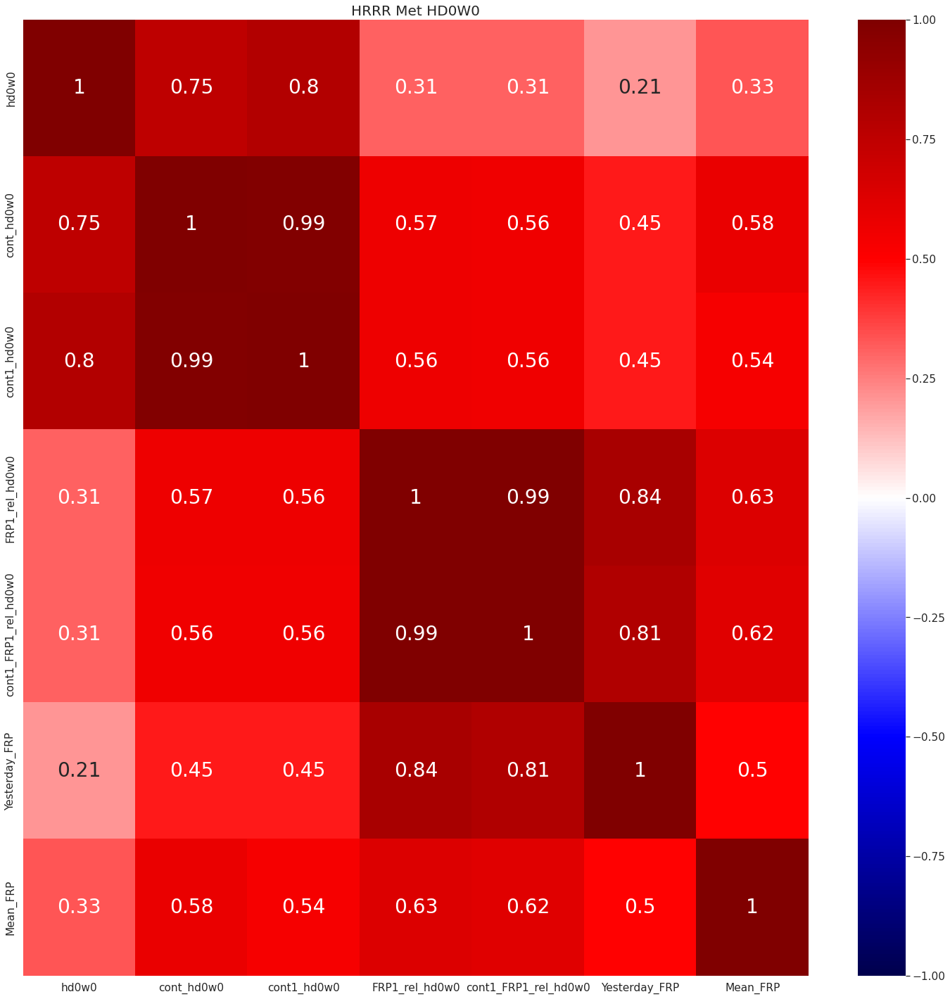

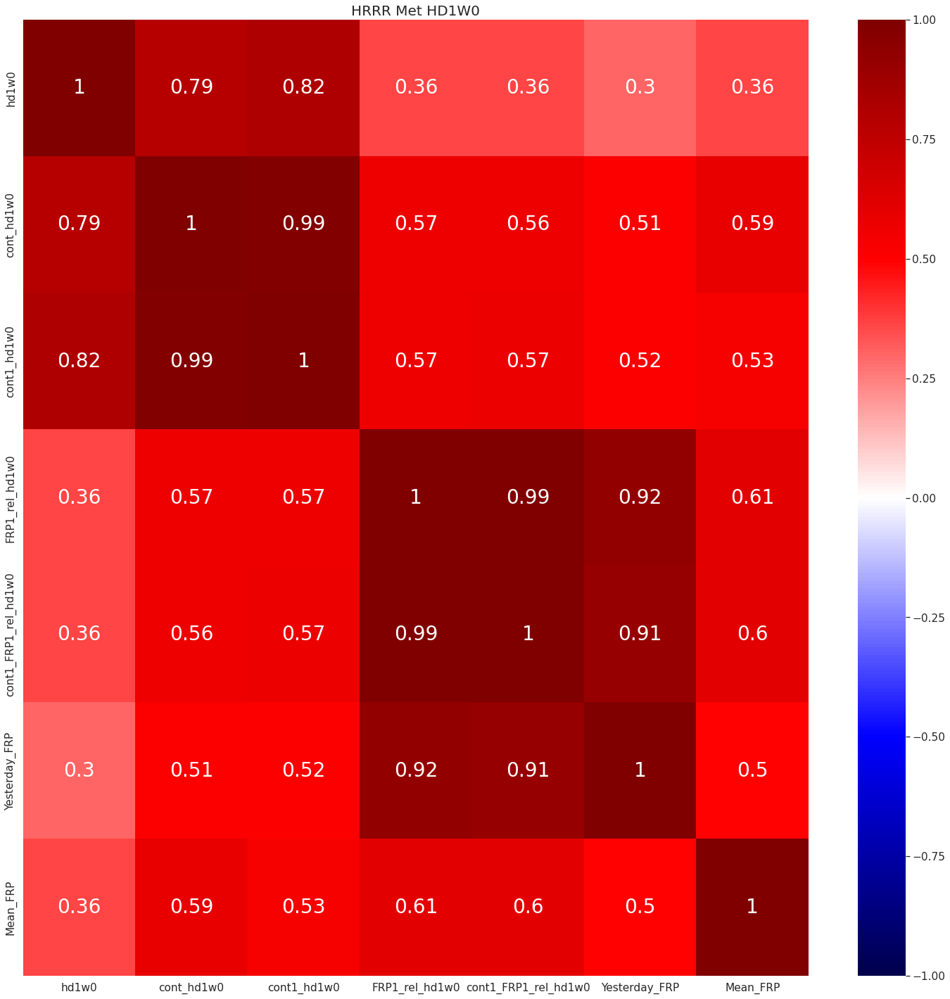

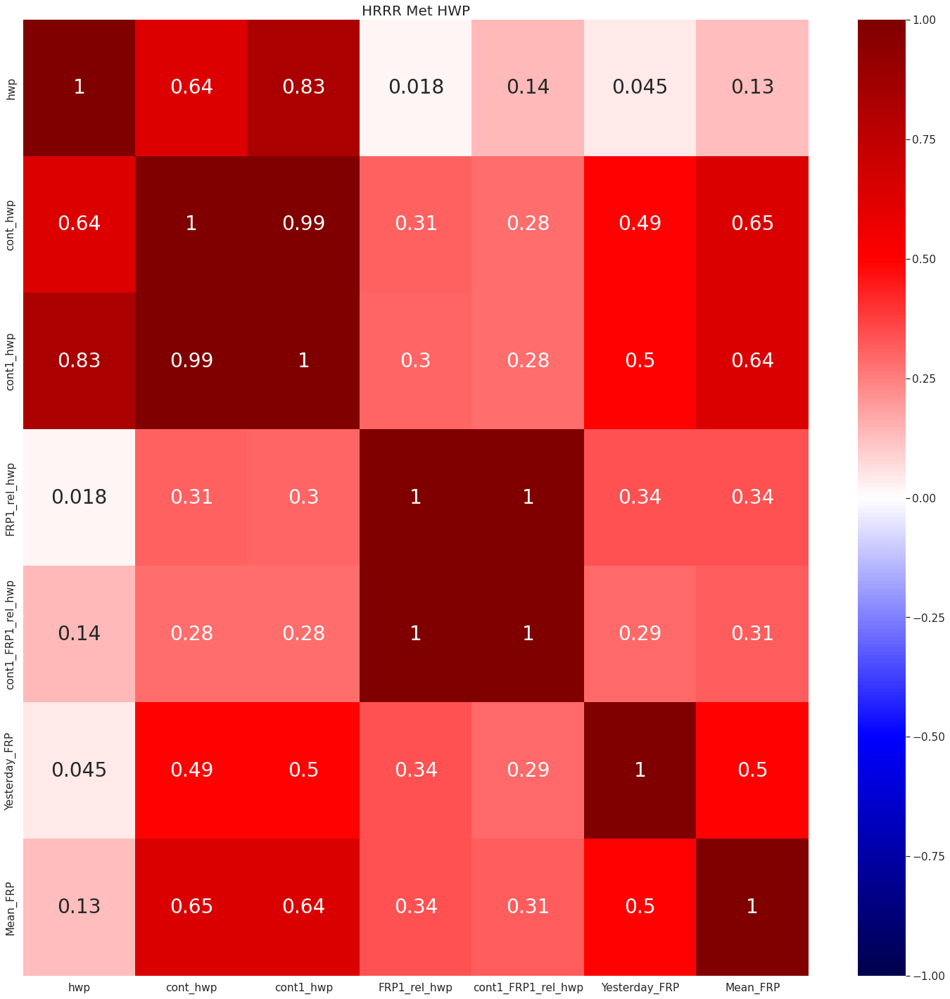

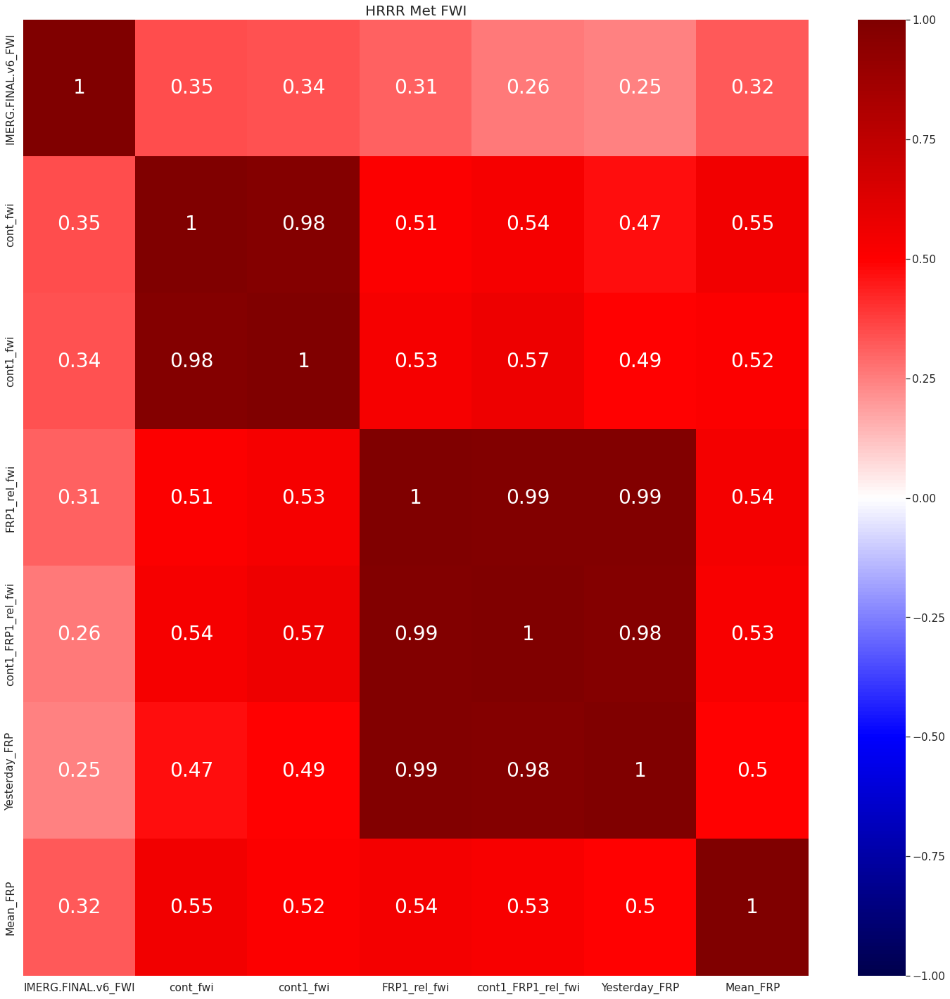

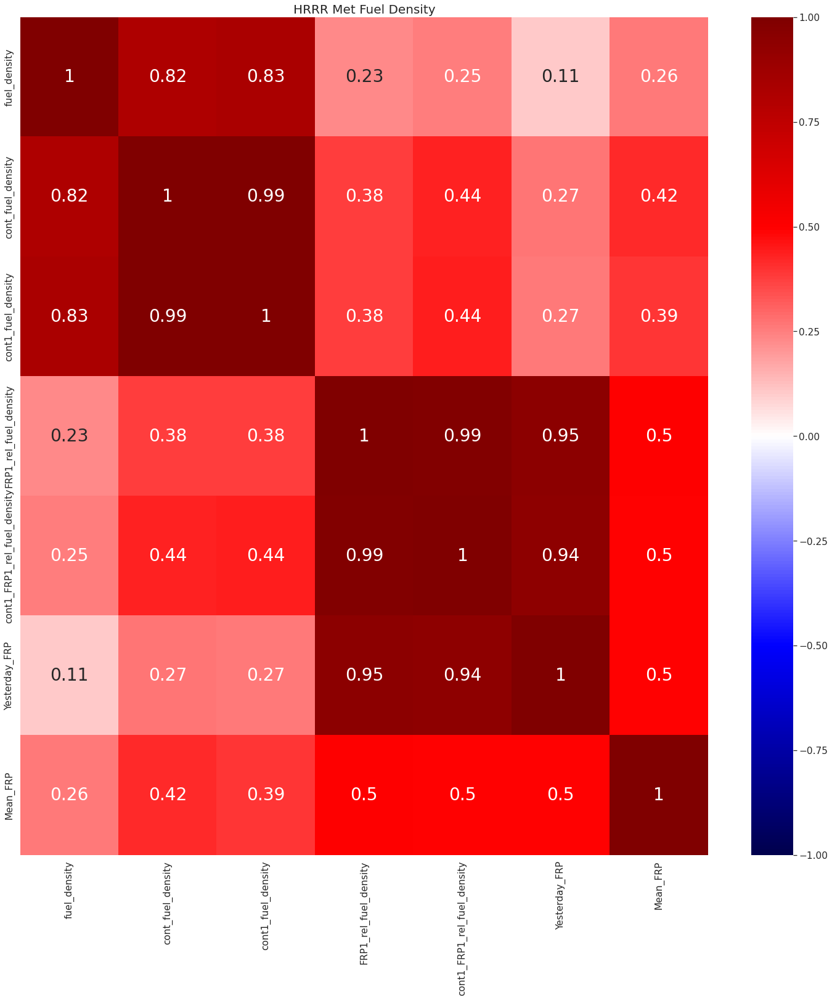

In [10]:
# derived indices (current starting 1/16/2023)

#not includng persistence
df_hrrr['cont_hd0w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['cont_hd1w0'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hd1w0']
df_hrrr['cont_hwp'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['hwp']
df_hrrr['cont_fwi'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['IMERG.FINAL.v6_FWI']
df_hrrr['cont_fuel_density'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['fuel_density']

df_hrrr['cont1_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['cont1_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd1w0']
df_hrrr['cont1_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hwp']
df_hrrr['cont1_fwi'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['IMERG.FINAL.v6_FWI']
df_hrrr['cont1_fuel_density'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['fuel_density']


#including persistence
df_hrrr['FRP1_rel_hd0w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
df_hrrr['FRP1_rel_hd1w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])
df_hrrr['FRP1_rel_hwp'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])
df_hrrr['FRP1_rel_fwi']= df_hrrr['Yesterday_FRP']*(df_hrrr['IMERG.FINAL.v6_FWI']/df_hrrr['Yesterday_FWI'])
df_hrrr['FRP1_rel_fuel_density']= df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])


df_hrrr['cont1_FRP1_rel_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
df_hrrr['cont1_FRP1_rel_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])
df_hrrr['cont1_FRP1_rel_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])
df_hrrr['cont1_FRP1_rel_fwi'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['IMERG.FINAL.v6_FWI']/df_hrrr['Yesterday_FWI'])
df_hrrr['cont1_FRP1_rel_fuel_density'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])

df_hrrr['FWI_scaled'] = df_hrrr['IMERG.FINAL.v6_FWI']/5


plot_correlations(df_hrrr[['hd0w0','cont_hd0w0','cont1_hd0w0', 'FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met HD0W0','pearson')
plot_correlations(df_hrrr[['hd1w0','cont_hd1w0','cont1_hd1w0', 'FRP1_rel_hd1w0','cont1_FRP1_rel_hd1w0',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met HD1W0','pearson')
plot_correlations(df_hrrr[['hwp','cont_hwp', 'cont1_hwp','FRP1_rel_hwp','cont1_FRP1_rel_hwp',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met HWP','pearson')

plot_correlations(df_hrrr[['IMERG.FINAL.v6_FWI','cont_fwi','cont1_fwi','FRP1_rel_fwi','cont1_FRP1_rel_fwi',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met FWI','pearson')

plot_correlations(df_hrrr[['fuel_density', 'cont_fuel_density','cont1_fuel_density', 'FRP1_rel_fuel_density', 'cont1_FRP1_rel_fuel_density',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met Fuel Density','pearson')







#df_hrrr = df_hrrr[df_hrrr['cont1_FRP1_rel_hwp']<800000] #gets rid of the outlier

In [ ]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['fuel_amount','cont_fuel_amount','cont1_fuel_amount'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()


In [ ]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['FRP1_rel_fuel_amount','cont1_FRP1_rel_fuel_amount'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()


In [ ]:
#compare the different versions of weather, also taking into account containment and persistence
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones

df_hrrr = df_hrrr[df_hrrr['cont1_FRP1_rel_hwp']<800000]
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['cont1_FRP1_rel_hd0w0','cont1_FRP1_rel_hd1w0','cont1_FRP1_rel_hwp',
                                   'cont1_FRP1_rel_fwi','cont1_FRP1_rel_fuel_amount'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()

In [ ]:
#def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):

#is there a way to 
scatter_plot(df_hrrr,'fuel_amount','hd1w0','Mean_FRP', 'name', 'Mean_FRP', (20,500), 'All 3 Fires')
#scatter_plot(df_hrrr[df_hrrr['percent_contained']<50],'fuel_amount','hd1w0','Mean_FRP', 'name', 'Mean_FRP', (20,500), 'All 3 Fires')
scatter_plot(df_hrrr,'cont_fuel_amount','cont_hd1w0','Mean_FRP', 'name', 'Mean_FRP', (20,1000), 'All 3 Fires')

scatter_plot(df_hrrr,'fuel_amount','hd1w0','Mean_FRP', 'name', 'Yesterday_FRP', (20,500), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel_amount','hd1w0','Mean_FRP', 'name', 'percent_contained', (20,500), 'All 3 Fires')

#scatter_plot(df_hrrr,'cont1_FRP1_rel_fuel_amount','cont1_FRP1_rel_hd1w0','Mean_FRP', 'name', 'Yesterday_FRP', (20,500), 'All 3 Fires')


plot_correlations(df_hrrr[['temp_2m','vpd_2m', 'wind_speed','hd1w0','fuel_amount',
                           'cont_hd1w0','cont_fuel_amount',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met FWI','pearson')

In [ ]:
# for the Jan 30th, 2023 research update
#only using HRRR for simplicity

#derived variables
plot_correlations(df_hrrr[['hd0w0','cont_hd0w0','cont1_hd0w0','FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0',
                           'IMERG.FINAL.v6_FWI','fuel_density',
                           'fuel_amount','cont_fuel_amount','cont1_fuel_amount',
                           'Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met Pearson','pearson')

In [ ]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones

for ii in range(len(fire_incidents)):
    print(fire_incidents[ii])
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    plot_correlations(features_plot[['hd0w0','cont_hd0w0','cont1_hd0w0','FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0','fuel_density',
                           'fuel_amount','cont_fuel_amount','cont1_fuel_amount','Yesterday_FRP','Mean_FRP']], 
                  'HRRR Met Pearson '+fire_incidents[ii],'pearson')

BOBCAT


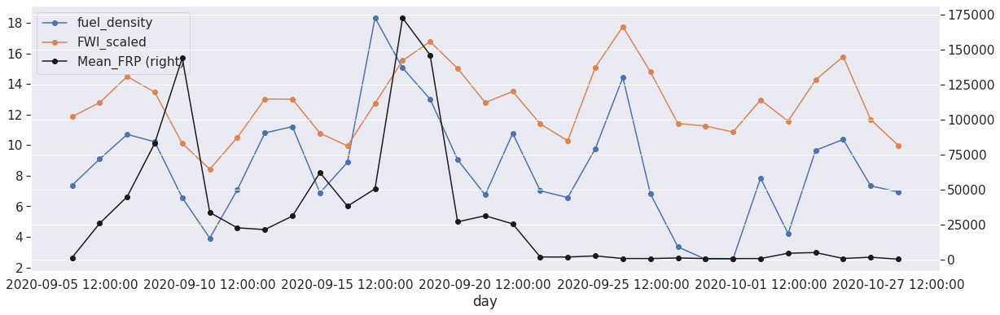

DOLAN


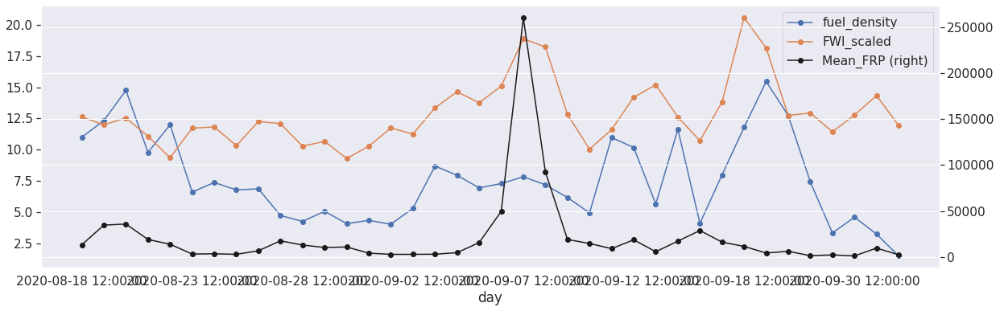

LAKE


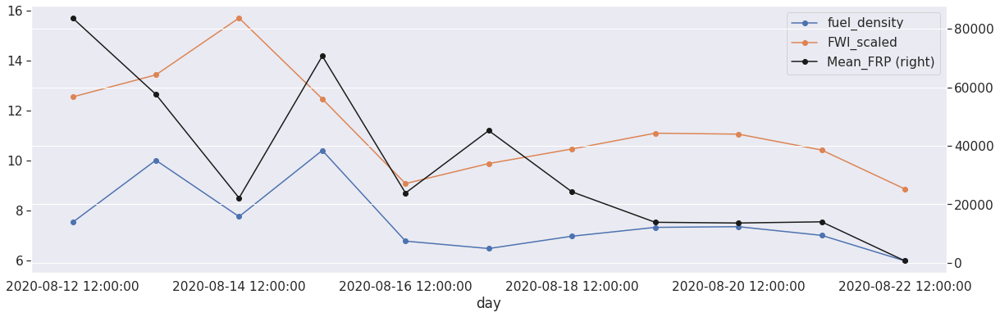

In [26]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['fuel_density','FWI_scaled'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()

In [ ]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['fuel_amount','cont_fuel_amount'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()

In [ ]:
fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['cont1_FRP1_rel_hd0w0'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    plt.show()

In [ ]:
#def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):

#plot_correlations(df_hrrr[['hd0w0','cont_hd0w0','cont1_hd0w0','FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0','fuel',
#                           'Yesterday_FRP','Mean_FRP']], 
#                  'HRRR Met Pearson','pearson')

fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
#scatter_plot(df_hrrr,'fuel','Mean_FRP','hd0w0', 'name', 'hd0w0', (20,200), 'All 3 Fires')
#scatter_plot(df_hrrr,'fuel','Mean_FRP','cont1_hd0w0', 'name', 'cont1_hd0w0', (20,200), 'All 3 Fires')
#scatter_plot(df_hrrr,'fuel','Mean_FRP','FRP1_rel_hd0w0', 'name', 'FRP1_rel_hd0w0', (20,500), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel_density','Mean_FRP','cont1_FRP1_rel_hd0w0', 'name', 'cont1_FRP1_rel_hd0w0', (20,200), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel_amount','Mean_FRP','cont1_FRP1_rel_hd0w0', 'name', 'cont1_FRP1_rel_hd0w0', (20,200), 'All 3 Fires')

In [ ]:
scatter_plot(df_hrrr,'cont1_FRP1_rel_hd0w0','Mean_FRP','fuel', 'name', 'fuel', (20,200), 'All 3 Fires')


In [ ]:
#def scatter_plot(df_plot,x_plot,y_plot,point_hue, point_style, point_size, point_size_range,plot_title):

#plot_correlations(df_hrrr[['hd0w0','cont_hd0w0','cont1_hd0w0','FRP1_rel_hd0w0','cont1_FRP1_rel_hd0w0','fuel',
#                           'Yesterday_FRP','Mean_FRP']], 
#                  'HRRR Met Pearson','pearson')

fire_incidents = ['BOBCAT', 'DOLAN', 'LAKE'] #only california ones
scatter_plot(df_hrrr,'fuel','Mean_FRP','hd1w0', 'name', 'hd1w0', (20,200), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel','Mean_FRP','cont1_hd1w0', 'name', 'cont1_hd1w0', (20,200), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel','Mean_FRP','FRP1_rel_hd1w0', 'name', 'FRP1_rel_hd1w0', (20,500), 'All 3 Fires')
scatter_plot(df_hrrr,'fuel','Mean_FRP','cont1_FRP1_rel_hd1w0', 'name', 'cont1_FRP1_rel_hd1w0', (20,500), 'All 3 Fires')

In [ ]:
# what's the deal with the outliers?
outs = df_hrrr[df_hrrr['cont1_FRP1_rel_hd0w0'].values>200000]
print(outs.columns)
outs[['Yesterday_percent_contained','Yesterday_FRP','hd0w0','Yesterday_HD0W0','cont1_FRP1_rel_hd0w0']]

## Feb 6th Update

In [11]:
#most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
merra_all = pd.DataFrame()
rave_all = pd.DataFrame()
hrrr_ws_all = pd.DataFrame()
esi_all = pd.DataFrame()
pws_all = pd.DataFrame()
igbp_all = pd.DataFrame()
names_all = pd.DataFrame()
resources_all = pd.DataFrame()
fuel_loading_all = pd.DataFrame()
area_all = pd.DataFrame()
fireline_all = pd.DataFrame()
days_all = pd.DataFrame()
fwi_all = pd.DataFrame()
fuels_fwi_all = pd.DataFrame()


fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents =['AUGUST COMPLEX']
#fire_incidents = ['BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
    merra = pd.read_csv(path_features+file_prefix+'_Daily_MERRA_'+str(start_time)+'Z_day_start.csv')
    resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')
    fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels_fwi = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    area = pd.read_csv(path_features+file_prefix+'_Daily_FIRE_AREA_'+str(start_time)+'Z_day_start.csv')
    
    #calculate the fuel density and amount for the given fire
    fwis = fwi['IMERG.FINAL.v6_FWI'].values.reshape(len(fwi),-1)
    fuels_fwis = fuels_fwi.drop(columns=['Unnamed: 0', 'day'])
    fuels_fwis = fuels_fwis[['Low_N', 'Moderate_N',
                              'High_N','VeryHigh_N',
                              'Extreme_N']]
    print(fuels_fwis.columns)
    #append FWI values and sort them
    category_midpoints = np.tile([157,83,60.5,42.5,16.5],len(fwis)).reshape(len(fwis),-1)
    to_sort = np.append(category_midpoints,fwis,axis=1)
    sortedd = np.sort(to_sort,axis=1)

    #get the indices of the columns that we need to average
    column_indices = np.array([np.where(sortedd[kk,:]==fwis[kk]) for kk in range(len(fwis))]).flatten()
    print(column_indices)
    #initialise a dataframe
    fuel_ave = [(fuels_fwis.iloc[jj,column_indices[jj]]+
            fuels_fwis.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]

    fuels_fwi['fuel_density'] = np.array(fuel_ave).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_fwi['fuel_amount'] = fuels_fwi['fuel_density']*area['fire area (ha)']


    #do the shift
    rave_shifted = shift_ndays(rave,1,['Mean_FRP'],['Yesterday_FRP'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws,1,['hd0w0','hd1w0','hwp'],
                                  ['Yesterday_HD0W0','Yesterday_HD1W0','Yesterday_HWP'])
    merra_shifted = shift_ndays(merra, 1,['hd0w0'], ['Yesterday_HD0W0'])
    resources_shifted = shift_ndays(resources, 1,['percent_contained'],['Yesterday_percent_contained'])
    fwi_shifted = shift_ndays(fwi,1,['IMERG.FINAL.v6_FWI'], ['Yesterday_FWI'])
    fuels_fwi_shifted = shift_ndays(fuels_fwi,1,['fuel_density'],['Yesterday_fuel_density'])

    
    days = pd.DataFrame({'day':np.zeros(len(resources_shifted))})
    days['day'] = rave['day'].values
    
    #get the active days
    inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave_shifted = rave_shifted.iloc[inds_active]
    hrrr_ws_shifted = hrrr_ws_shifted.iloc[inds_active]
    merra_shifted = merra_shifted.iloc[inds_active]
    resources_shifted = resources_shifted.iloc[inds_active]
    fwi_shifted = fwi_shifted.iloc[inds_active]
    fuels_fwi_shifted = fuels_fwi_shifted.iloc[inds_active]
    
    pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv').iloc[inds_active] 
    igbp = pd.read_csv(path_features+file_prefix+'_Daily_IGBP_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    esi = pd.read_csv(path_features+file_prefix+'_Daily_ESI_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    fuel_loading = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_LOADING_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    
    fireline = pd.read_csv(path_features+file_prefix+'_Daily_FIRELINE_'+
                           str(start_time)+'Z_day_start.csv')
    fireline['yesterday_total_length'] = fireline['total_length'].shift(1)
    fireline=fireline[fireline['day'].isin(days['day'])]
    
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})

    merra_all = pd.concat([merra_all,merra_shifted], axis=0)
    rave_all = pd.concat([rave_all,rave_shifted], axis=0)
    hrrr_ws_all = pd.concat([hrrr_ws_all,hrrr_ws_shifted],axis=0)
    esi_all = pd.concat([esi_all,esi], axis=0)
    pws_all = pd.concat([pws_all,pws], axis=0)
    igbp_all= pd.concat([igbp_all,igbp])
    names_all = pd.concat([names_all,names])
    resources_all = pd.concat([resources_all,resources_shifted])
    fuel_loading_all=pd.concat([fuel_loading_all,fuel_loading])
    area_all = pd.concat([area_all,area])
    days_all = pd.concat([days_all,days])
    fireline_all = pd.concat([fireline_all,fireline])
    fwi_all = pd.concat([fwi_all,fwi_shifted])
    fuels_fwi_all = pd.concat([fuels_fwi_all,fuels_fwi_shifted])
    #cpc_all = pd.concat([cpc_all,cpc], axis=0)
    #imerg_all = pd.concat([imerg_all,imerg], axis=0)

august_complex
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 2 2 2 2 2 1 1 2 1 2 2 3 3 3 3 3 2 3 3 3 3 4 4 3 2 2 3 3 2 2 3 3 4 4 3 3
 2 2 4 4 3 2 3 2 3 3 3 3 3 3 4 4 4 4 3 2 2 3 3 3 2 3 3 2 4 3 4 0 1]
bobcat
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[2 3 3 3 2 1 2 3 3 2 2 3 3 4 3 3 3 2 2 3 4 3 2 2 2 3 3 2 3 3 3 3 2 3 3 2 2
 2]
dolan
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 2 3 2 2 2 2 2 3 2 2 2 2 2 2 2 3 3 3 3 4 4 3 2 2 3 3 3 2 3 4 4 3 3 3 2 3
 3 2]
creek
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 3 3 4 4 3 2 2 3 3 2 2 3 3 4 4 3 3 2 2 4 4 3 2 3 2 3 3 3 3 3 3 4 4 4 4 3
 2 2 3 3 3 2 3 3 2 3 4 3 3 3 4 4 0 0 1 1]
lake
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 3 3 3 2 2 2 2 2 2 2 2]


In [66]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD0W0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FWI','Yesterday_FWI']].reset_index(drop=True),
                fuels_fwi_all[['fuel_density','Yesterday_fuel_density']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)
print(df_hrrr.columns)
df_hrrr['FWI_scaled'] = df_hrrr['IMERG.FINAL.v6_FWI']/5

Index(['day', 'temp_2m', 'vpd_2m', 'wind_speed', 'hd0w0', 'hd1w0',
       'Yesterday_HD0W0', 'Yesterday_HD1W0', 'hd2w0', 'hd3w0', 'hd4w0',
       'hd5w0', 'hwp', 'Yesterday_HWP', 'IMERG.FINAL.v6_FWI', 'Yesterday_FWI',
       'fuel_density', 'Yesterday_fuel_density', 'PWS', 'ESI', 'name',
       'personnel', 'percent_contained', 'Yesterday_percent_contained',
       'fuel_loadings', 'fire area (ha)', 'fire area (acre)', 'Mean_FRP',
       'Yesterday_FRP'],
      dtype='object')


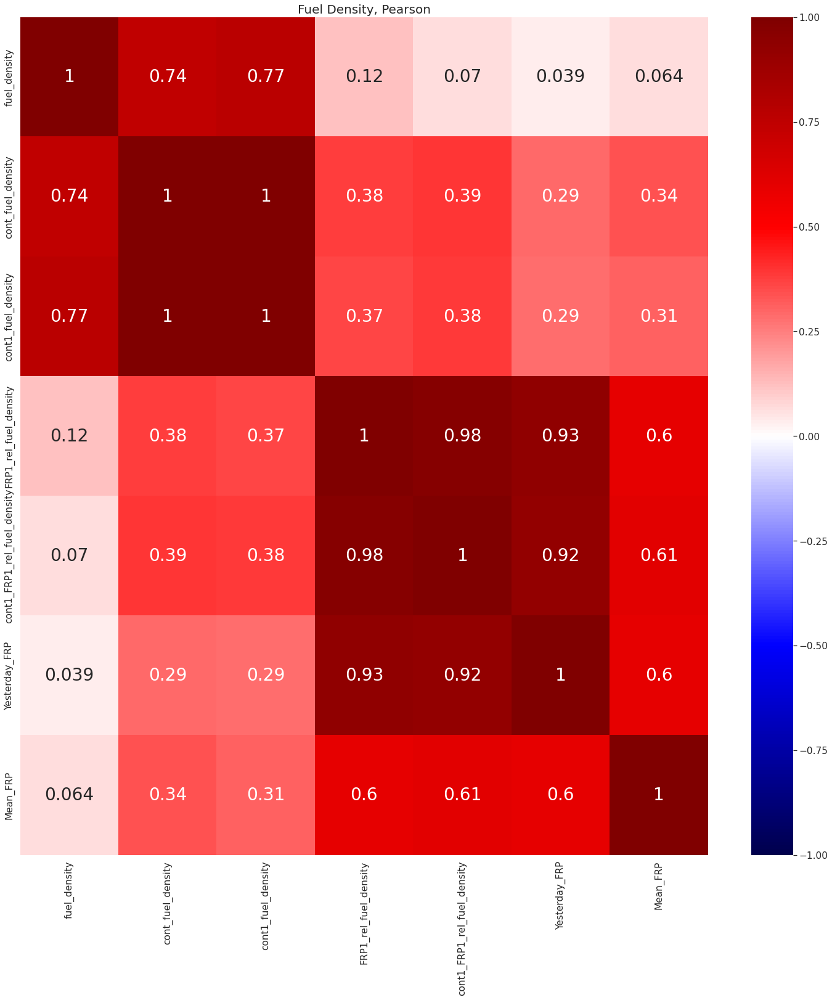

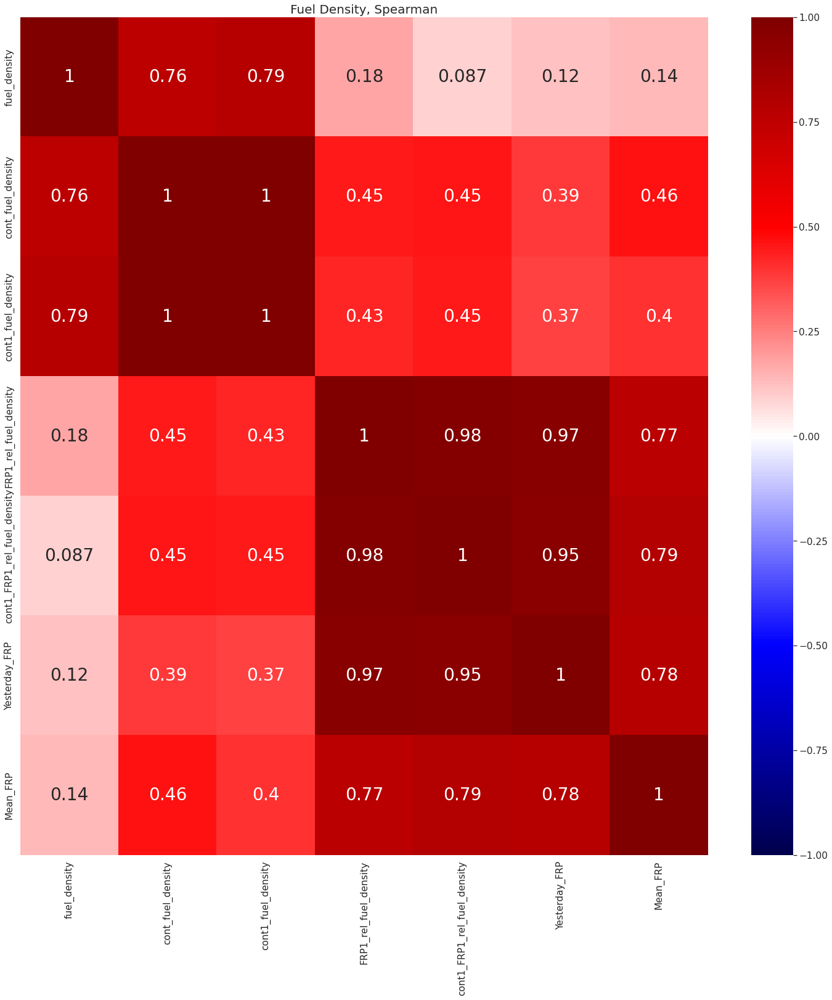

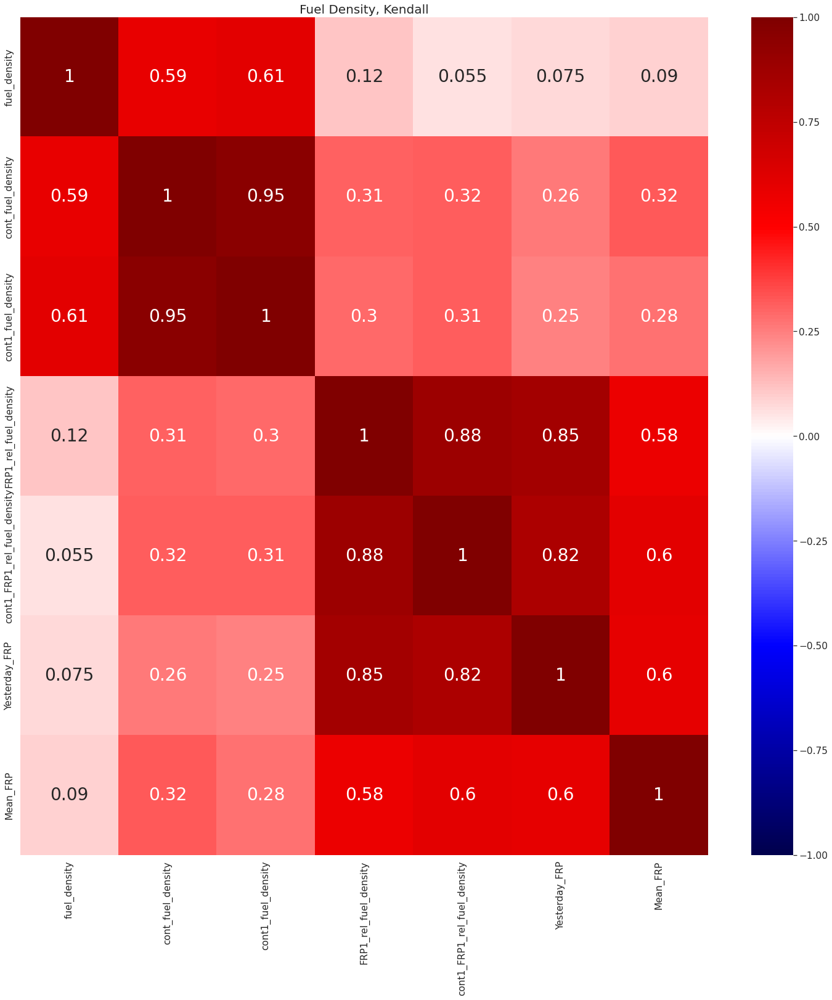

AUGUST COMPLEX


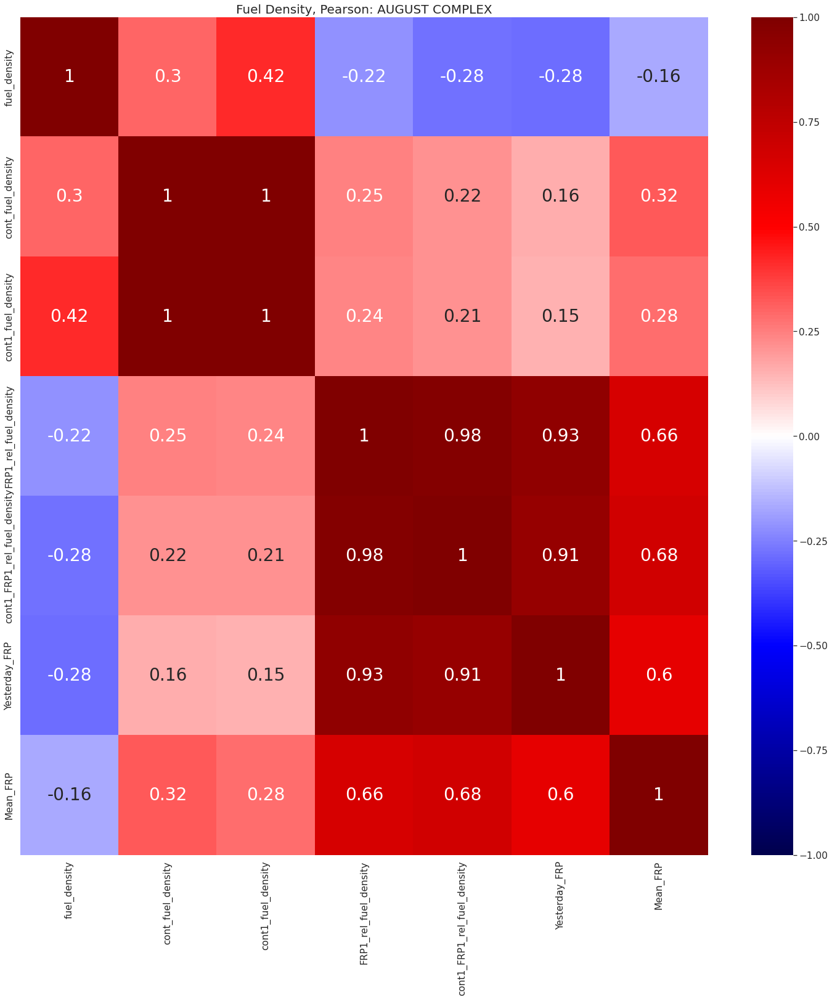

BOBCAT


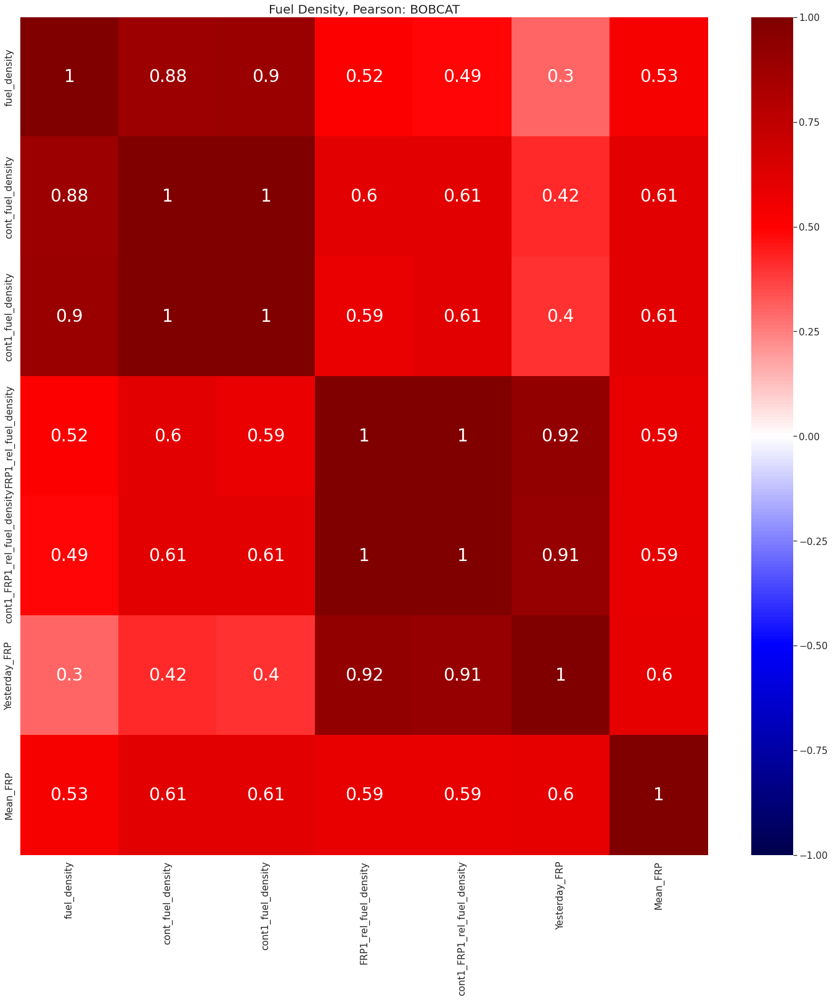

CREEK


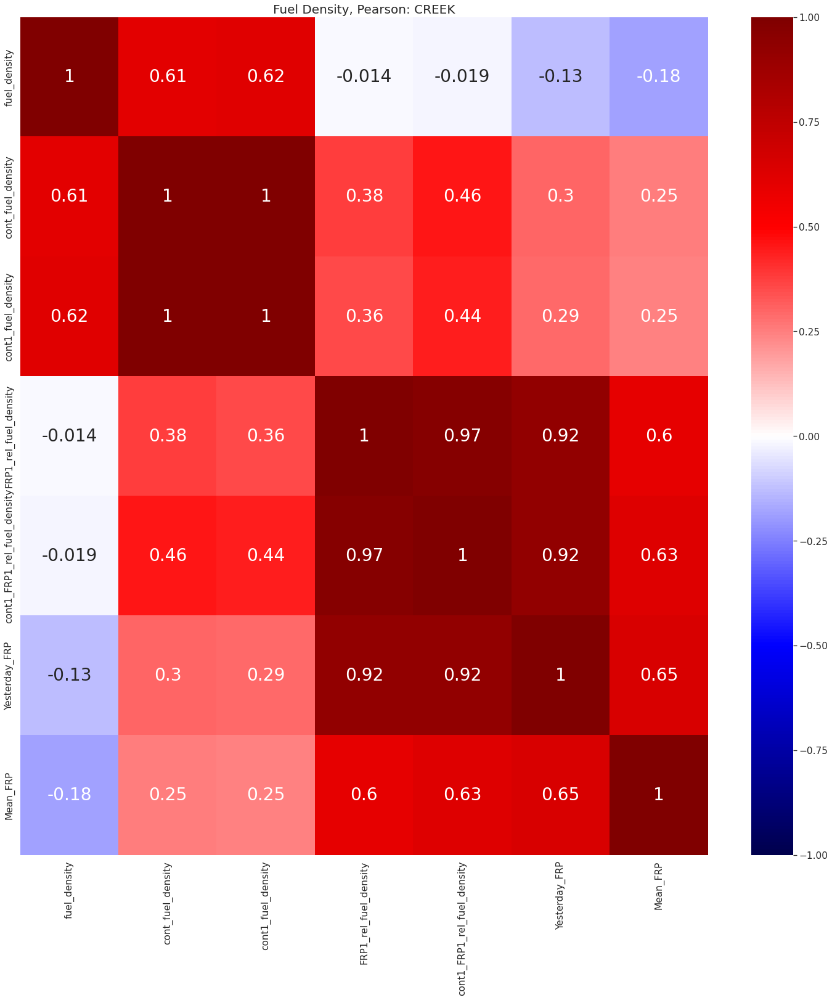

DOLAN


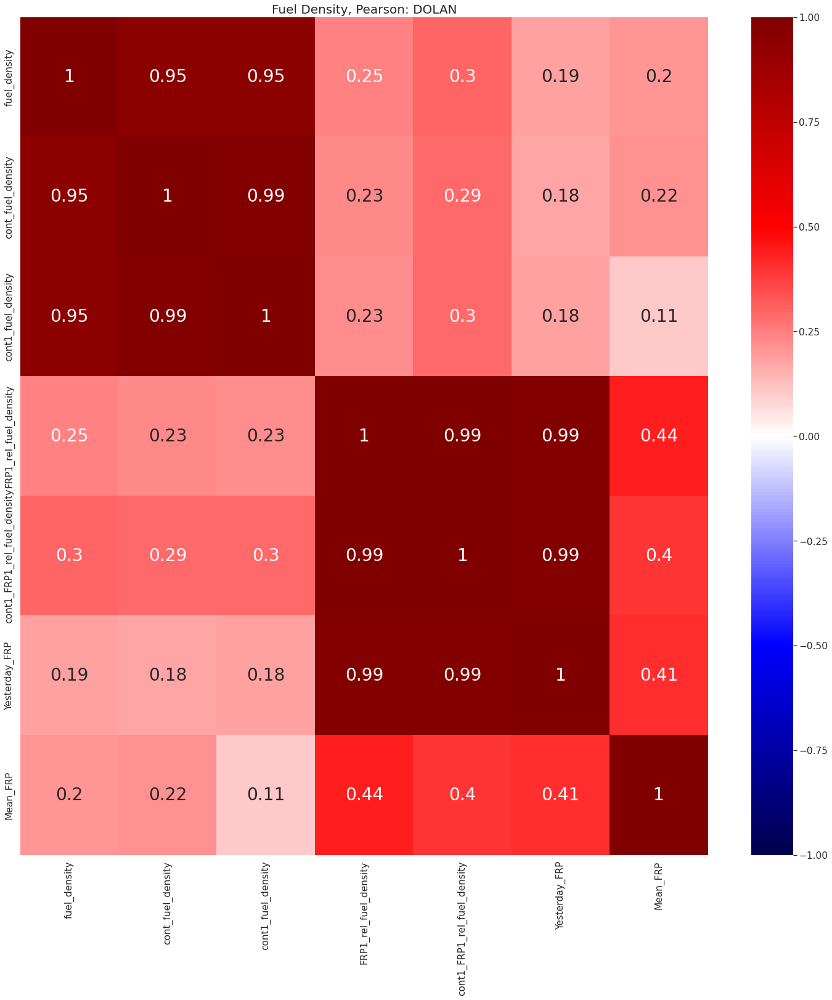

LAKE


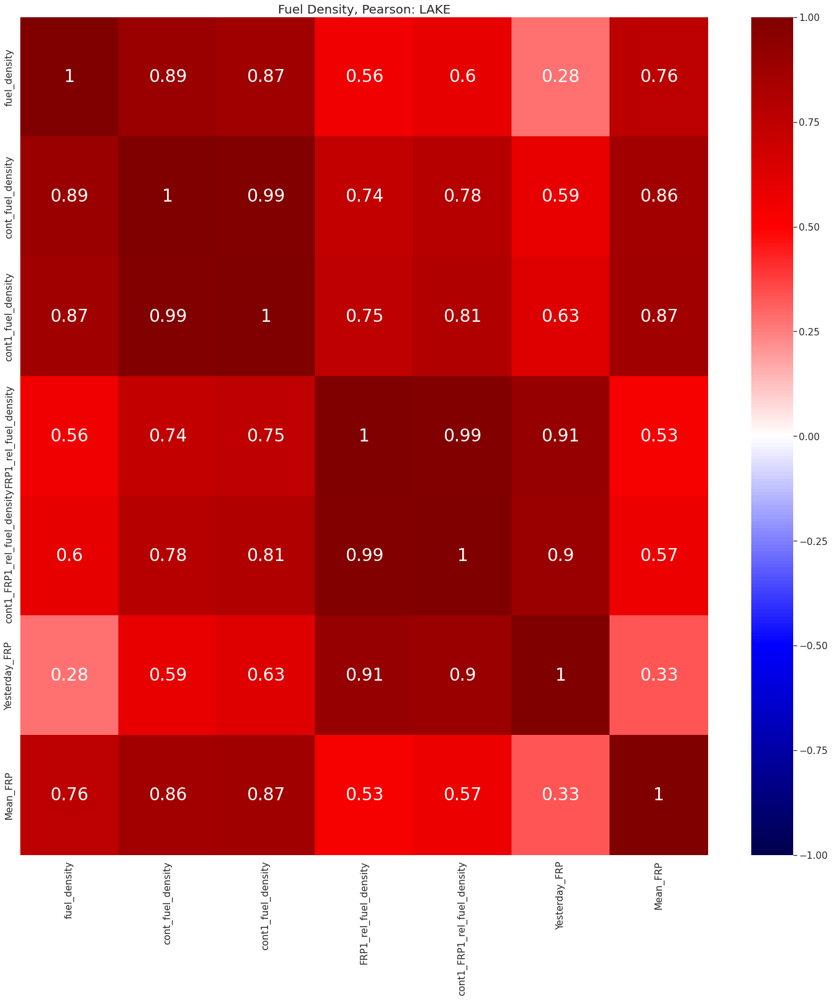

In [67]:
# derived indices
df_hrrr['cont_fuel_density'] = (1-(df_hrrr['percent_contained']/100))*df_hrrr['fuel_density']
df_hrrr['cont1_fuel_density'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['fuel_density']
df_hrrr['FRP1_rel_fuel_density']= df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])
df_hrrr['cont1_FRP1_rel_fuel_density'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])

var_corr = ['fuel_density', 'cont_fuel_density','cont1_fuel_density', 'FRP1_rel_fuel_density', 'cont1_FRP1_rel_fuel_density',
                           'Yesterday_FRP','Mean_FRP']
plot_correlations(df_hrrr[var_corr], 'Fuel Density, Pearson','pearson')
plot_correlations(df_hrrr[var_corr], 'Fuel Density, Spearman','spearman')
plot_correlations(df_hrrr[var_corr], 'Fuel Density, Kendall','kendall')


fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    plot_correlations(features_plot[var_corr], 'Fuel Density, Pearson: '+fire_incidents[ii],'pearson')


#df_hrrr = df_hrrr[df_hrrr['cont1_FRP1_rel_hwp']<800000] #gets rid of the outlier

AUGUST COMPLEX


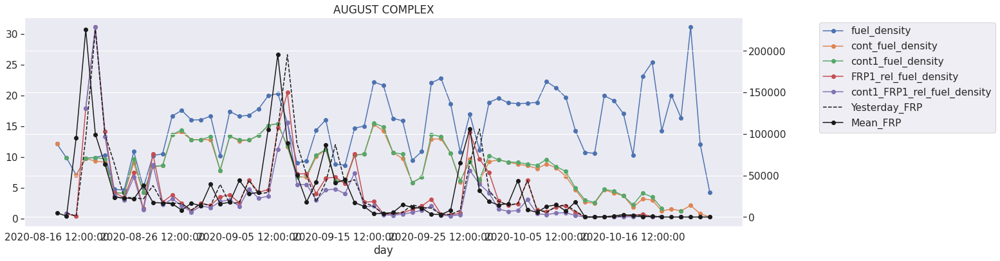

BOBCAT


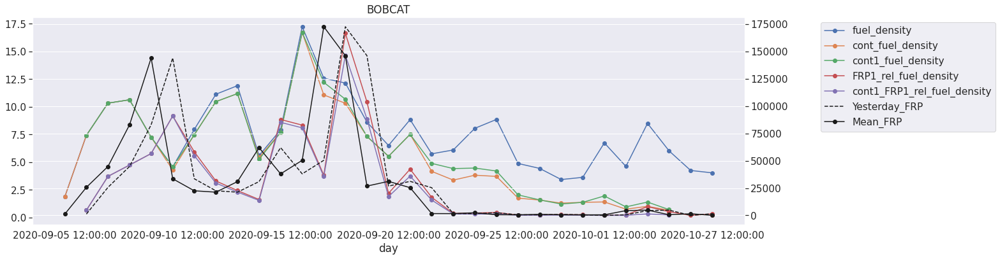

CREEK


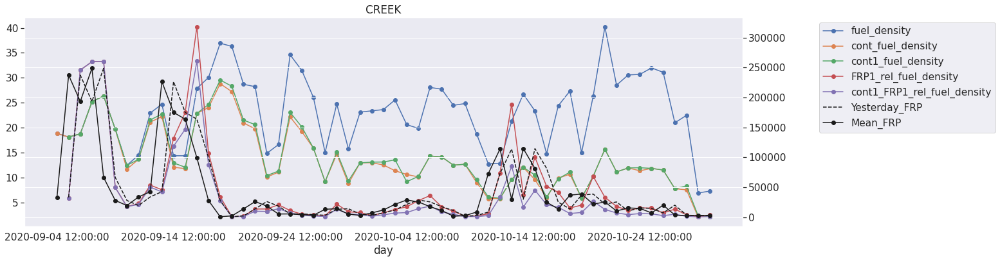

DOLAN


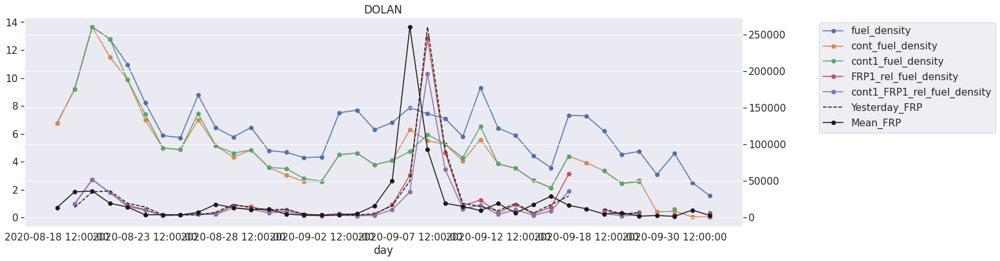

LAKE


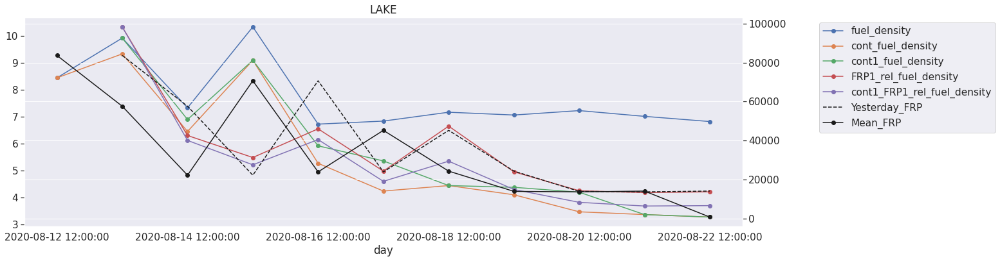

In [90]:
fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['fuel_density','cont_fuel_density', 'cont1_fuel_density'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['FRP1_rel_fuel_density', 'cont1_FRP1_rel_fuel_density'],secondary_y=True,
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                            figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()

In [102]:
#contained persistence for 
#hd0w0
df_hrrr['cont1_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['FRP1_rel_hd0w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
df_hrrr['cont1_FRP1_rel_hd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['hd0w0']/df_hrrr['Yesterday_HD0W0'])
#hd1w0
df_hrrr['cont1_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd0w0']
df_hrrr['FRP1_rel_hd0w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])
df_hrrr['cont1_FRP1_rel_hd1w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['hd1w0']/df_hrrr['Yesterday_HD1W0'])

#hwp
df_hrrr['cont1_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hwp']
df_hrrr['FRP1_rel_hwp'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])
df_hrrr['cont1_FRP1_rel_hwp'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['hwp']/df_hrrr['Yesterday_HWP'])
#fwi
df_hrrr['cont1_fwi'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['IMERG.FINAL.v6_FWI']
df_hrrr['FRP1_rel_fwi'] = df_hrrr['Yesterday_FRP']*(df_hrrr['IMERG.FINAL.v6_FWI']/df_hrrr['Yesterday_FWI'])
df_hrrr['cont1_FRP1_rel_fwi'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['IMERG.FINAL.v6_FWI']/df_hrrr['Yesterday_FWI'])
#fwi-weighted fuels
df_hrrr['cont1_fwi_fuels'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*(df_hrrr['fuel_density'])
df_hrrr['FRP1_rel_fwi_fuels'] = df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])
df_hrrr['cont1_FRP1_rel_fwi_fuels'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['fuel_density']/df_hrrr['Yesterday_fuel_density'])

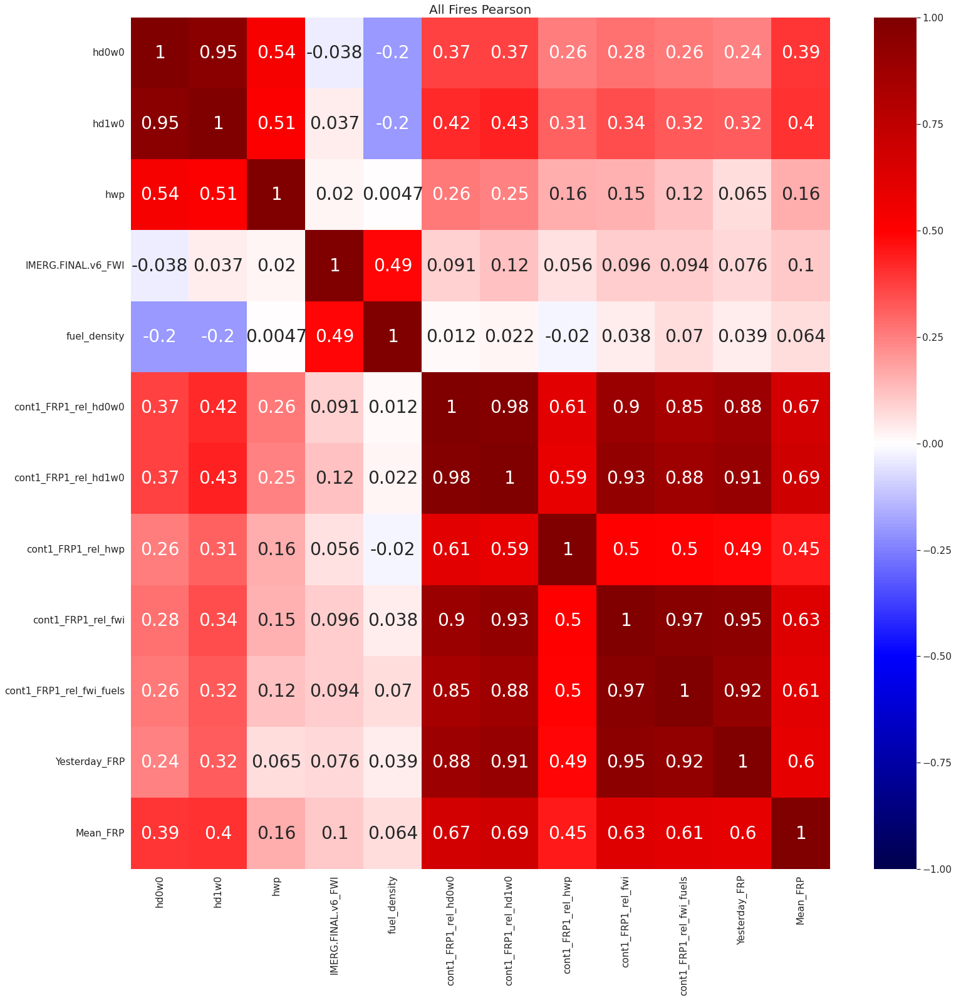

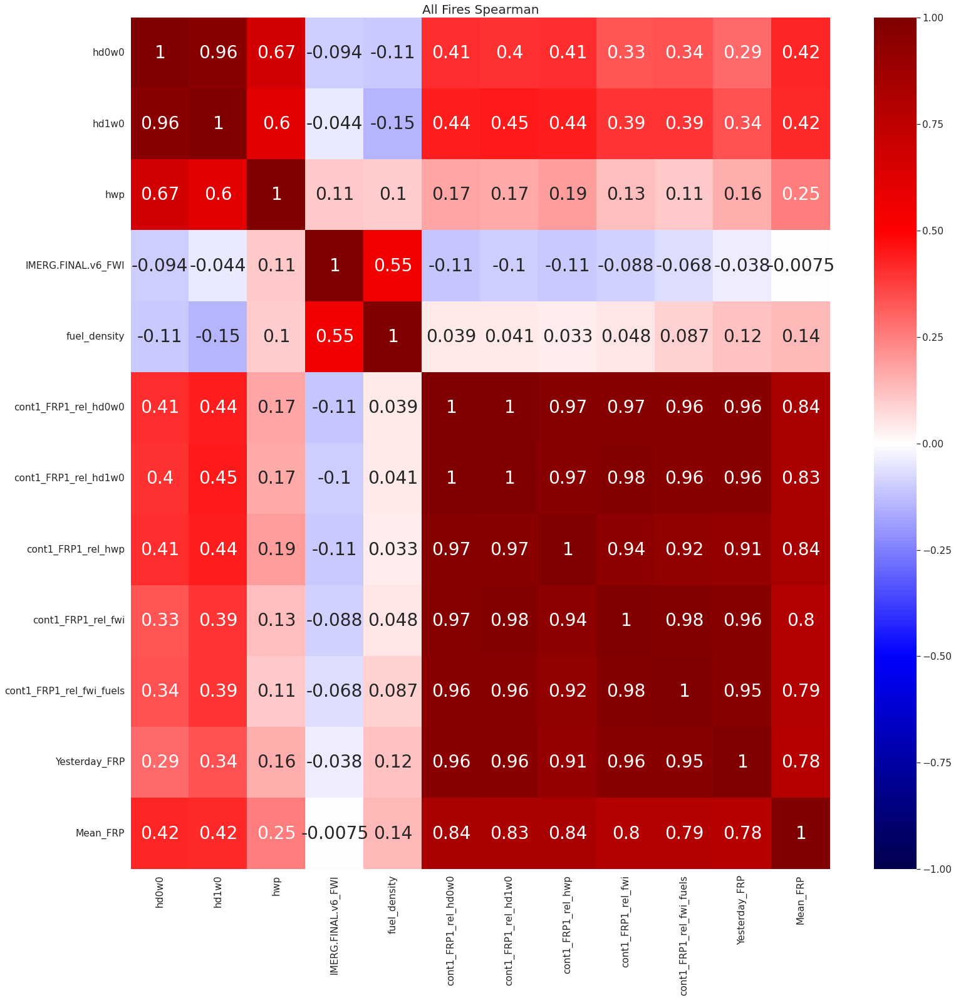

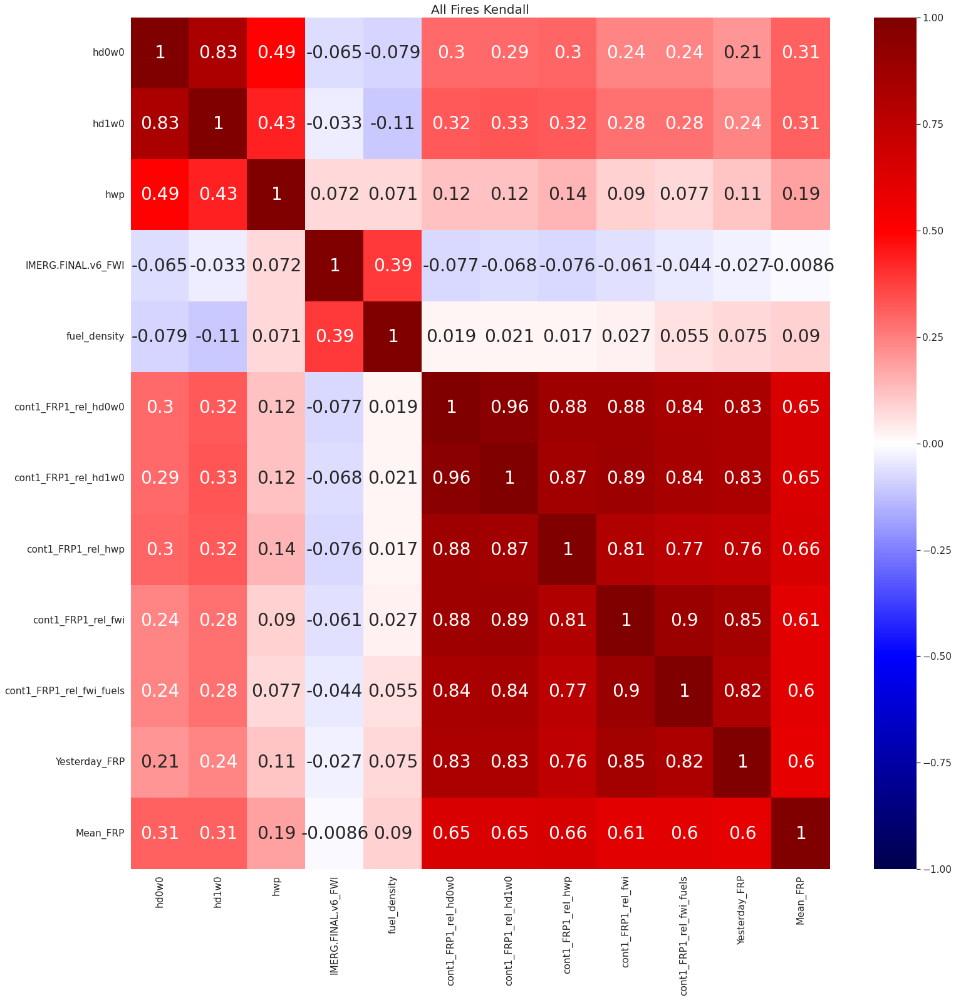

AUGUST COMPLEX


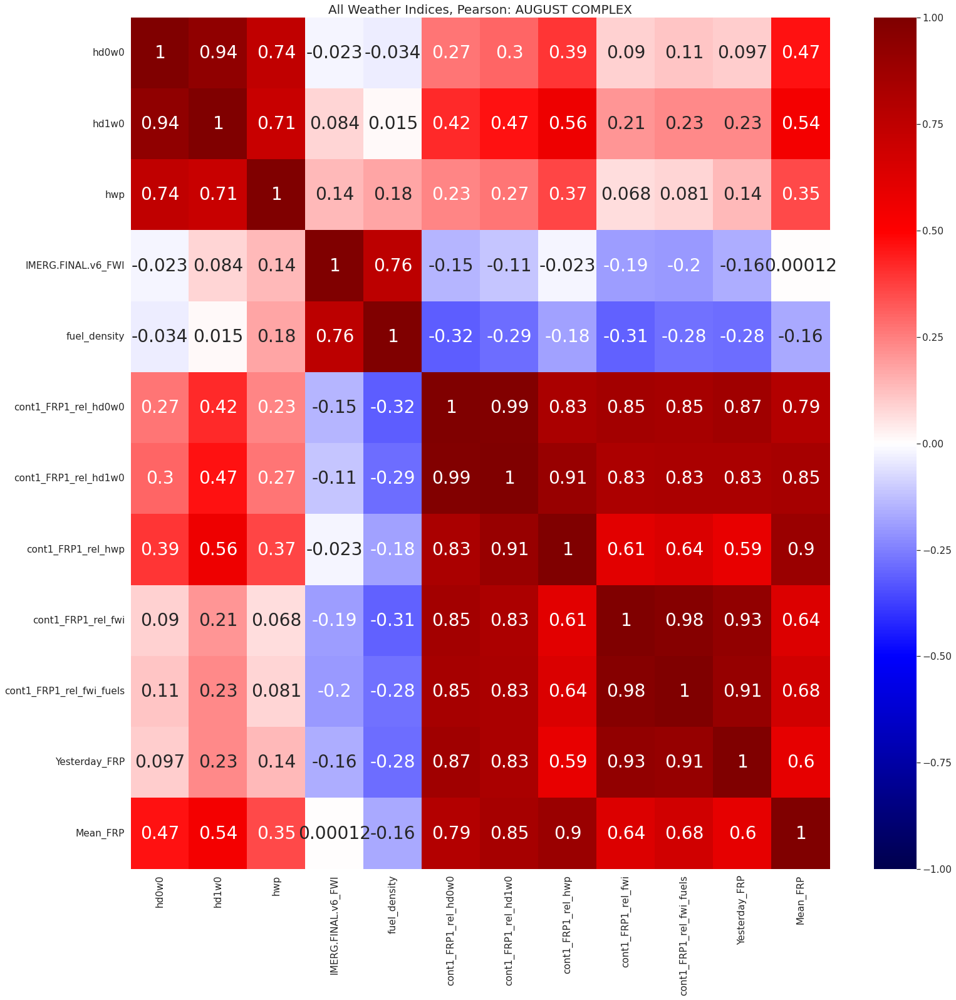

BOBCAT


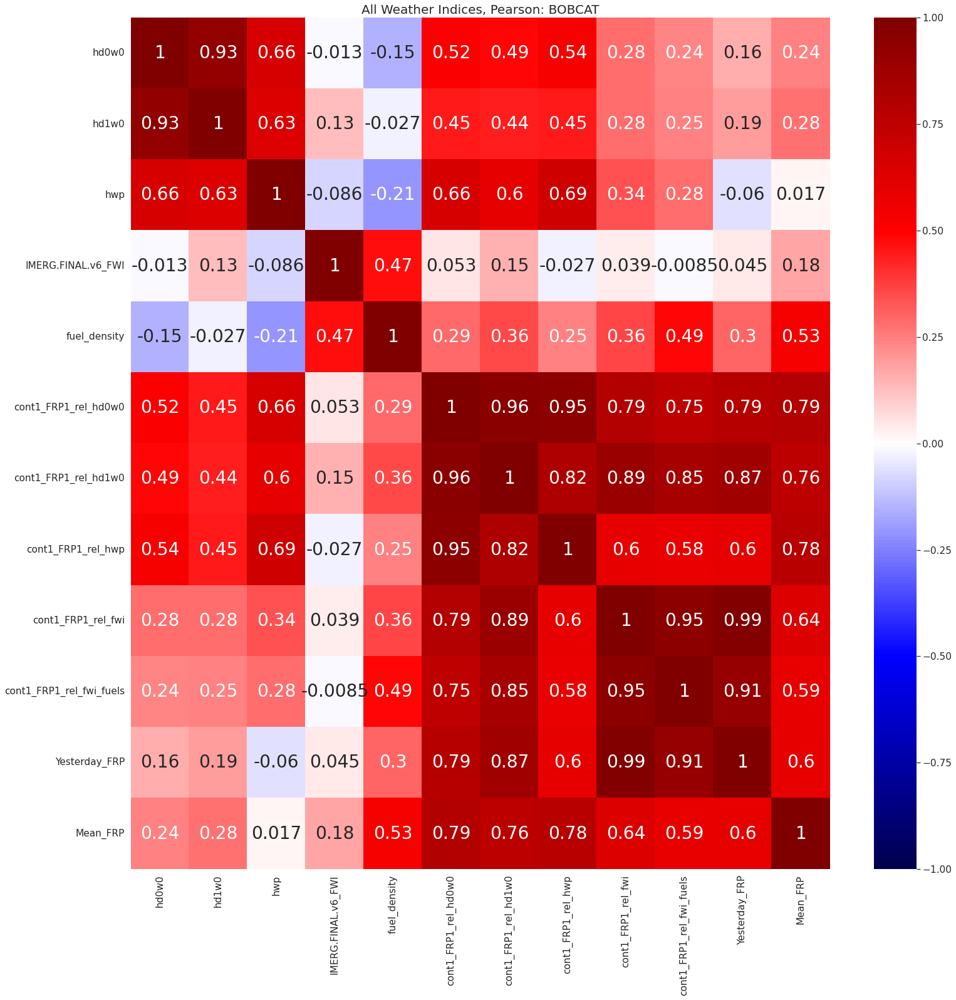

CREEK


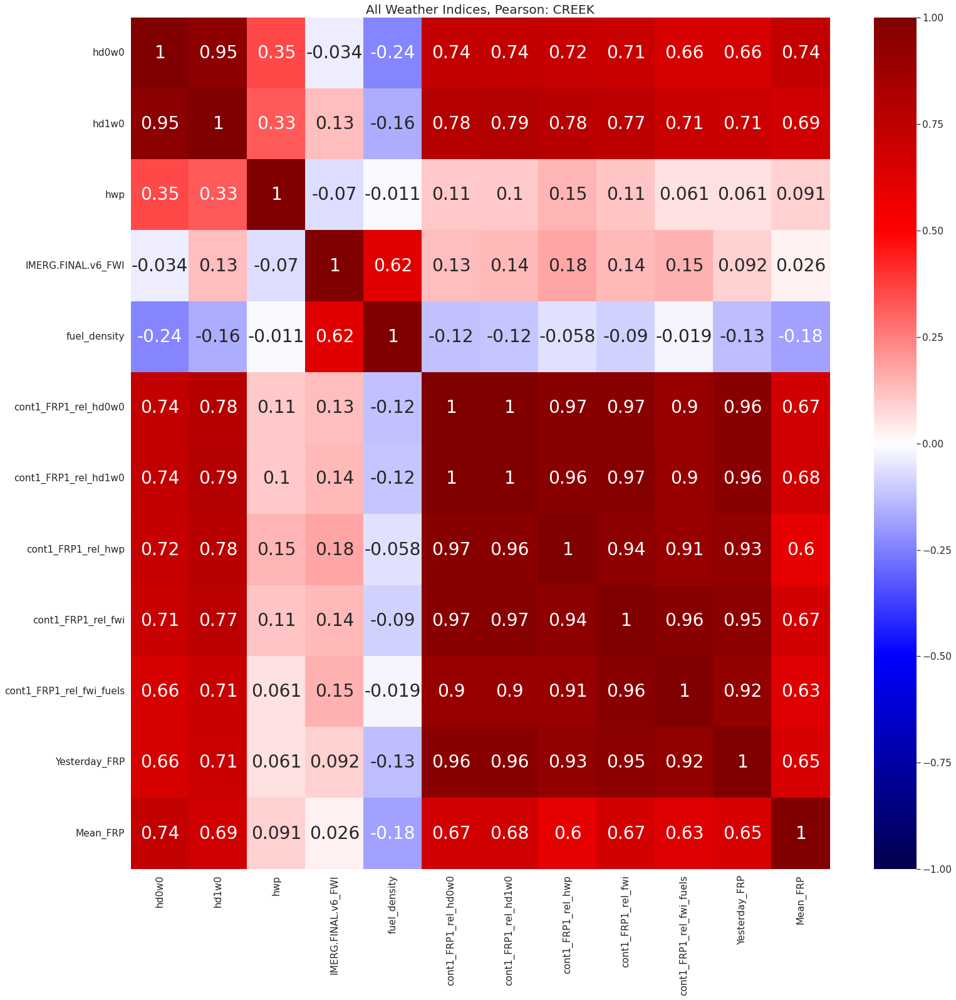

DOLAN


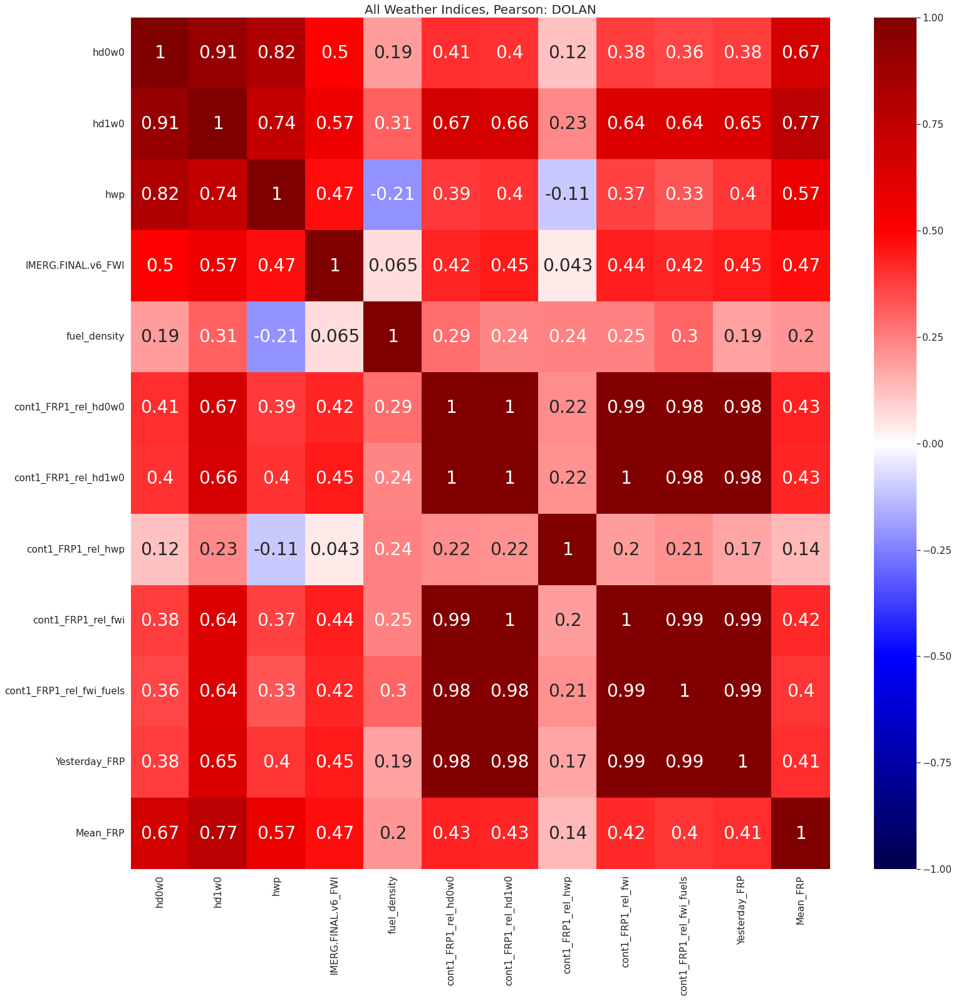

LAKE


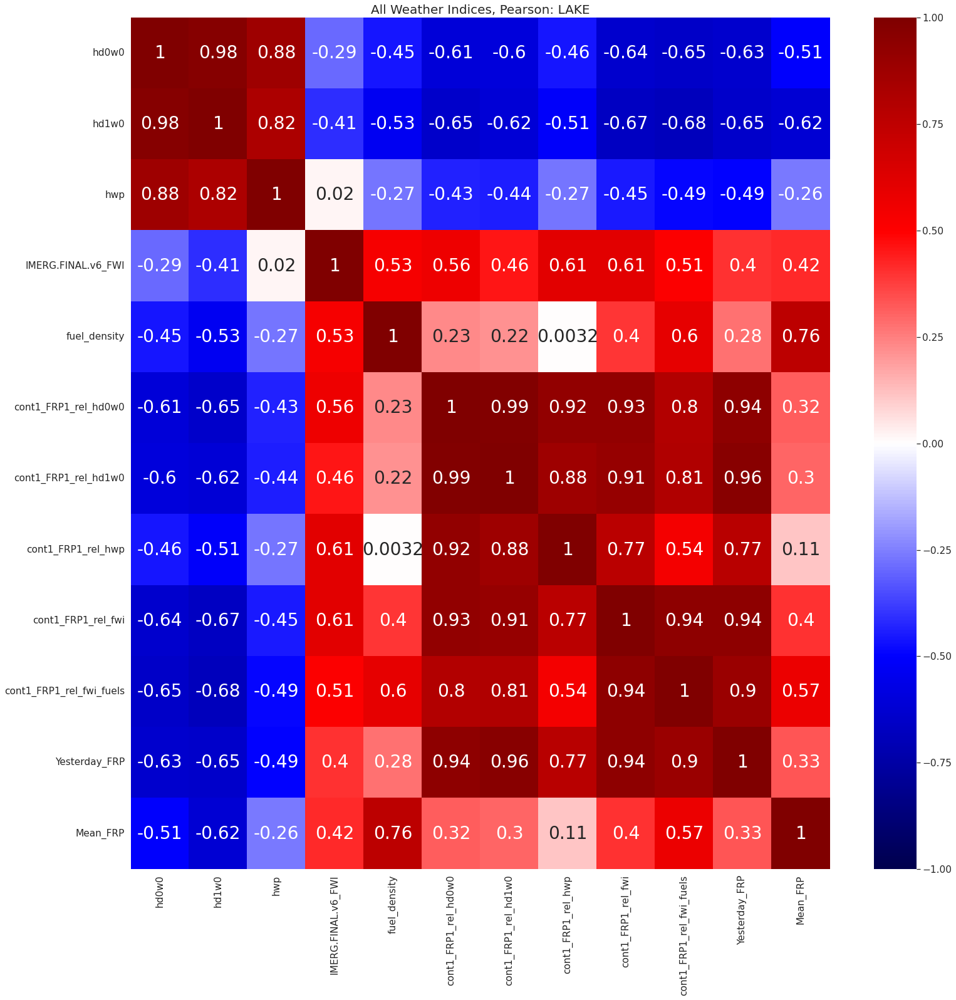

In [44]:
# correlations plot of all fires, comparing different weather indices
vars_corr = ['hd0w0','hd1w0','hwp','IMERG.FINAL.v6_FWI','fuel_density',
             'cont1_FRP1_rel_hd0w0','cont1_FRP1_rel_hd1w0','cont1_FRP1_rel_hwp',
             'cont1_FRP1_rel_fwi','cont1_FRP1_rel_fwi_fuels','Yesterday_FRP','Mean_FRP']
plot_correlations(df_hrrr[vars_corr], 'All Fires Pearson','pearson')
plot_correlations(df_hrrr[vars_corr], 'All Fires Spearman','spearman')
plot_correlations(df_hrrr[vars_corr], 'All Fires Kendall','kendall')

fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    plot_correlations(features_plot[vars_corr], 'All Weather Indices, Pearson: '+fire_incidents[ii],'pearson')

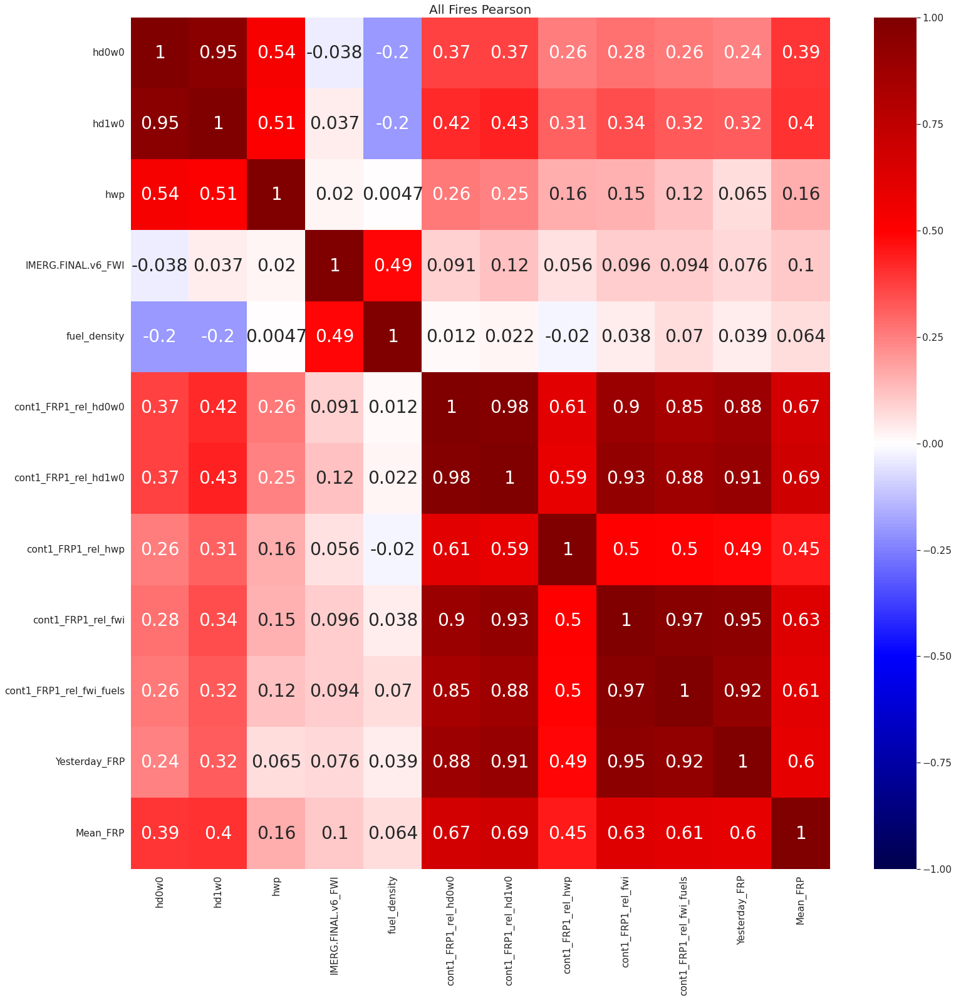

AUGUST COMPLEX


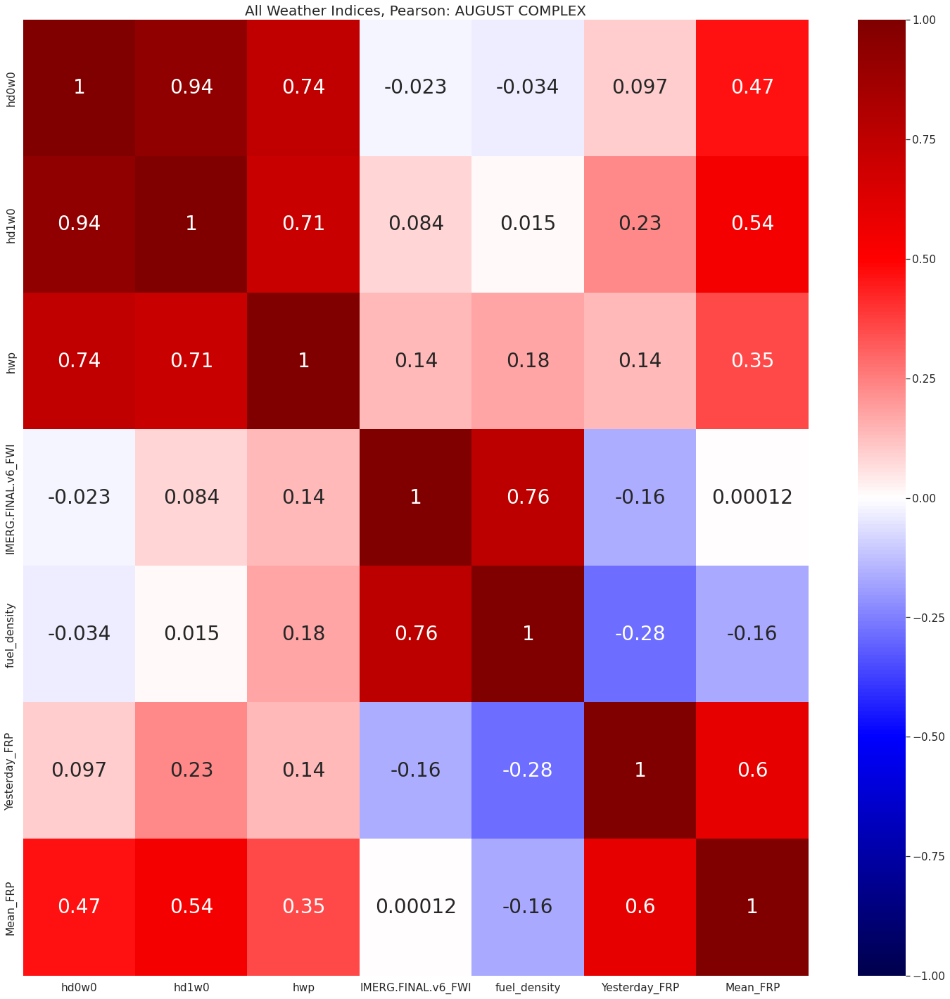

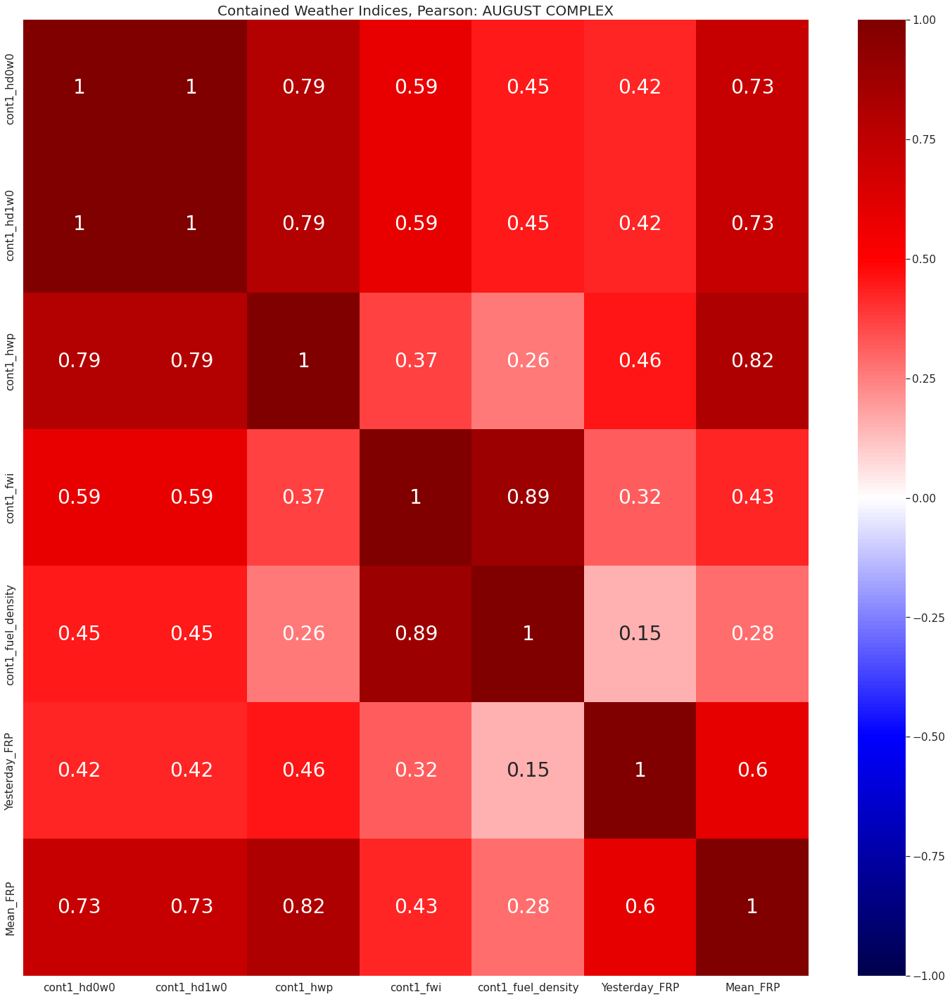

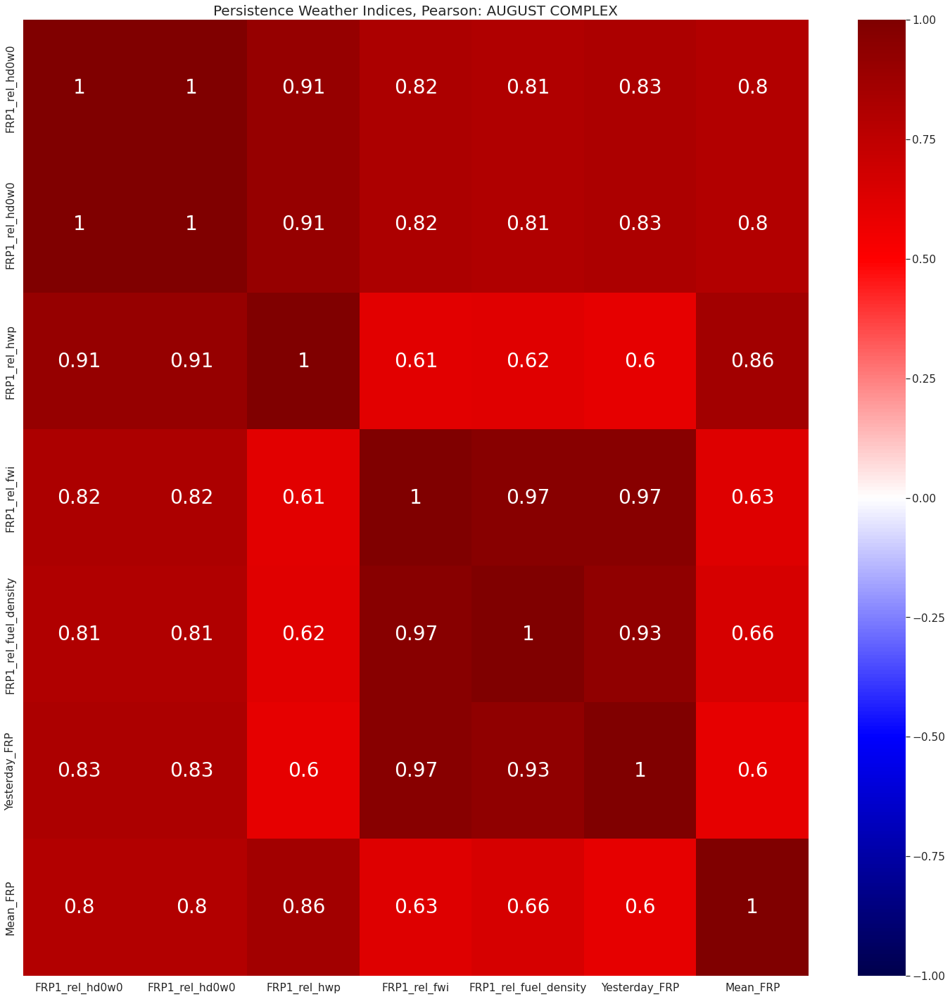

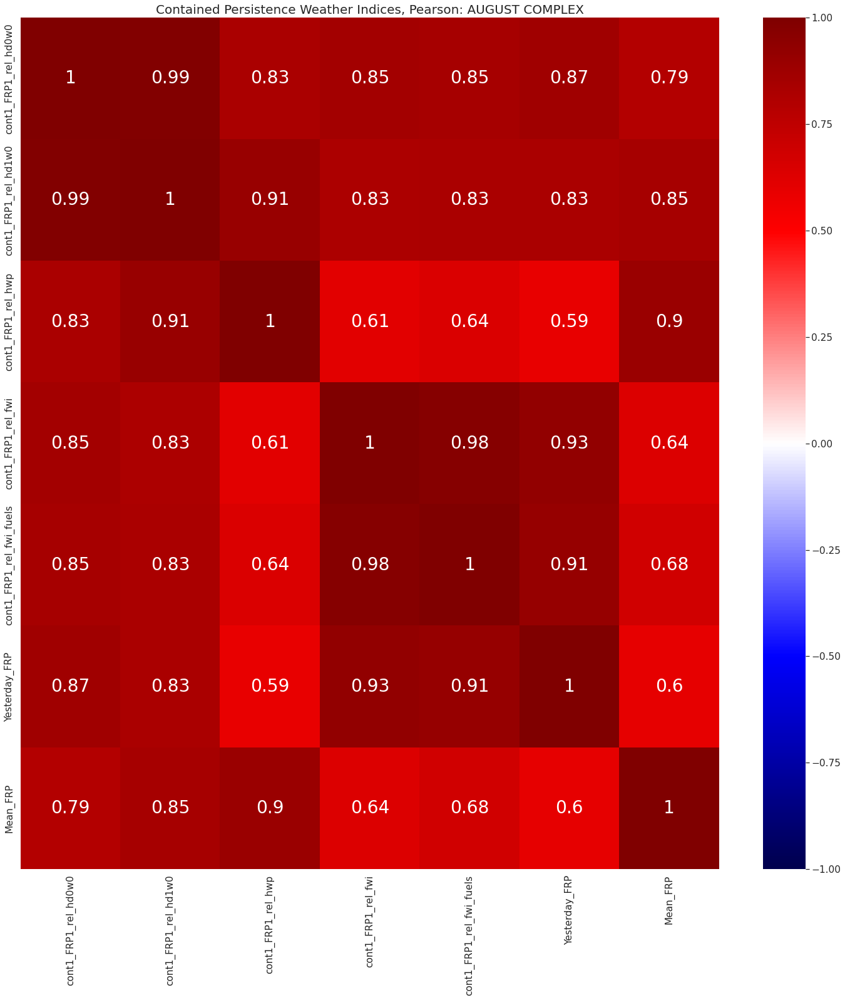

BOBCAT


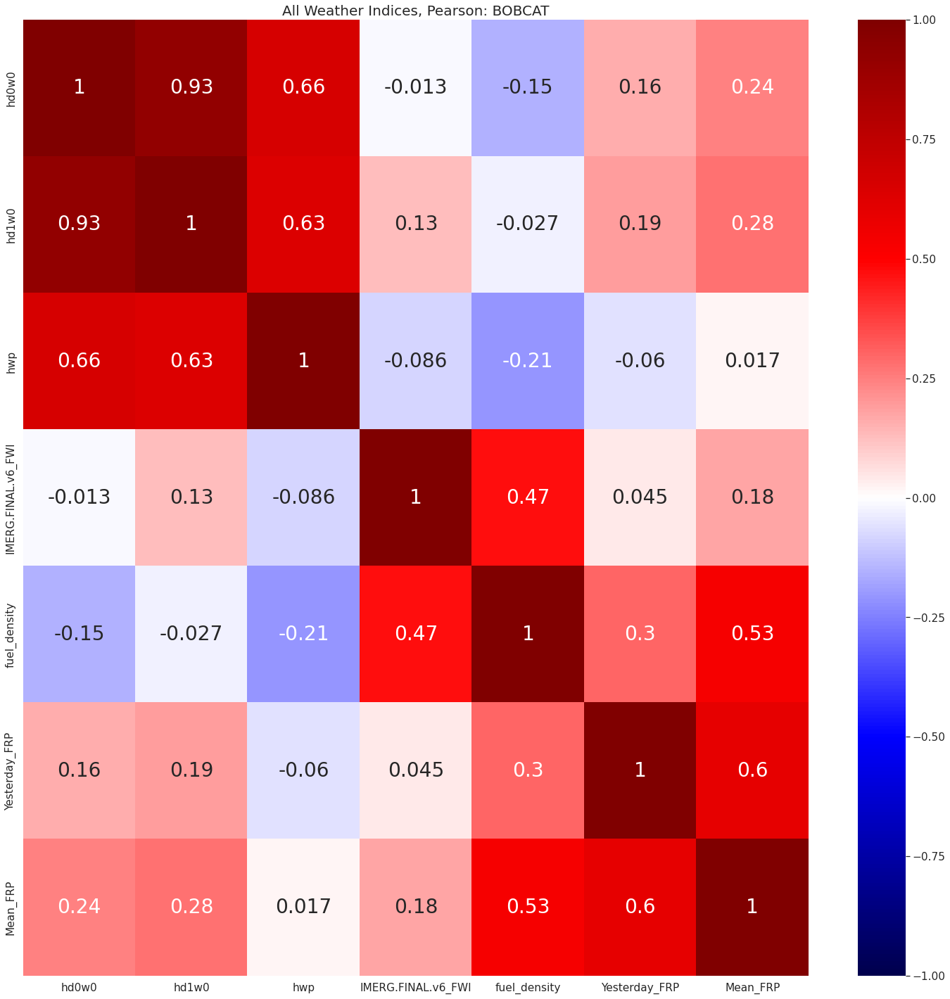

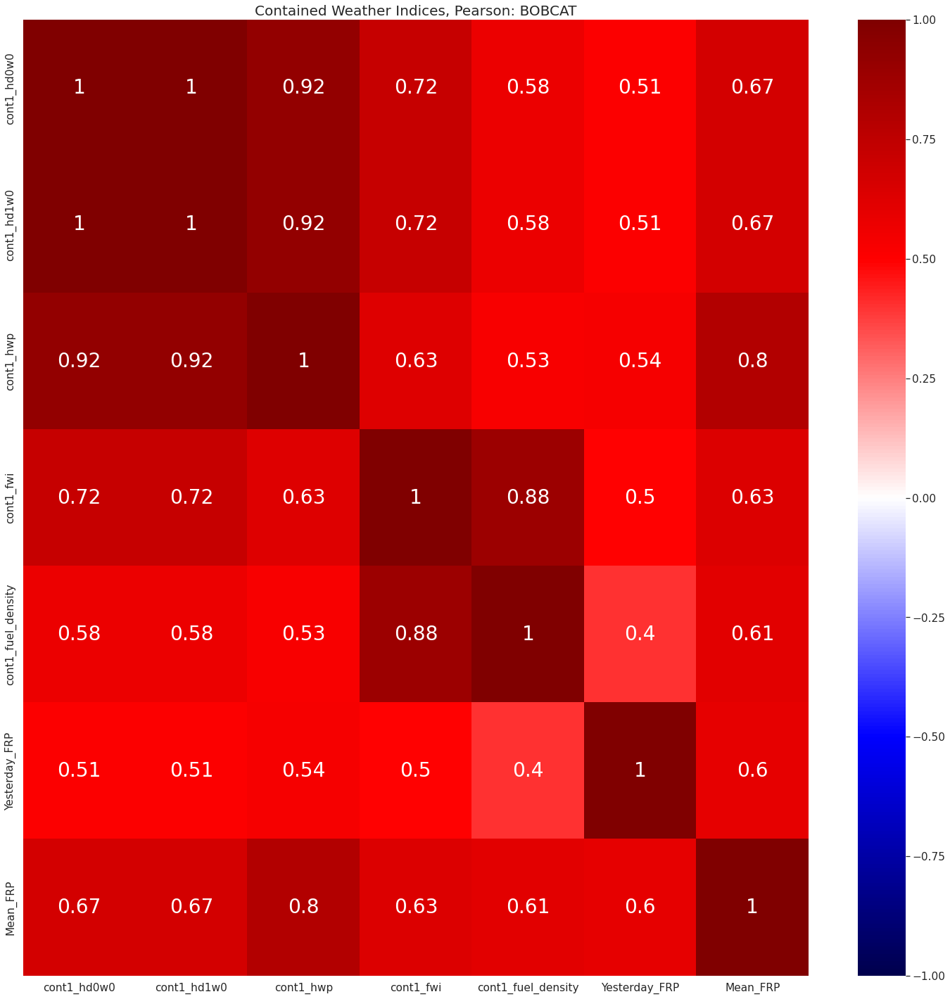

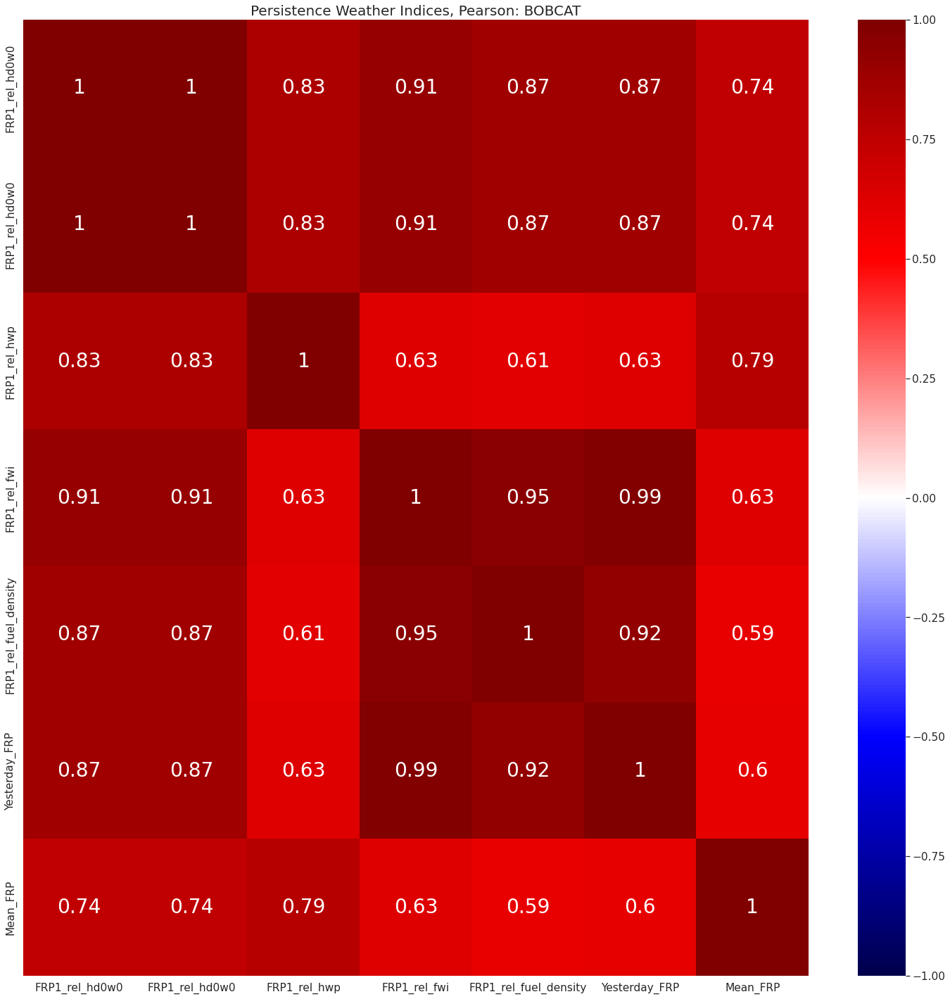

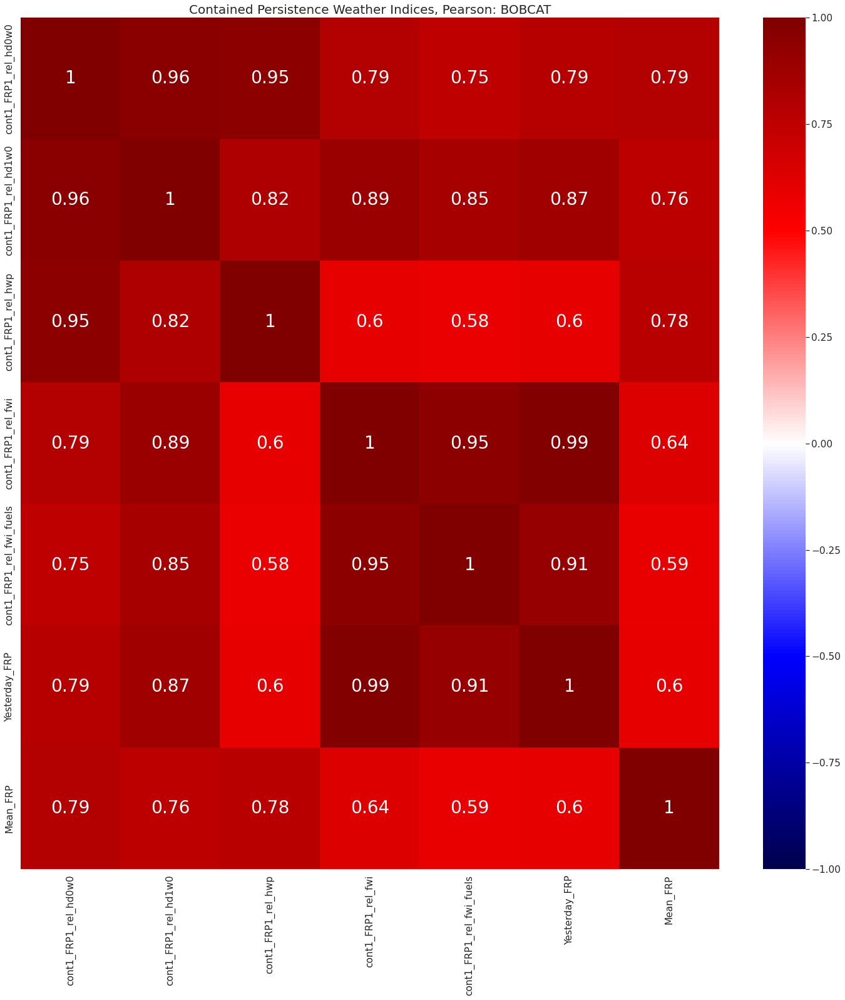

CREEK


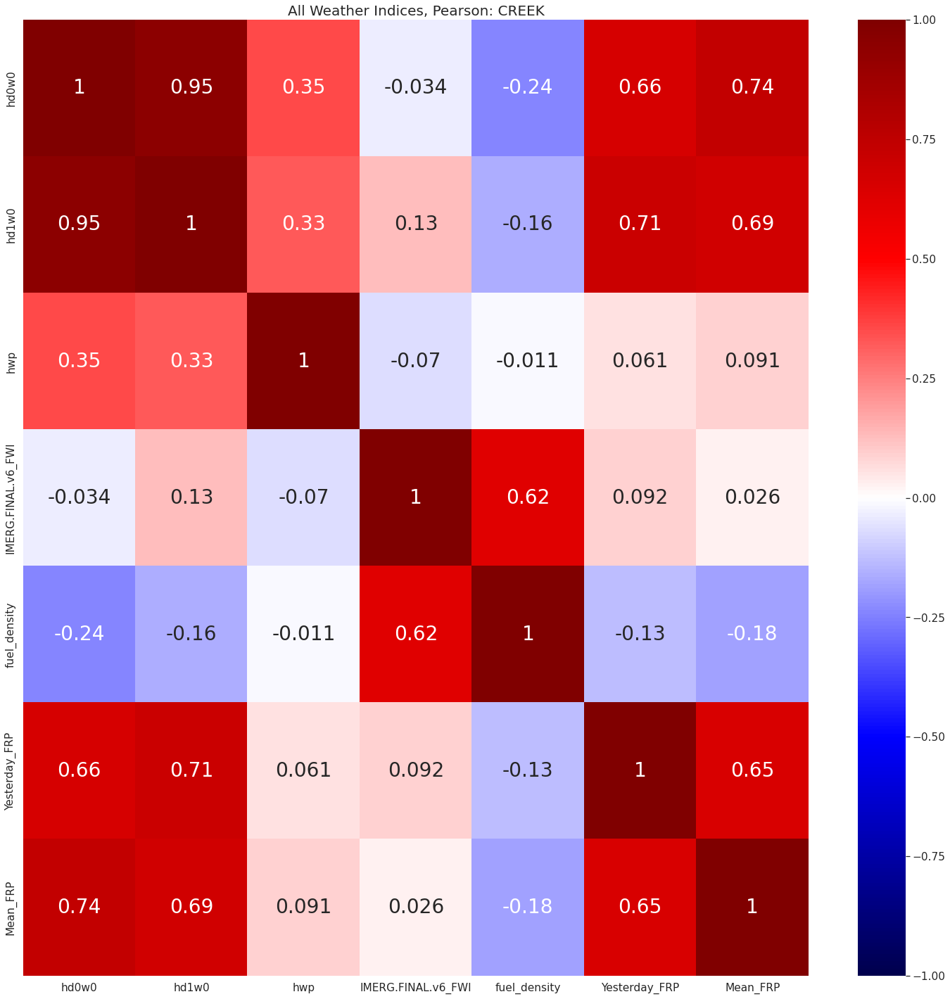

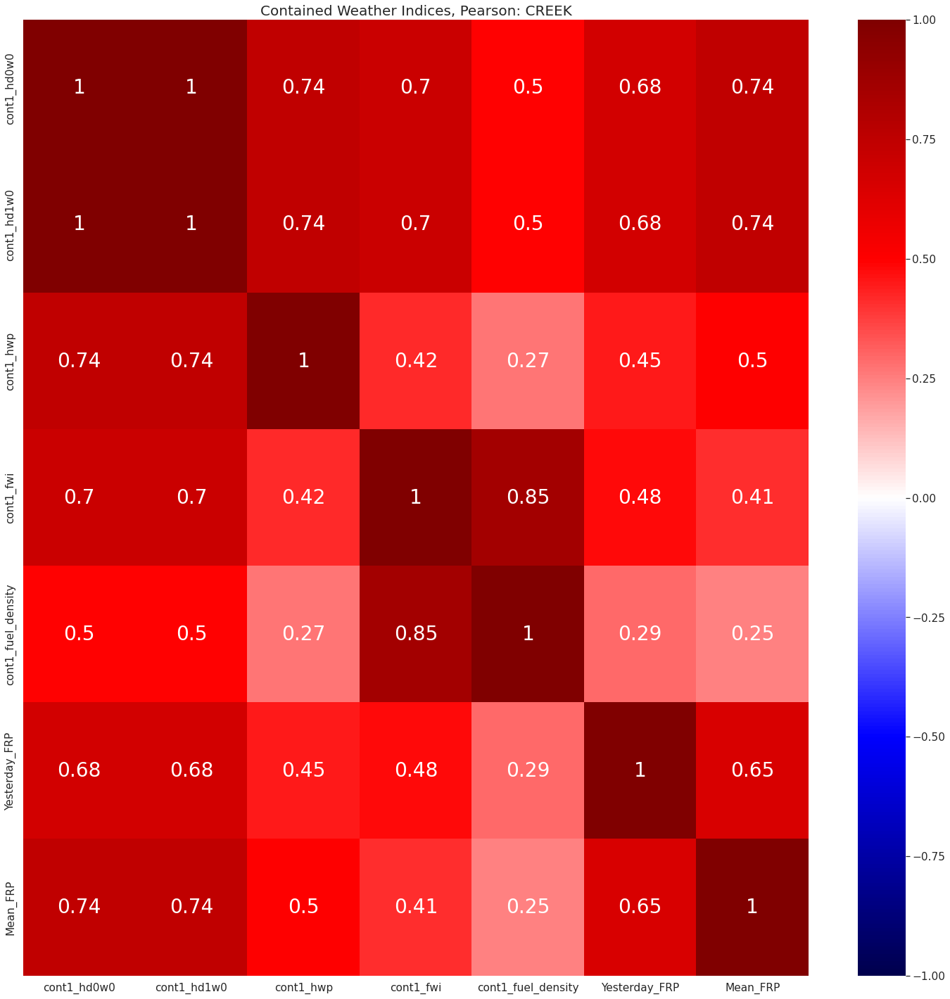

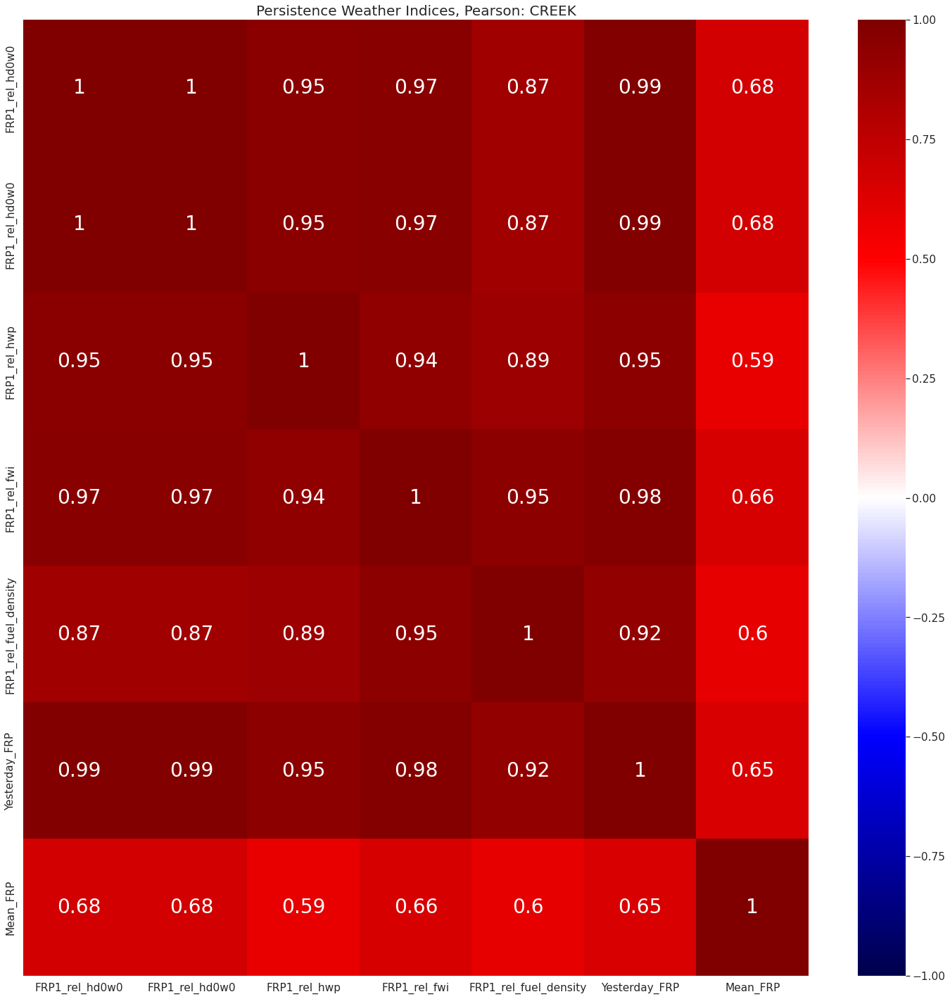

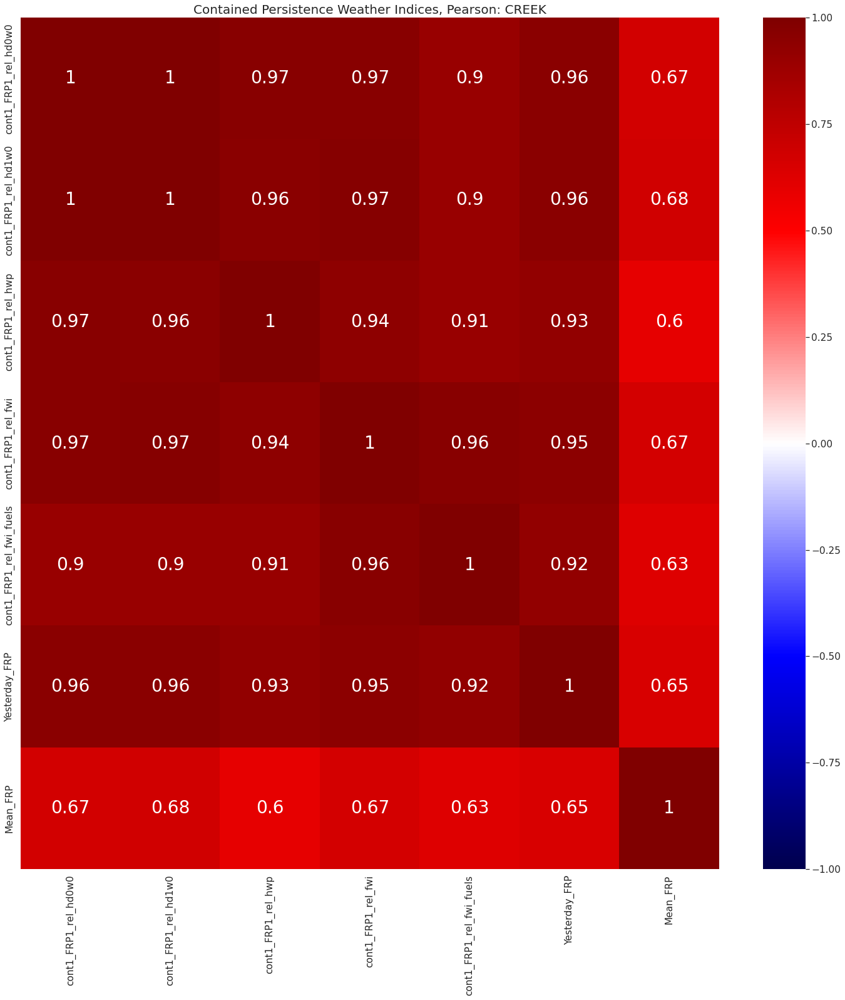

DOLAN


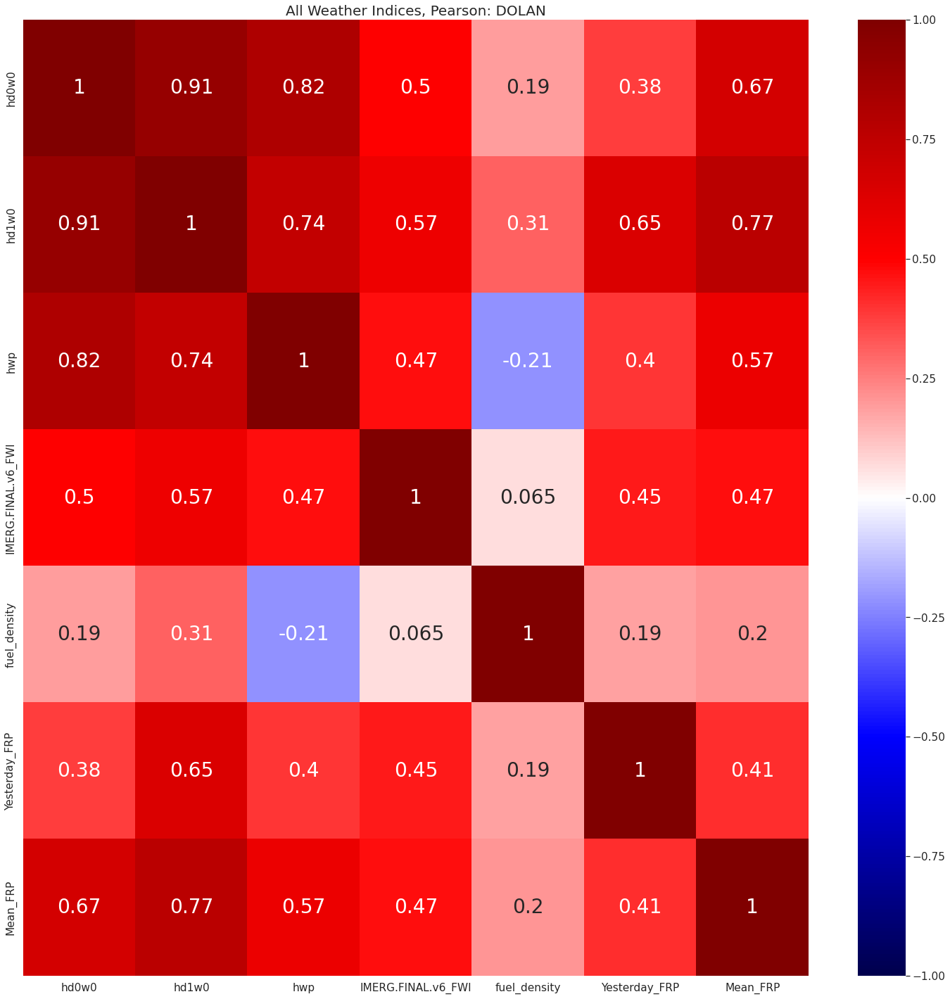

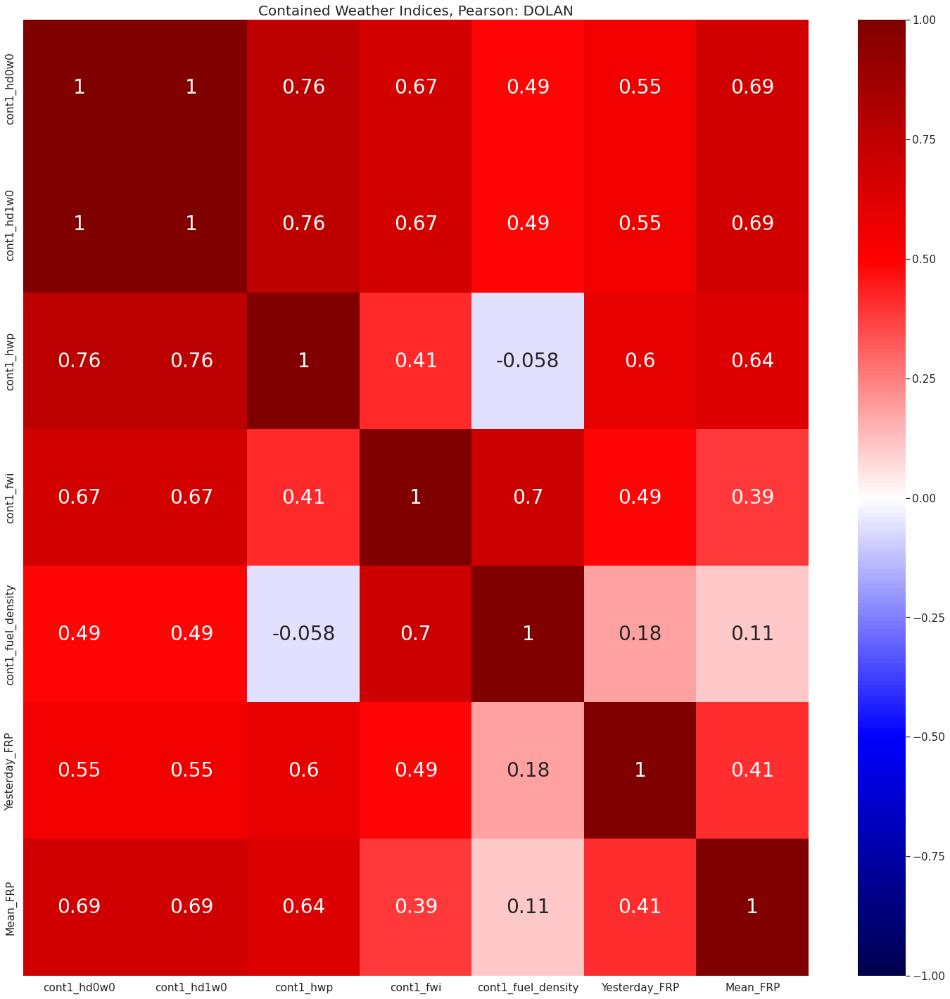

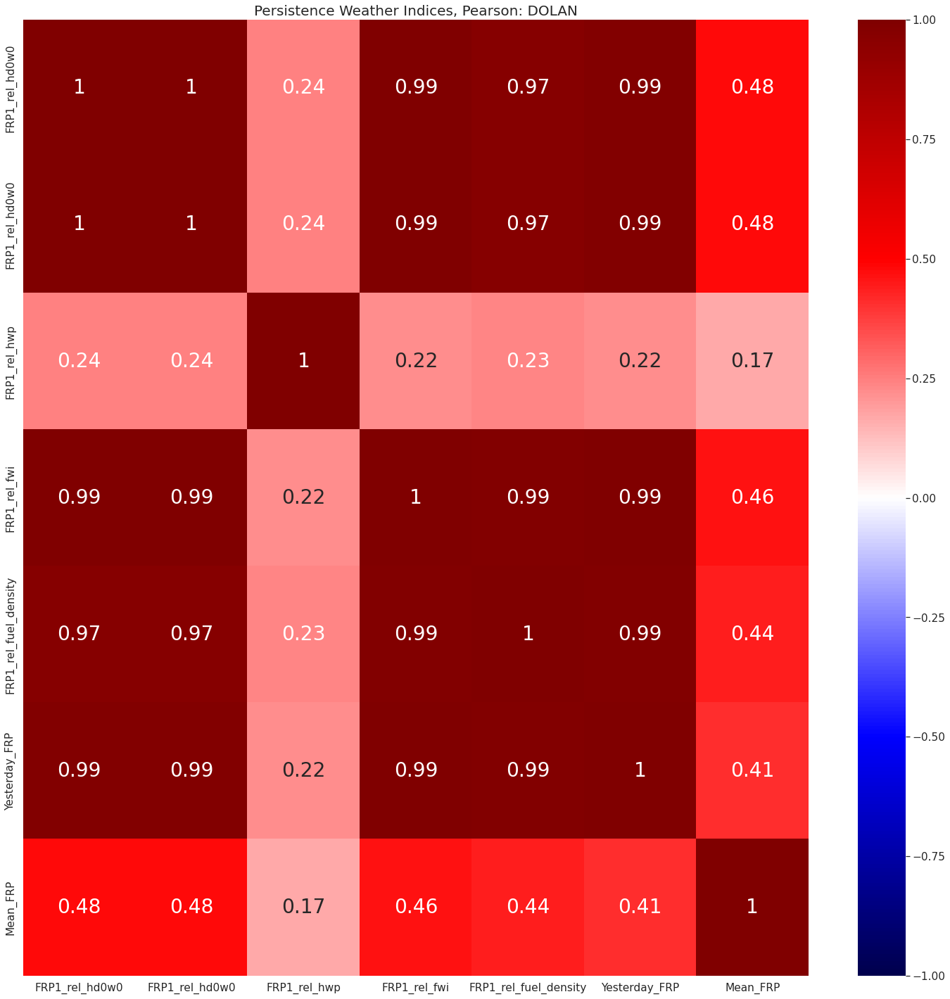

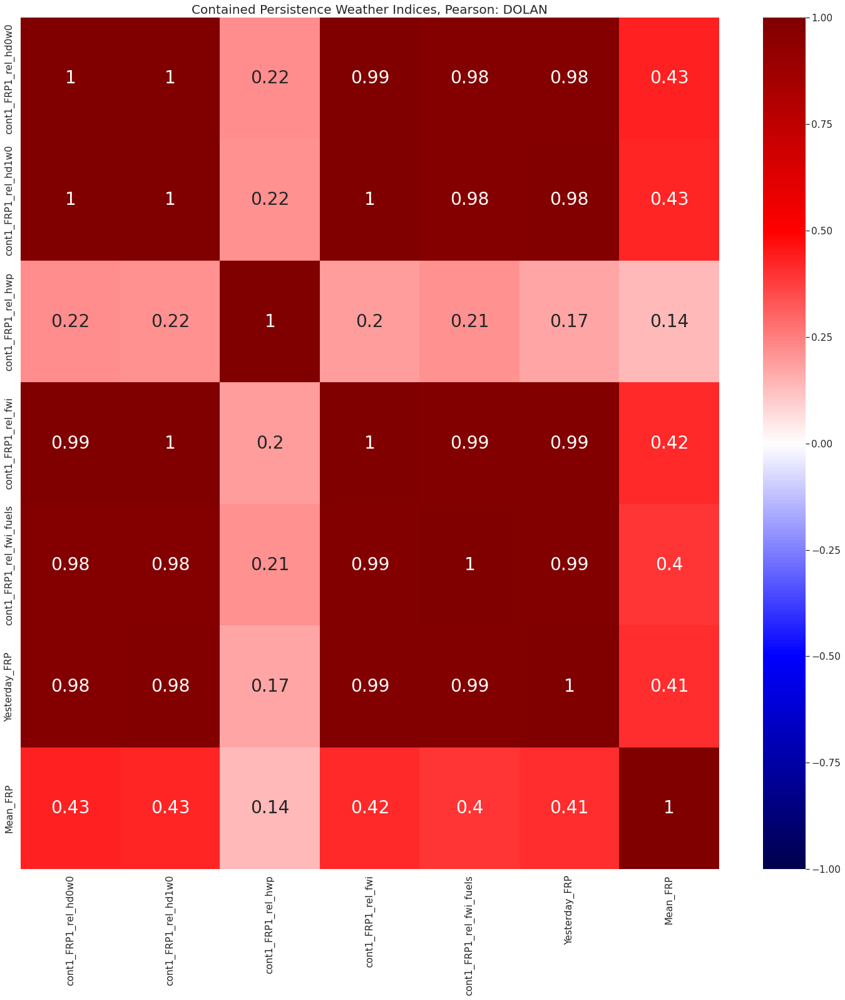

LAKE


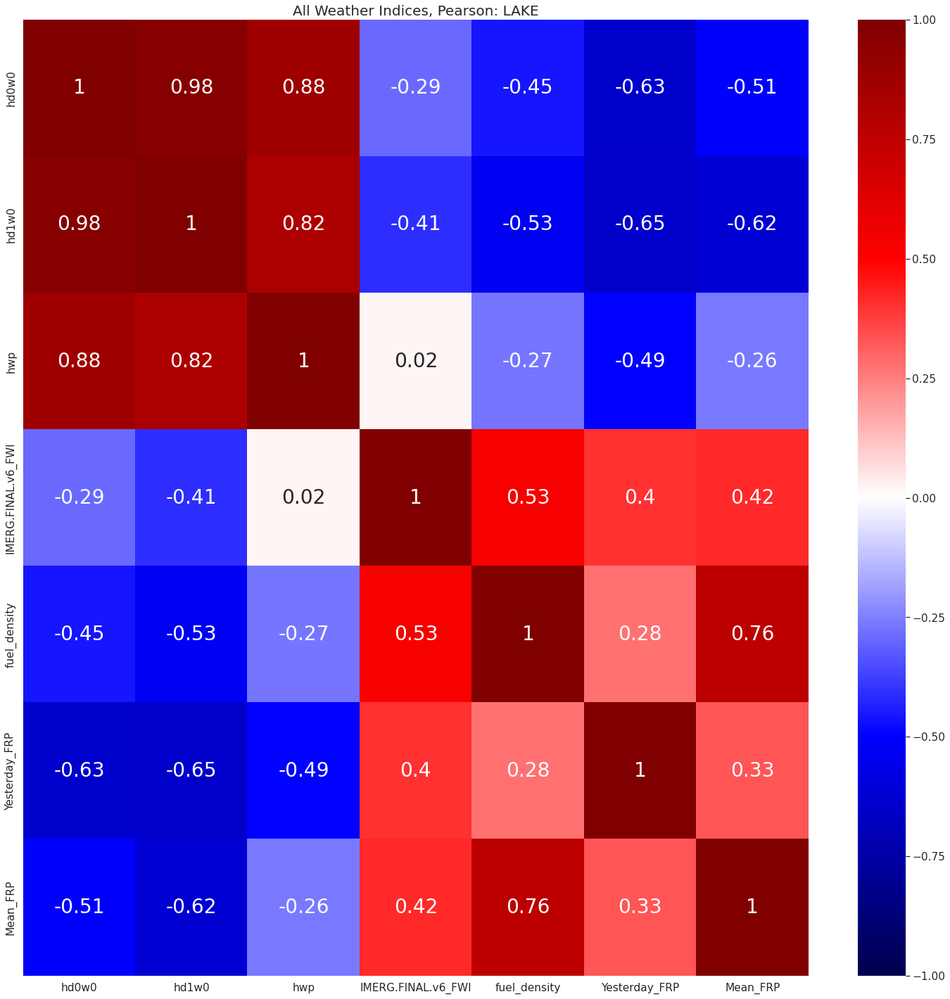

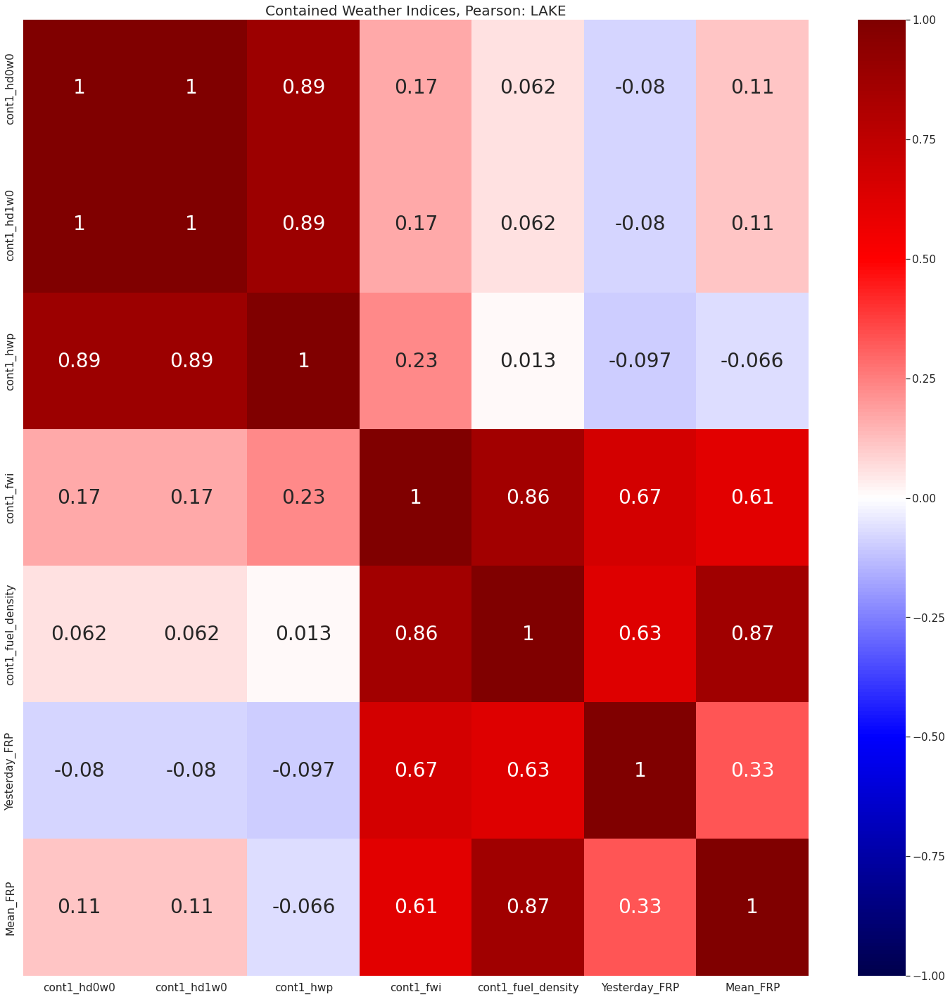

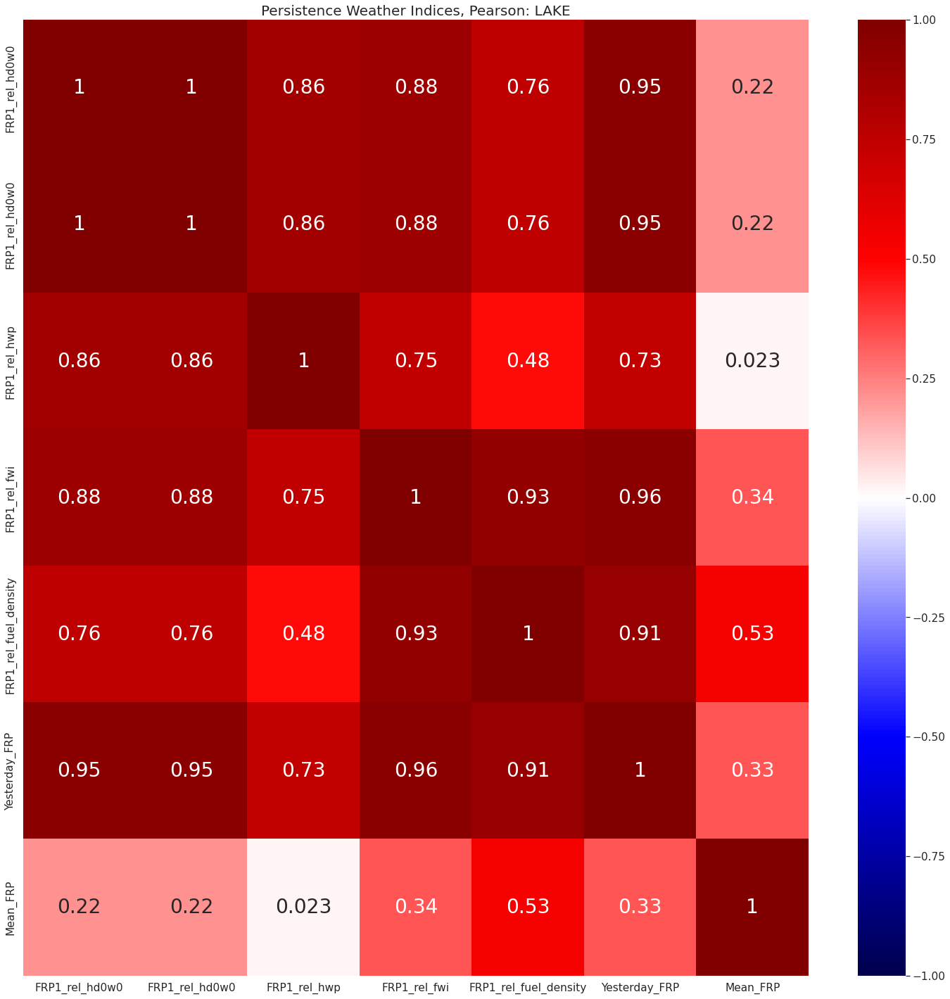

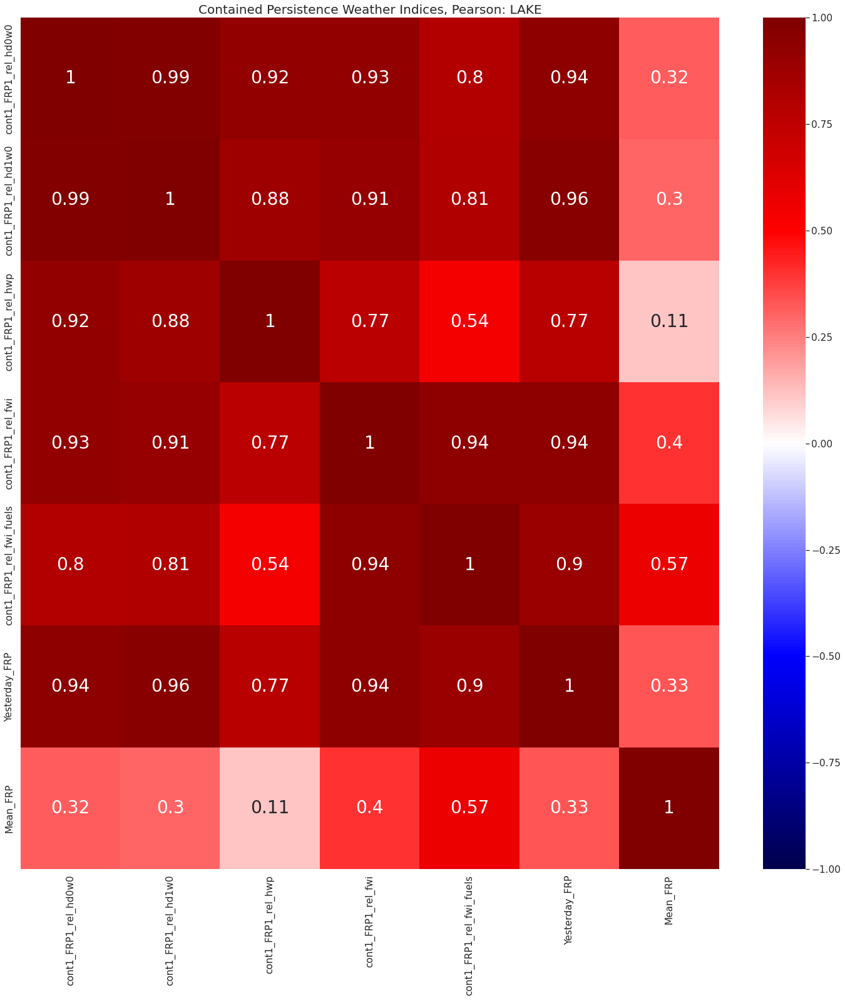

In [106]:
# correlations plot of all fires, comparing different weather indices
vars_corr = ['hd0w0','hd1w0','hwp','IMERG.FINAL.v6_FWI','fuel_density','cont1_FRP1_rel_hd0w0',
             'cont1_FRP1_rel_hd1w0','cont1_FRP1_rel_hwp',
             'cont1_FRP1_rel_fwi','cont1_FRP1_rel_fwi_fuels',
             'Yesterday_FRP','Mean_FRP']
vars_indices = ['hd0w0','hd1w0','hwp','IMERG.FINAL.v6_FWI','fuel_density','Yesterday_FRP','Mean_FRP']
vars_containment = ['cont1_hd0w0', 'cont1_hd1w0','cont1_hwp', 'cont1_fwi', 'cont1_fuel_density','Yesterday_FRP','Mean_FRP']
vars_persistence = ['FRP1_rel_hd0w0', 'FRP1_rel_hd0w0', 'FRP1_rel_hwp','FRP1_rel_fwi', 'FRP1_rel_fuel_density','Yesterday_FRP','Mean_FRP']
vars_contained_persistence= ['cont1_FRP1_rel_hd0w0','cont1_FRP1_rel_hd1w0','cont1_FRP1_rel_hwp',
                             'cont1_FRP1_rel_fwi','cont1_FRP1_rel_fwi_fuels','Yesterday_FRP','Mean_FRP']

plot_correlations(df_hrrr[vars_corr], 'All Fires Pearson','pearson')
#plot_correlations(df_hrrr[vars_corr], 'All Fires Spearman','spearman')
#plot_correlations(df_hrrr[vars_corr], 'All Fires Kendall','kendall')

fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    plot_correlations(features_plot[vars_indices], 'All Weather Indices, Pearson: '+fire_incidents[ii],'pearson')
    plot_correlations(features_plot[vars_containment], 'Contained Weather Indices, Pearson: '+fire_incidents[ii],'pearson')
    plot_correlations(features_plot[vars_persistence], 'Persistence Weather Indices, Pearson: '+fire_incidents[ii],'pearson')
    plot_correlations(features_plot[vars_contained_persistence], 'Contained Persistence Weather Indices, Pearson: '+fire_incidents[ii],'pearson')

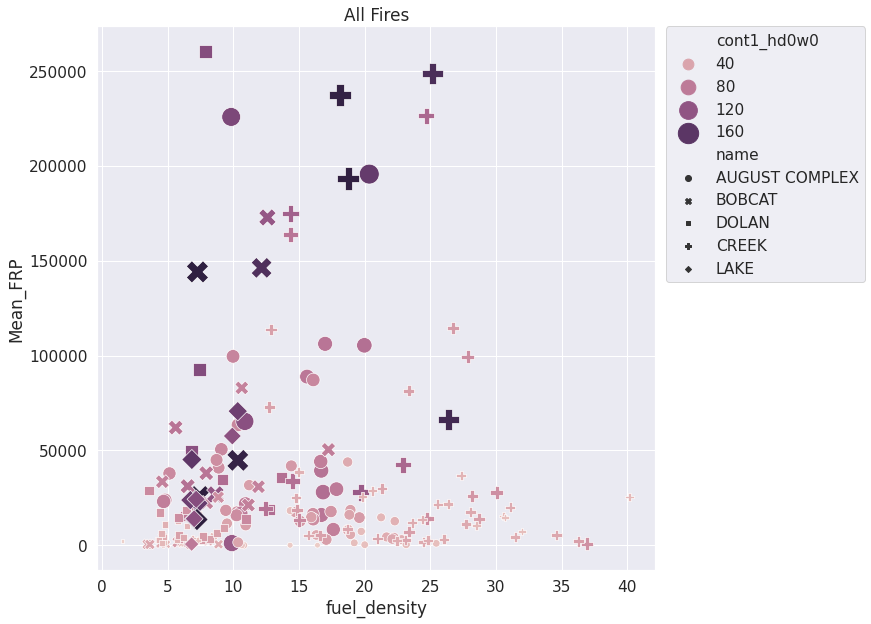

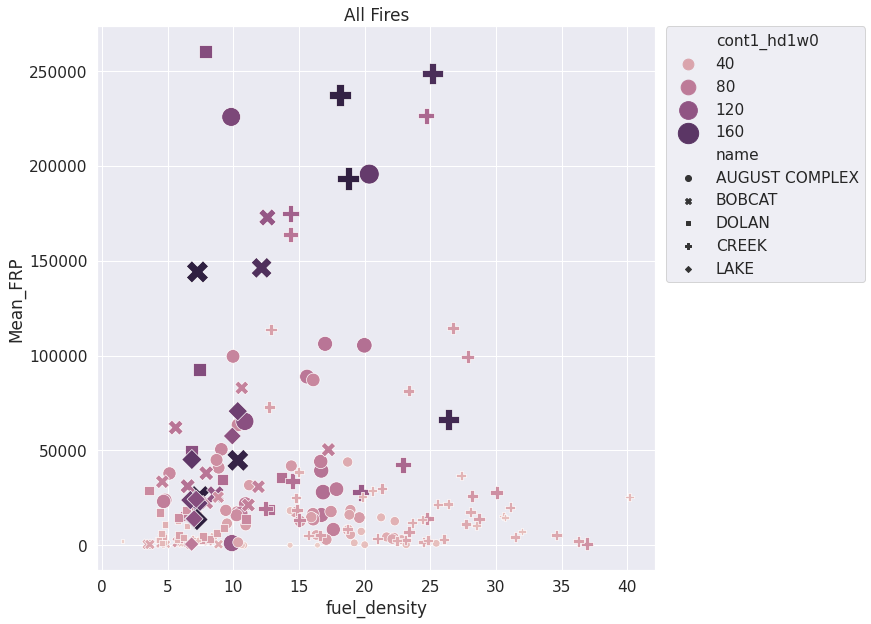

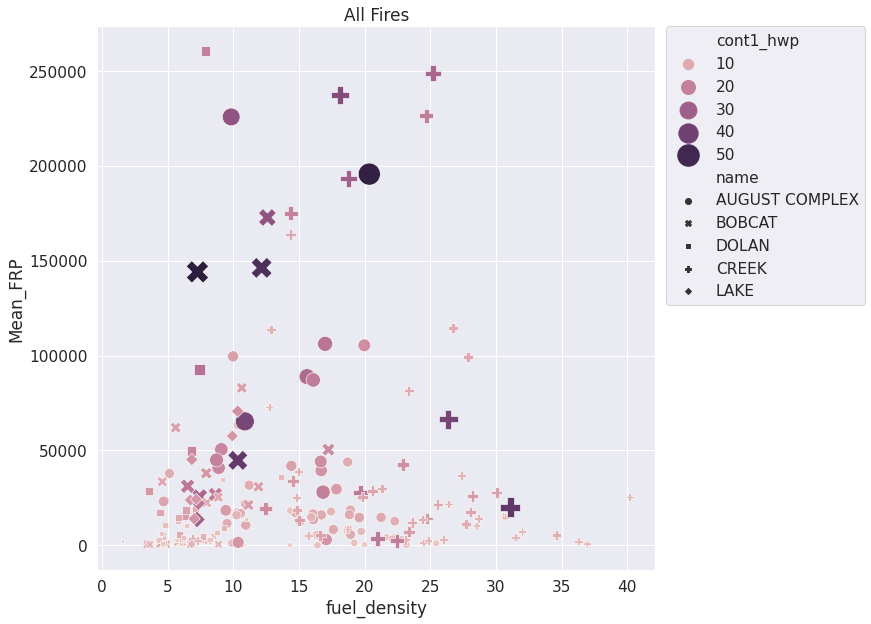

In [87]:
#df_hrrr = df_hrrr[df_hrrr['percent_contained']<50]

scatter_plot(df_hrrr,'fuel_density','Mean_FRP', 'cont1_hd0w0','name', 'cont1_hd0w0', (20,500),'All Fires')
scatter_plot(df_hrrr,'fuel_density','Mean_FRP', 'cont1_hd1w0','name', 'cont1_hd1w0', (20,500),'All Fires')
scatter_plot(df_hrrr,'fuel_density','Mean_FRP', 'cont1_hwp','name', 'cont1_hwp', (20,500),'All Fires')


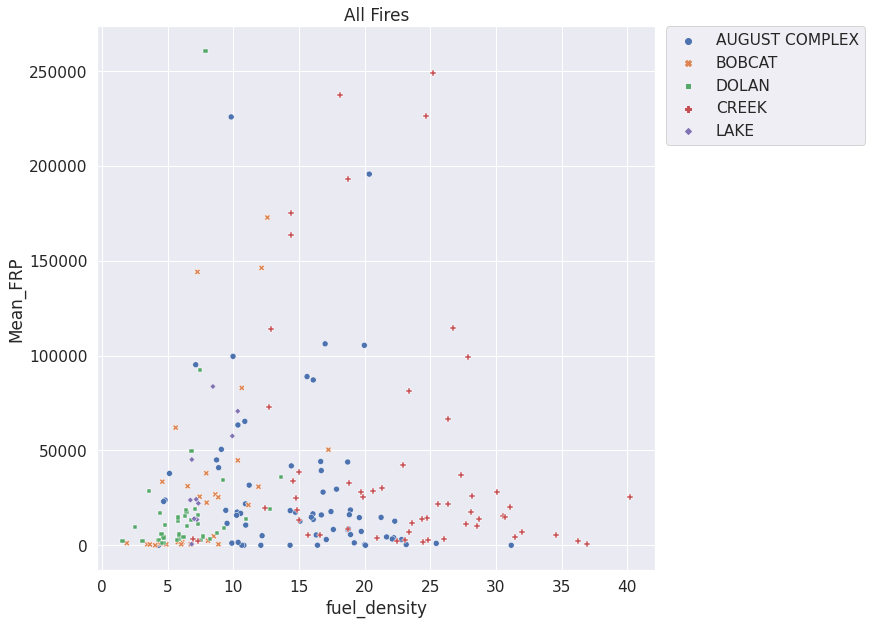

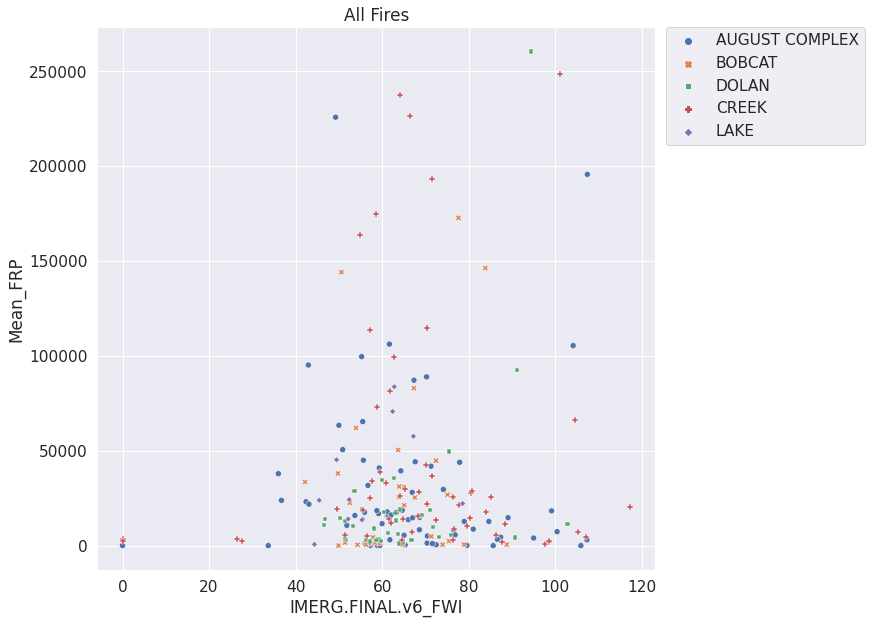

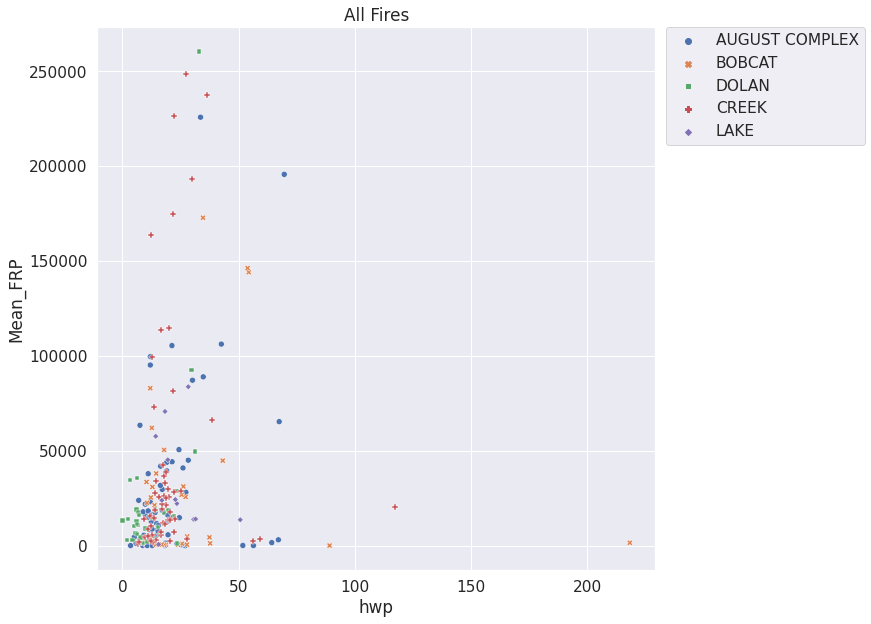

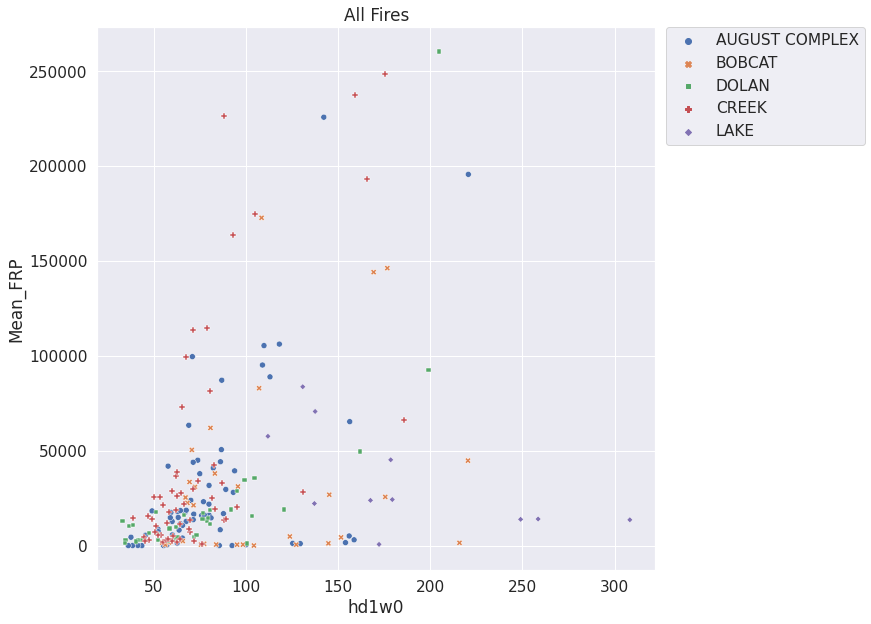

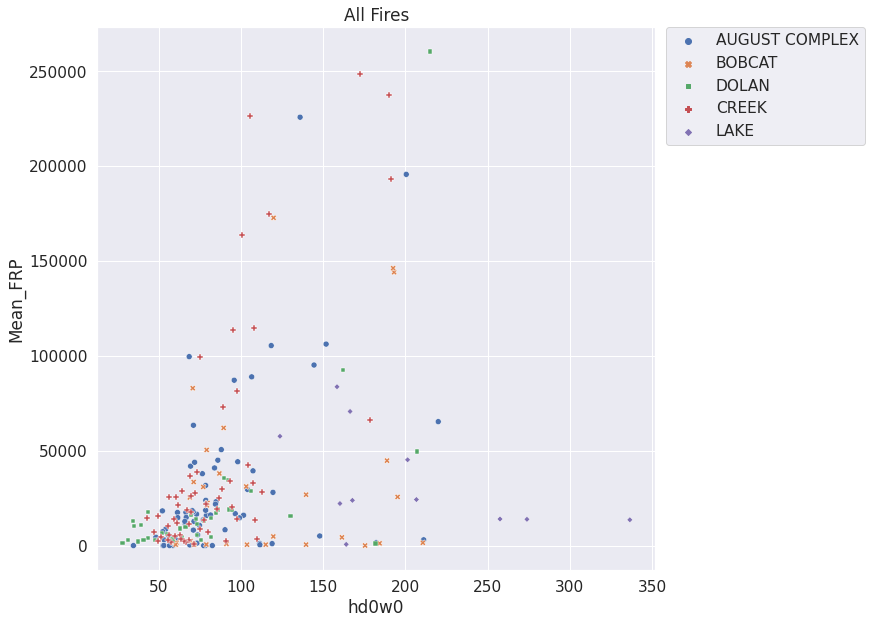

In [89]:
scatter_plot(df_hrrr,'fuel_density','Mean_FRP', 'name','name', None,None,'All Fires')
scatter_plot(df_hrrr,'IMERG.FINAL.v6_FWI','Mean_FRP', 'name','name', None,None,'All Fires')
scatter_plot(df_hrrr,'hwp','Mean_FRP', 'name','name', None,None,'All Fires')
scatter_plot(df_hrrr,'hd1w0','Mean_FRP', 'name','name', None,None,'All Fires')
scatter_plot(df_hrrr,'hd0w0','Mean_FRP', 'name','name', None,None,'All Fires')

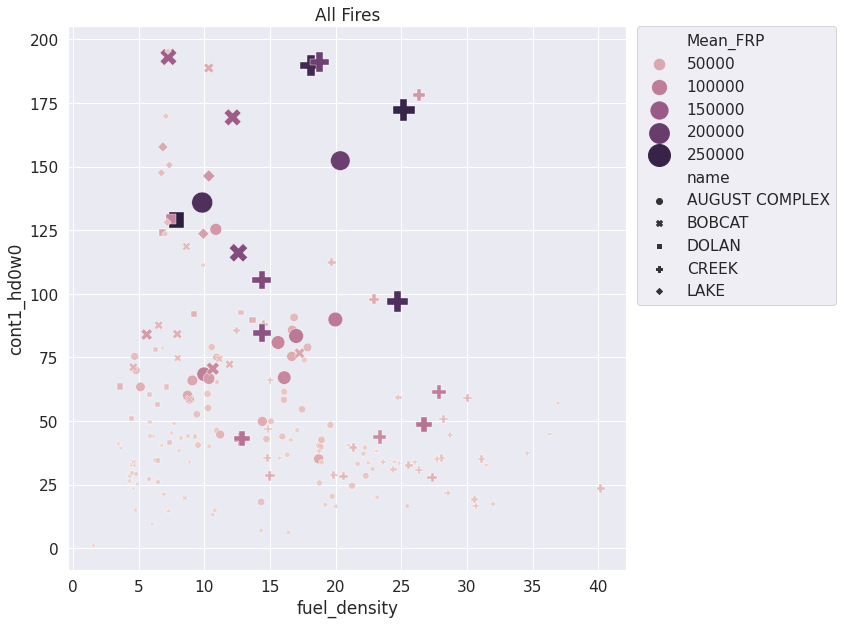

In [88]:
scatter_plot(df_hrrr,'fuel_density','cont1_hd0w0','Mean_FRP','name', 'Mean_FRP', (20,500),'All Fires')


## Feb 6th, Bobcat only

In [37]:
rave_all = pd.DataFrame()
fwi_all = pd.DataFrame()
fuels_fwi_all = pd.DataFrame()
names_all = pd.DataFrame()
days_all = pd.DataFrame()

#fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents =['AUGUST COMPLEX']
fire_incidents = ['BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_FWI_'+str(start_time)+'Z_day_start.csv') #30m
    fuels_300 = pd.read_csv(path_features+file_prefix+'_Daily_COARSE_FUEL_FWI_'+str(start_time)+'Z_day_start.csv') #300m
    fuels_360 = pd.read_csv(path_features+file_prefix+'_Daily_COARSE360_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels_990 = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    
    #calculate the fuel density and amount for the given fire
    fwis = fwi['IMERG.FINAL.v6_FWI'].values.reshape(len(fwi),-1)
    #append FWI values and sort them
    category_midpoints = np.tile([157,83,60.5,42.5,16.5],len(fwis)).reshape(len(fwis),-1)
    to_sort = np.append(category_midpoints,fwis,axis=1)
    sortedd = np.sort(to_sort,axis=1)

    #get the indices of the columns that we need to average
    column_indices = np.array([np.where(sortedd[kk,:]==fwis[kk]) for kk in range(len(fwis))]).flatten()
    print(column_indices)
    
    
    #make sure the columns are in the right order
    fuels = fuels[['loading_new_low', 'loading_new_moderate','loading_new_high','loading_new_veryhigh','loading_new_extreme']]
    fuels_300 = fuels_300[['Low_N', 'Moderate_N','High_N','VeryHigh_N','Extreme_N']]
    fuels_360 = fuels_360[['Low_N', 'Moderate_N','High_N','VeryHigh_N','Extreme_N']]
    fuels_990 = fuels_990[['Low_N', 'Moderate_N','High_N','VeryHigh_N','Extreme_N']]
    
    
    
    #initialise a dataframe
    fuel_ave = [(fuels.iloc[jj,column_indices[jj]]+fuels.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]
    fuel_ave_300 = [(fuels_300.iloc[jj,column_indices[jj]]+fuels_300.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]
    fuel_ave_360 = [(fuels_360.iloc[jj,column_indices[jj]]+fuels_360.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]
    fuel_ave_990 = [(fuels_990.iloc[jj,column_indices[jj]]+fuels_990.iloc[jj,column_indices[jj]-1])/2 for jj in range(len(fwis))]

    fuels_fwi = pd.DataFrame()
    fuels_fwi['fuel_density'] = np.array(fuel_ave).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_fwi['fuel_density_300'] = np.array(fuel_ave_300).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_fwi['fuel_density_360'] = np.array(fuel_ave_360).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_fwi['fuel_density_990'] = np.array(fuel_ave_990).flatten() #save fuel density to df_hrrr to plot with the others


    #do the shift
    """rave_shifted = shift_ndays(rave, 1, ['Mean_FRP'], ['Yesterday_FRP'])
    fuels_fwi_shifted = shift_ndays(fuels_fwi,1,
                                    ['fuel_density','fuel_density_300','fuel_density_360','fuel_density_990'],
                                    ['Yesterday_fuel_density','Yesterday_fuel_density_300','Yesterday_fuel_density_360','Yesterday_fuel_density_990']
                                    ) 
    fwi_shifted = snift_ndays(fwi,1, ['IMERG.FINAL.v6_FWI'], ['Yesterday_fwi'])"""
    
    days = pd.DataFrame({'day':np.zeros(len(rave))})
    days['day'] = rave['day'].values
    
    #get the active days
    inds_active = np.where(rave['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave = rave.iloc[inds_active]
    fwi = fwi.iloc[inds_active]
    fuels_fwi= fuels_fwi.iloc[inds_active]
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})

    rave_all = pd.concat([rave_all,rave], axis=0)
    fwi_all = pd.concat([fwi_all,fwi], axis=0)
    fuels_fwi_all = pd.concat([fuels_fwi_all,fuels_fwi], axis=0)
    names_all = pd.concat([names_all,names], axis=0)
    days_all = pd.concat([days_all, days], axis=0)
    
#prepares the HRRR data
features_list = [days_all[['day']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FWI']].reset_index(drop=True),
                fuels_fwi_all.reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                rave_all[['Mean_FRP',]].reset_index(drop=True)]
features = pd.concat(features_list,axis=1)
print(features.columns)
features['FWI_scaled'] = features['IMERG.FINAL.v6_FWI']/5

bobcat
[2 3 3 3 2 1 2 3 3 2 2 3 3 4 3 3 3 2 2 3 4 3 2 2 2 3 3 2 3 3 3 3 2 3 3 2 2
 2]
Index(['day', 'IMERG.FINAL.v6_FWI', 'fuel_density', 'fuel_density_300',
       'fuel_density_360', 'fuel_density_990', 'name', 'Mean_FRP'],
      dtype='object')


BOBCAT


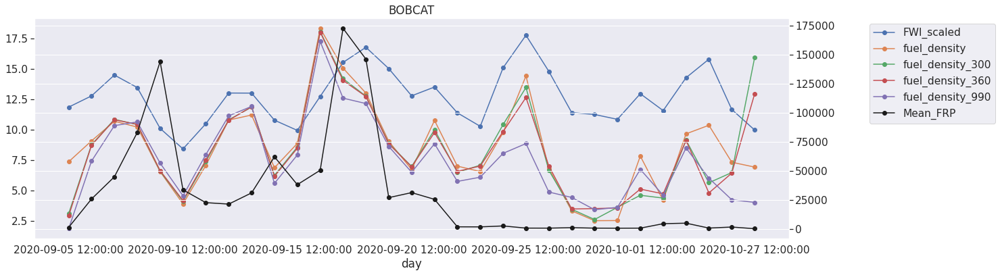

In [41]:
#time series of bobcat, comparing resolutions
fire_incidents = ['BOBCAT'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = features[names_all['name']==fire_incidents[ii]]

    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['FWI_scaled','fuel_density','fuel_density_300','fuel_density_360','fuel_density_990'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(fire_incidents[ii])
    plt.show()

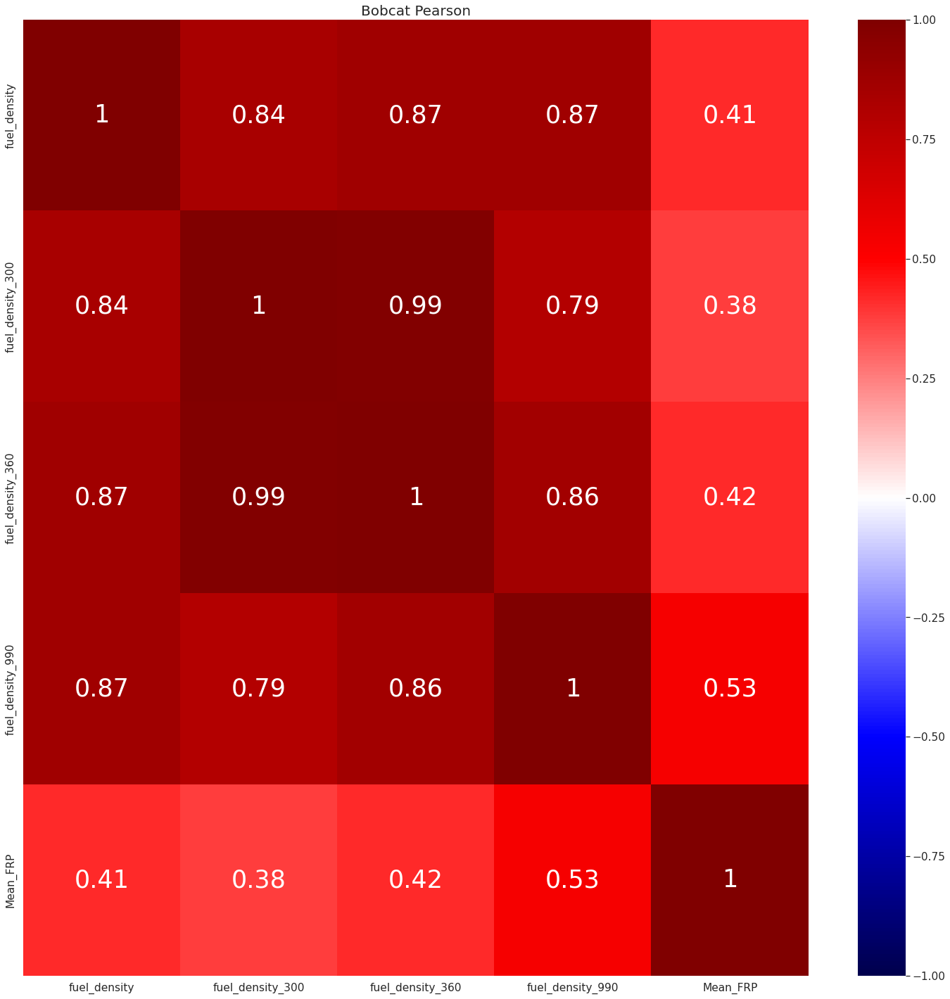

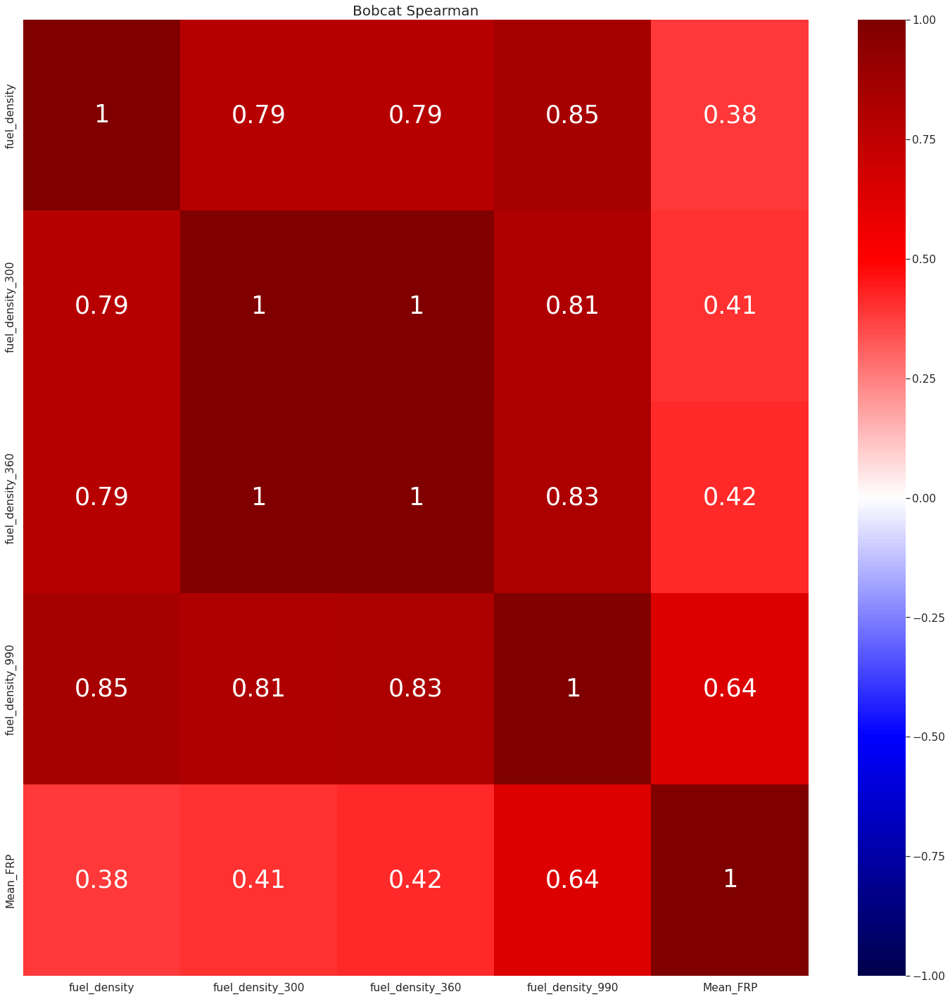

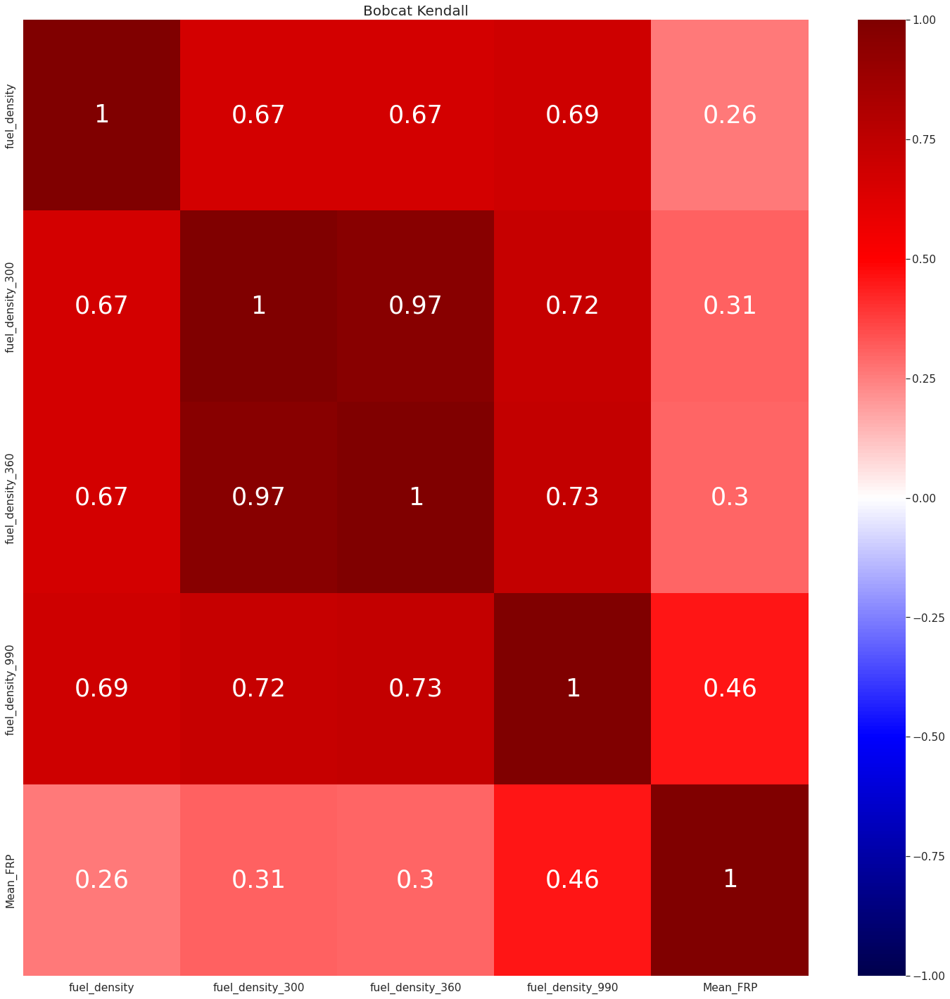

In [39]:
# correlations plot of bobcat, comparing resolutions
vars_corr = ['fuel_density','fuel_density_300','fuel_density_360','fuel_density_990','Mean_FRP']
plot_correlations(features[vars_corr], 'Bobcat Pearson','pearson')
plot_correlations(features[vars_corr], 'Bobcat Spearman','spearman')
plot_correlations(features[vars_corr], 'Bobcat Kendall','kendall')

## Feb 17th Update

In [17]:
#most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
merra_all = pd.DataFrame()
rave_all = pd.DataFrame()
hrrr_ws_all = pd.DataFrame()
esi_all = pd.DataFrame()
pws_all = pd.DataFrame()
igbp_all = pd.DataFrame()
names_all = pd.DataFrame()
resources_all = pd.DataFrame()
fuel_loading_all = pd.DataFrame()
area_all = pd.DataFrame()
fireline_all = pd.DataFrame()
days_all = pd.DataFrame()
fwi_all = pd.DataFrame()
fuels_fwi_all = pd.DataFrame()


fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents =['AUGUST COMPLEX']
#fire_incidents = ['BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
    merra = pd.read_csv(path_features+file_prefix+'_Daily_MERRA_'+str(start_time)+'Z_day_start.csv')
    resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')
    fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels_by_class = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    area = pd.read_csv(path_features+file_prefix+'_Daily_FIRE_AREA_'+str(start_time)+'Z_day_start.csv')
    
    #calculate the fuel density and amount for the given fire
    hd0w0s = hrrr_ws['hd0w0'].values.reshape(len(hrrr_ws),-1)
    hd1w0s = hrrr_ws['hd1w0'].values.reshape(len(hrrr_ws),-1)

    fuels_by_class = fuels_by_class.drop(columns=['Unnamed: 0', 'day'])
    fuels_by_class = fuels_by_class[['Low_N', 'Moderate_N',
                              'High_N','VeryHigh_N',
                              'Extreme_N']]
    print(fuels_by_class.columns)
    #append FWI values and sort them
    category_midpoints = np.tile([630.43,231.37,136.04,79.41,29.32],len(hd0w0s)).reshape(len(hd0w0s),-1)
    to_sort_hd0w0 = np.append(category_midpoints,hd0w0s,axis=1)
    to_sort_hd1w0 = np.append(category_midpoints,hd1w0s,axis=1)

    sorted_hd0w0 = np.sort(to_sort_hd0w0,axis=1)
    sorted_hd1w0 = np.sort(to_sort_hd1w0,axis=1)

    #get the indices of the columns that we need to average
    column_indices_hd0w0 = np.array([np.where(sorted_hd0w0[kk,:]==hd0w0s[kk]) for kk in range(len(hd0w0s))]).flatten()
    column_indices_hd1w0 = np.array([np.where(sorted_hd1w0[kk,:]==hd1w0s[kk]) for kk in range(len(hd1w0s))]).flatten()

    print(column_indices_hd0w0)
    print(column_indices_hd1w0)
    #initialise a dataframe
    fuel_ave_hd0w0 = [(fuels_by_class.iloc[jj,column_indices_hd0w0[jj]]+
                       fuels_by_class.iloc[jj,column_indices_hd0w0[jj]-1])/2 for jj in range(len(hd0w0s))]
    fuel_ave_hd1w0 = [(fuels_by_class.iloc[jj,column_indices_hd1w0[jj]]+
                       fuels_by_class.iloc[jj,column_indices_hd1w0[jj]-1])/2 for jj in range(len(hd1w0s))]
    
    fuels_by_class['fuel_density_hd0w0'] = np.array(fuel_ave_hd0w0).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_by_class['fuel_density_hd1w0'] = np.array(fuel_ave_hd1w0).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_by_class['day'] = rave['day'].values

    #do the shift
    rave_shifted = shift_ndays(rave,1,['Mean_FRP'],['Yesterday_FRP'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws,1,['hd0w0','hd1w0','hwp'],
                                  ['Yesterday_HD0W0','Yesterday_HD1W0','Yesterday_HWP'])
    merra_shifted = shift_ndays(merra, 1,['hd0w0'], ['Yesterday_HD0W0'])
    resources_shifted = shift_ndays(resources, 1,['percent_contained'],['Yesterday_percent_contained'])
    fwi_shifted = shift_ndays(fwi,1,['IMERG.FINAL.v6_FWI'], ['Yesterday_FWI'])
    fuels_fwi_shifted = shift_ndays(fuels_by_class,1,['fuel_density_hd0w0','fuel_density_hd1w0'],
                                                ['Yesterday_fuel_density_hd0w0','Yesterday_fuel_density_hd1w0'])

    
    days = pd.DataFrame({'day':np.zeros(len(resources_shifted))})
    days['day'] = rave['day'].values
    
    #get the active days
    inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave_shifted = rave_shifted.iloc[inds_active]
    hrrr_ws_shifted = hrrr_ws_shifted.iloc[inds_active]
    merra_shifted = merra_shifted.iloc[inds_active]
    resources_shifted = resources_shifted.iloc[inds_active]
    fwi_shifted = fwi_shifted.iloc[inds_active]
    fuels_fwi_shifted = fuels_fwi_shifted.iloc[inds_active]
    
    pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv').iloc[inds_active] 
    igbp = pd.read_csv(path_features+file_prefix+'_Daily_IGBP_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    esi = pd.read_csv(path_features+file_prefix+'_Daily_ESI_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    fuel_loading = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_LOADING_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    
    fireline = pd.read_csv(path_features+file_prefix+'_Daily_FIRELINE_'+
                           str(start_time)+'Z_day_start.csv')
    fireline['yesterday_total_length'] = fireline['total_length'].shift(1)
    fireline=fireline[fireline['day'].isin(days['day'])]
    
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})

    merra_all = pd.concat([merra_all,merra_shifted], axis=0)
    rave_all = pd.concat([rave_all,rave_shifted], axis=0)
    hrrr_ws_all = pd.concat([hrrr_ws_all,hrrr_ws_shifted],axis=0)
    esi_all = pd.concat([esi_all,esi], axis=0)
    pws_all = pd.concat([pws_all,pws], axis=0)
    igbp_all= pd.concat([igbp_all,igbp])
    names_all = pd.concat([names_all,names])
    resources_all = pd.concat([resources_all,resources_shifted])
    fuel_loading_all=pd.concat([fuel_loading_all,fuel_loading])
    area_all = pd.concat([area_all,area])
    days_all = pd.concat([days_all,days])
    fireline_all = pd.concat([fireline_all,fireline])
    fwi_all = pd.concat([fwi_all,fwi_shifted])
    fuels_fwi_all = pd.concat([fuels_fwi_all,fuels_fwi_shifted])
    #cpc_all = pd.concat([cpc_all,cpc], axis=0)
    #imerg_all = pd.concat([imerg_all,imerg], axis=0)

august_complex
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 2 3 2 1 1 1 2 2 1 1 2 2 2 1 1 2 1 1 2 2 2 2 3 2 2 1 1 2 2 2 1 1 1 1 1 1
 1 1 1 1 1 3 3 1 1 2 2 1 1 1 1 1 1 1 1 1 1 1 1 3 3 2 2 1 2 1 1 1 1]
[3 2 2 3 1 1 1 1 2 1 1 2 2 2 1 1 2 1 1 2 2 2 2 3 2 2 1 1 2 2 1 1 1 1 1 1 1
 1 1 1 1 1 3 2 2 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 3 3 2 2 1 2 2 2 1 1]
bobcat
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 3 3 1 3 1 2 1 1 2 2 1 2 3 3 2 1 1 1 1 1 1 2 2 2 2 3 3 2 1 2 1 2 2 1 3 3
 1]
[3 3 3 2 3 1 1 1 1 2 2 1 2 3 3 2 1 1 1 1 1 1 1 2 2 2 2 3 2 2 1 1 1 2 1 3 2
 1]
dolan
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[1 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 3 3 3 2 2 1 2 1 2 2 1 1 1 1 0 1 1 3
 1 1]
[1 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 3 3 3 2 1 1 2 1 1 2 1 2 1 1 1 1 1 2
 1 1]
creek
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[2 3 3 3 3 2 2 2 2 2 2 2

In [22]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD0W0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FWI','Yesterday_FWI']].reset_index(drop=True),
                fuels_fwi_all[['fuel_density_hd0w0','fuel_density_hd1w0','Yesterday_fuel_density_hd0w0','Yesterday_fuel_density_hd1w0']].reset_index(drop=True),
                pws_all[['PWS']].reset_index(drop=True),
                esi_all[['ESI']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                area_all[['fire area (ha)','fire area (acre)']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)
print(df_hrrr.columns)
df_hrrr['FWI_scaled'] = df_hrrr['IMERG.FINAL.v6_FWI']/5
df_hrrr['hd0w0_scaled'] = df_hrrr['hd0w0']/5

Index(['day', 'temp_2m', 'vpd_2m', 'wind_speed', 'hd0w0', 'hd1w0',
       'Yesterday_HD0W0', 'Yesterday_HD1W0', 'hd2w0', 'hd3w0', 'hd4w0',
       'hd5w0', 'hwp', 'Yesterday_HWP', 'IMERG.FINAL.v6_FWI', 'Yesterday_FWI',
       'fuel_density_hd0w0', 'fuel_density_hd1w0',
       'Yesterday_fuel_density_hd0w0', 'Yesterday_fuel_density_hd1w0', 'PWS',
       'ESI', 'name', 'personnel', 'percent_contained',
       'Yesterday_percent_contained', 'fuel_loadings', 'fire area (ha)',
       'fire area (acre)', 'Mean_FRP', 'Yesterday_FRP'],
      dtype='object')


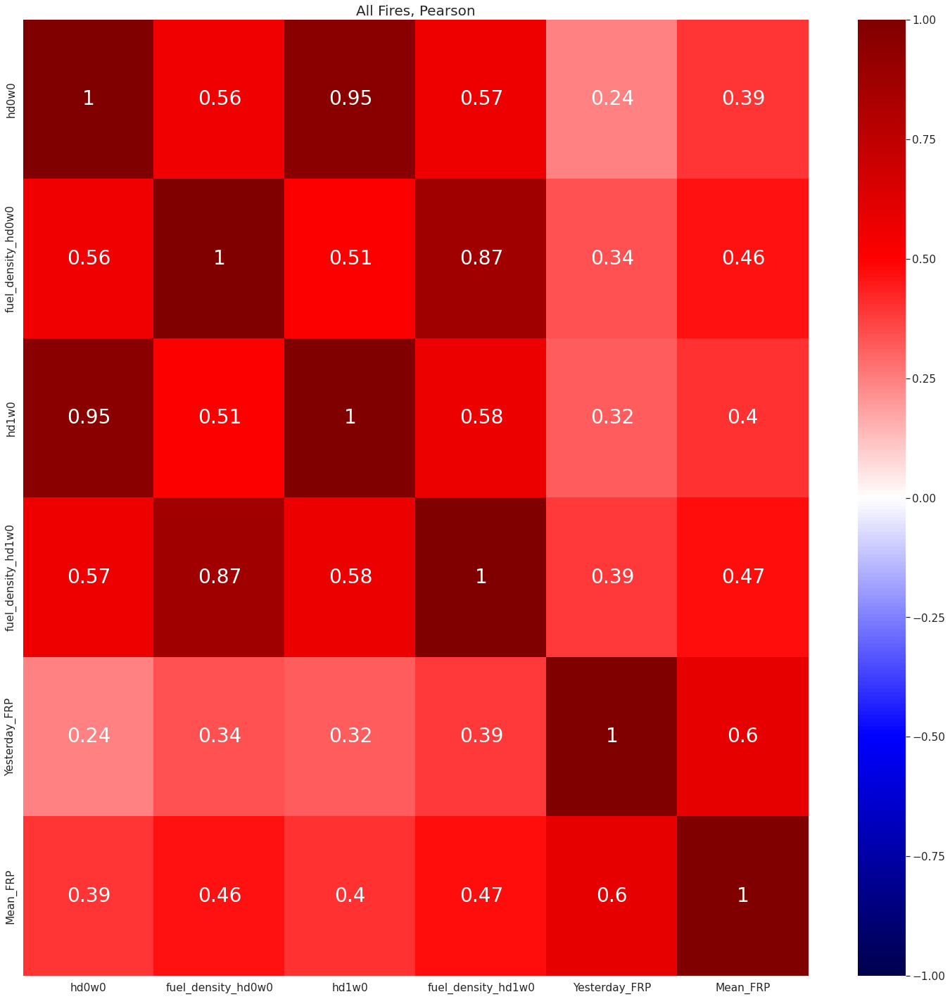

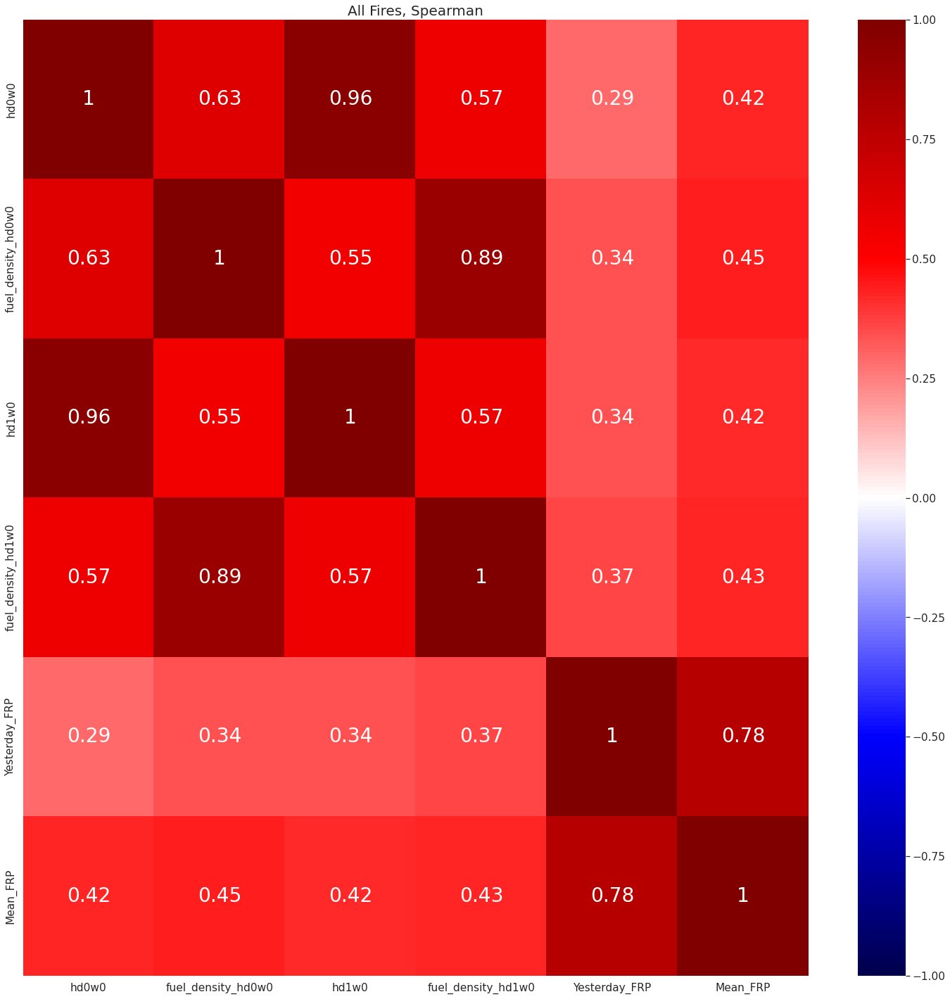

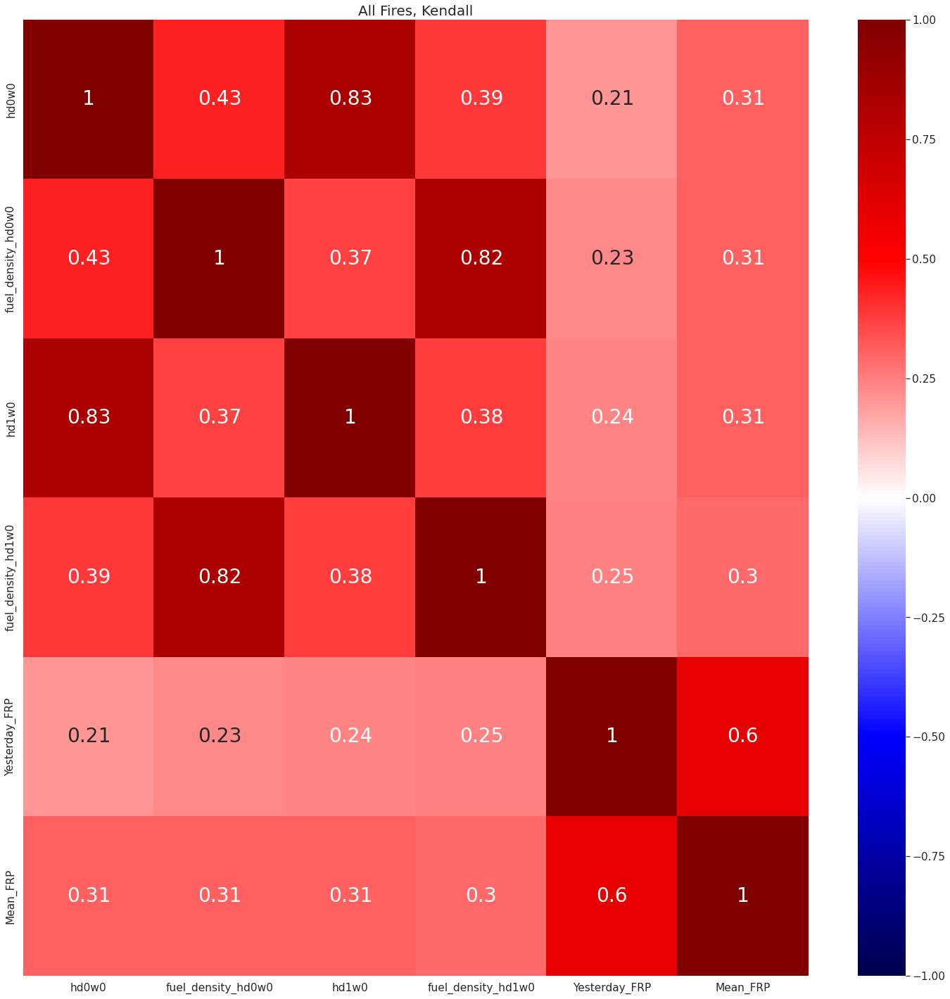

"fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones\nfor ii in range(len(fire_incidents)):\n    print(fire_incidents[ii]) \n    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]\n    plot_correlations(features_plot[vars_corr], \n                      'HD0W0 Features: '+fire_incidents[ii],'pearson')"

In [25]:
vars_corr = ['hd0w0', 'fuel_density_hd0w0','hd1w0','fuel_density_hd1w0','Yesterday_FRP', 'Mean_FRP']

plot_correlations(df_hrrr[vars_corr], 'All Fires, Pearson','pearson')
plot_correlations(df_hrrr[vars_corr], 'All Fires, Spearman','spearman')
plot_correlations(df_hrrr[vars_corr], 'All Fires, Kendall','kendall')

"""fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    plot_correlations(features_plot[vars_corr], 
                      'HD0W0 Features: '+fire_incidents[ii],'pearson')"""

AUGUST COMPLEX


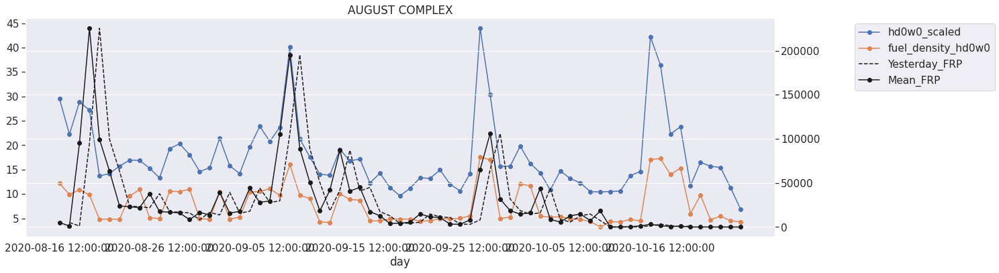

BOBCAT


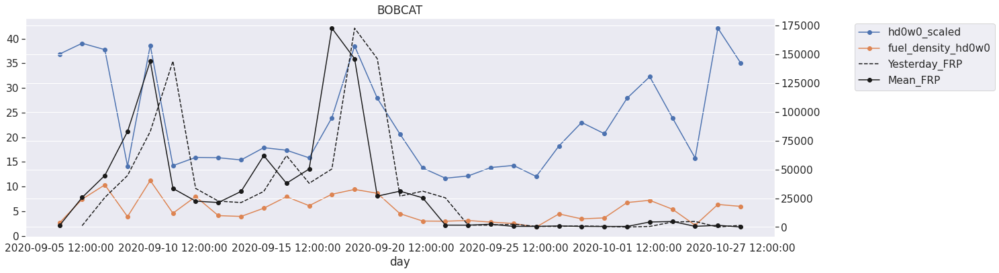

CREEK


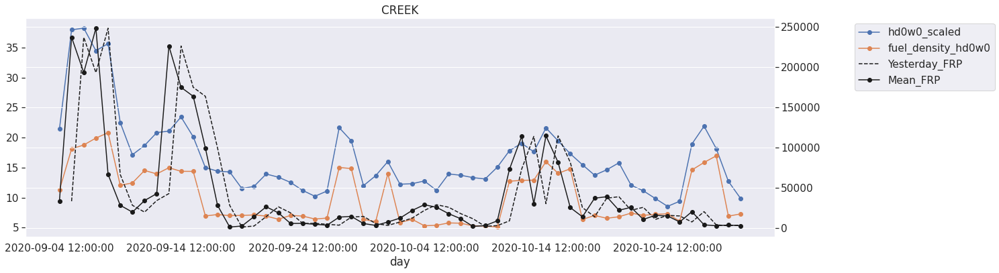

DOLAN


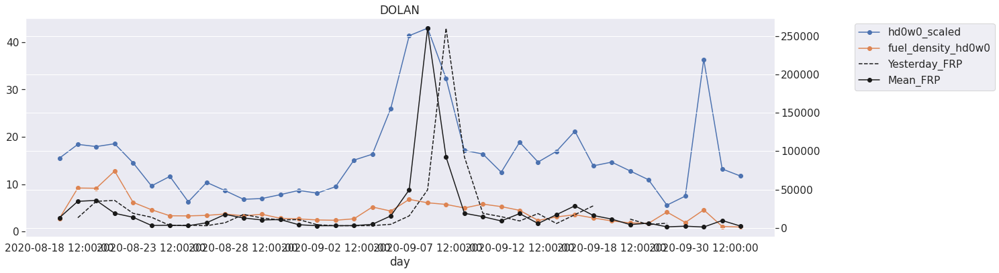

LAKE


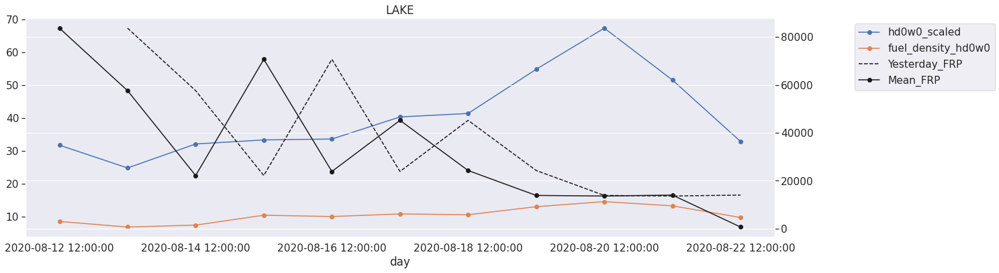

In [24]:
fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['hd0w0_scaled','fuel_density_hd0w0'],
                            figsize=(20,6),style='o-',ax=ax )
    """features_plot.plot(x='day', y=['FRP1_rel_fuel_density', 'cont1_FRP1_rel_fuel_density'],secondary_y=True,
                            figsize=(20,6),style='o-',ax=ax )"""
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                            figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()

## Feb 22nd Update

In [20]:
rave_all = pd.DataFrame()
slopes_all = pd.DataFrame()
names_all = pd.DataFrame()
days_all = pd.DataFrame()

fire_incidents = ['BOBCAT']
path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    slope = pd.read_csv(path_features+file_prefix+'_Daily_slope_30m_'+str(start_time)+'Z_day_start.csv') #30m
    slope_300 = pd.read_csv(path_features+file_prefix+'_Daily_slope_300m_'+str(start_time)+'Z_day_start.csv') #300m
    slope_360 = pd.read_csv(path_features+file_prefix+'_Daily_slope_360m_'+str(start_time)+'Z_day_start.csv') #360m 
    slope_900 = pd.read_csv(path_features+file_prefix+'_Daily_slope_900m_'+str(start_time)+'Z_day_start.csv') #900m
    slope_990 = pd.read_csv(path_features+file_prefix+'_Daily_slope_990m_'+str(start_time)+'Z_day_start.csv') #990m

    print(slope['slope'].values)
    slopes = pd.DataFrame()
    slopes['slope_30'] = slope['slope'].values #save fuel density to df_hrrr to plot with the others
    slopes['slope_300'] = slope_300['mean_slope'].values #save fuel density to df_hrrr to plot with the others
    slopes['slope_360'] = slope_360['mean_slope'].values #save fuel density to df_hrrr to plot with the others
    slopes['slope_900'] = slope_900['mean_slope'].values #save fuel density to df_hrrr to plot with the others
    slopes['slope_990'] = slope_990['mean_slope'].values #save fuel density to df_hrrr to plot with the others

    
    days = pd.DataFrame({'day':np.zeros(len(rave))})
    days['day'] = rave['day'].values
    
    ##get the active days
    inds_active = np.where(rave['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave = rave.iloc[inds_active]
    slopes = slopes.iloc[inds_active]
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(days)})

    rave_all = pd.concat([rave_all,rave], axis=0)
    slopes_all = pd.concat([slopes_all,slopes], axis=0)
    names_all = pd.concat([names_all,names], axis=0)
    days_all = pd.concat([days_all, days], axis=0)
    
#prepares the HRRR data
features_list = [days_all[['day']].reset_index(drop=True),
                slopes_all.reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                rave_all[['Mean_FRP',]].reset_index(drop=True)]
features = pd.concat(features_list,axis=1)
print(features.columns)

bobcat
[18.46706194 28.31104972 31.41502621 27.45499406 30.31001338 29.62414253
 29.17965898 30.05702945 29.34243215 28.31532382 26.99017882 28.97354849
 29.66204326 17.93966345 21.92514225 24.79003773 27.44611471 26.93750664
 27.52113535 26.10424914 22.75154419 24.73300553 24.17152148 22.34060734
 26.33359012 28.10392417 23.97366119 25.75748567 25.81148724 26.06166832
  0.26956952  3.57917669  0.95726535 27.83179969  0.5185207  41.7260413
 43.56800978  1.03126942]
Index(['day', 'slope_30', 'slope_300', 'slope_360', 'slope_900', 'slope_990',
       'name', 'Mean_FRP'],
      dtype='object')


In [21]:
features

,day,slope_30,slope_300,slope_360,slope_900,slope_990,name,Mean_FRP
0,2020-09-05 12:00:00,18.467062,24.687232,25.743152,29.569669,27.607158,BOBCAT,1202.872314
1,2020-09-06 12:00:00,28.311050,28.364094,28.289666,28.139317,28.069812,BOBCAT,25669.430955
2,2020-09-07 12:00:00,31.415026,31.575149,31.544261,31.524477,31.386463,BOBCAT,44778.638988
3,2020-09-08 12:00:00,27.454994,27.889579,28.008369,28.725137,28.921397,BOBCAT,82953.544657
4,2020-09-09 12:00:00,30.310013,30.303965,30.137387,29.130110,29.092192,BOBCAT,144067.180397
5,2020-09-10 12:00:00,29.624143,29.757258,29.713143,30.102817,30.247065,BOBCAT,33536.959880
6,2020-09-11 12:00:00,29.179659,29.267452,29.507311,30.589151,30.646998,BOBCAT,22516.024079
7,2020-09-12 12:00:00,30.057029,29.852013,29.846783,30.034478,29.843494,BOBCAT,21265.910443
8,2020-09-13 12:00:00,29.342432,28.830674,28.805334,28.249810,28.158561,BOBCAT,30919.860823
9,2020-09-14 12:00:00,28.315324,28.122748,28.121490,27.011591,26.948444,BOBCAT,62029.168009


BOBCAT


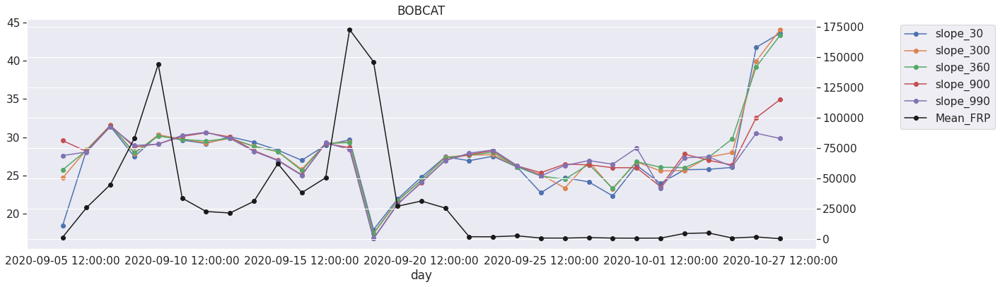

In [22]:
#time series of bobcat, comparing resolutions
fire_incidents = ['BOBCAT'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = features[names_all['name']==fire_incidents[ii]]

    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['slope_30','slope_300','slope_360','slope_900','slope_990'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.title(fire_incidents[ii])
    plt.show()

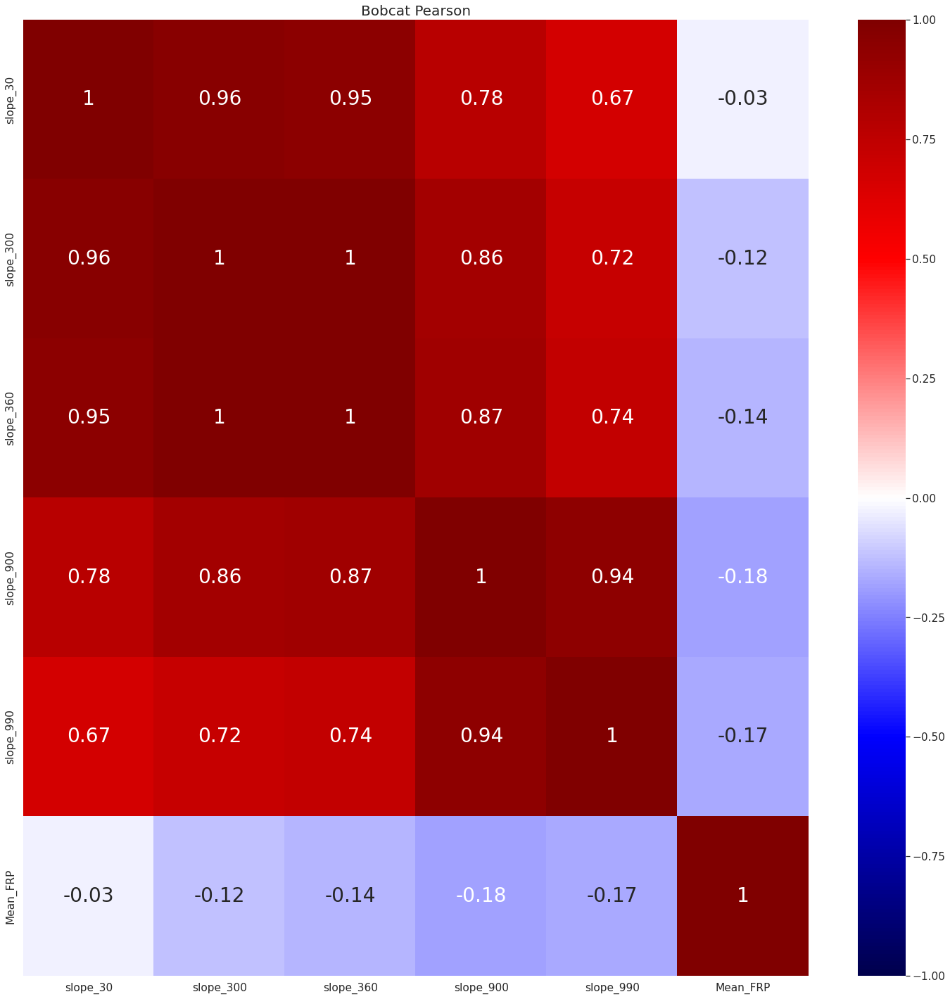

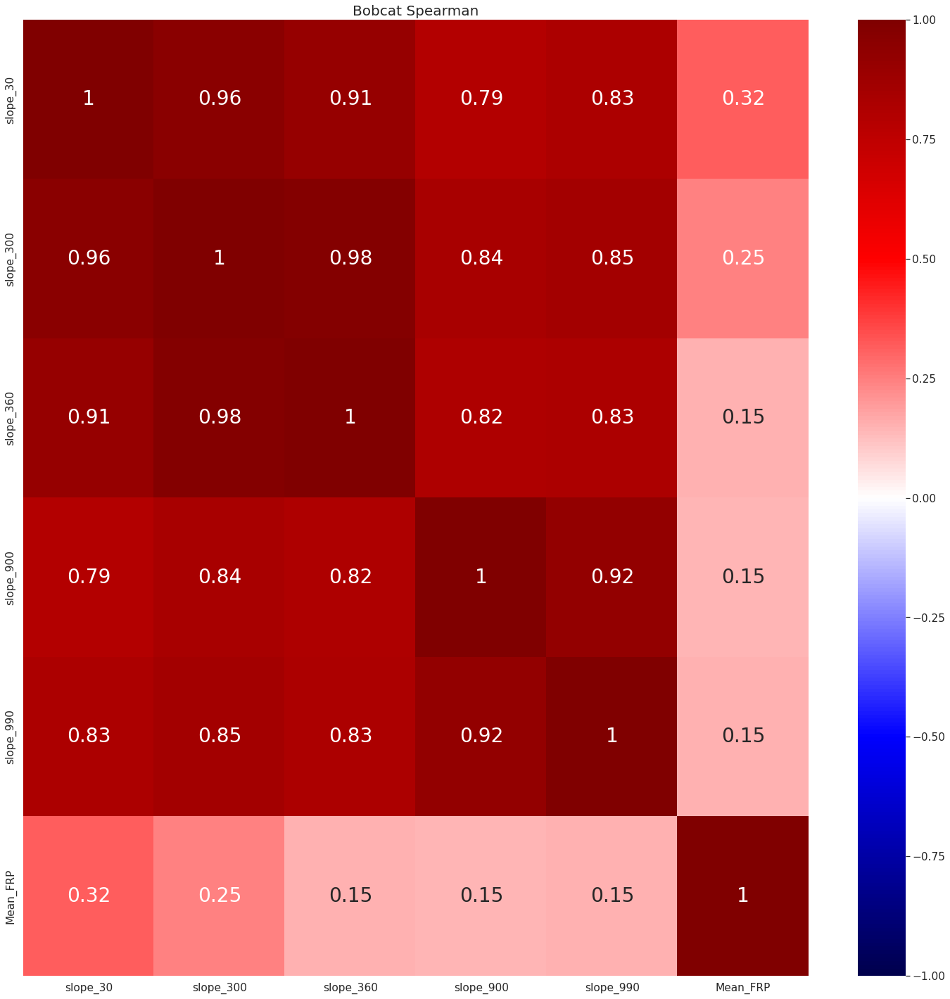

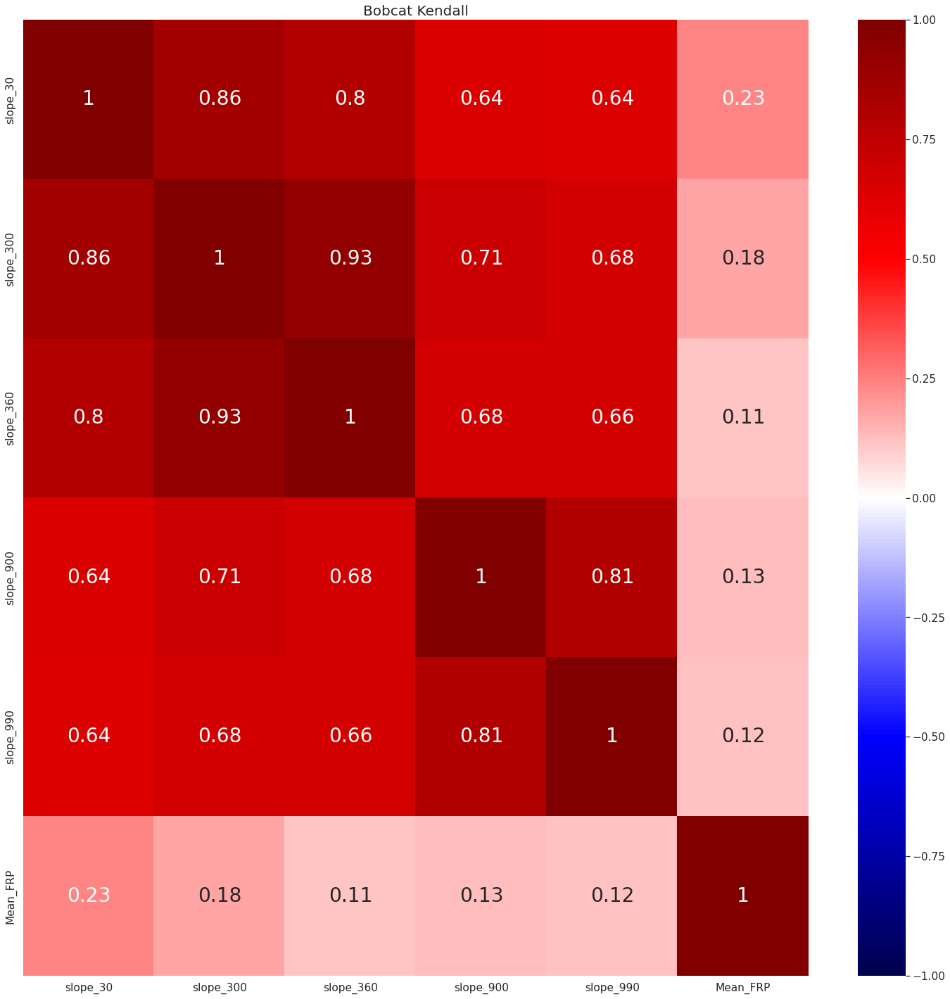

In [15]:
# correlations plot of bobcat, comparing resolutions
vars_corr = ['slope_30','slope_300','slope_360','slope_900','slope_990','Mean_FRP']
plot_correlations(features[vars_corr], 'Bobcat Pearson','pearson')
plot_correlations(features[vars_corr], 'Bobcat Spearman','spearman')
plot_correlations(features[vars_corr], 'Bobcat Kendall','kendall')

## Feb 27th Update

In [10]:
#most up to date version as of 11/3, DOESN'T HAVE FIRELINE yet
merra_all = pd.DataFrame()
rave_all = pd.DataFrame()
hrrr_ws_all = pd.DataFrame()
esi_all = pd.DataFrame()
pws_all = pd.DataFrame()
igbp_all = pd.DataFrame()
names_all = pd.DataFrame()
resources_all = pd.DataFrame()
fuel_loading_all = pd.DataFrame()
area_all = pd.DataFrame()
fireline_all = pd.DataFrame()
days_all = pd.DataFrame()
fwi_all = pd.DataFrame()
fuels_fwi_all = pd.DataFrame()
fuels_by_class_all = pd.DataFrame()


#fire_incidents = ['AUGUST COMPLEX', 'BOBCAT', 'DOLAN','CREEK', 'LAKE'] #only california ones
#fire_incidents =['AUGUST COMPLEX']
#fire_incidents = ['BOBCAT']
fire_incidents=['AUGUST COMPLEX','BOBCAT', 'DOLAN', 'HOLIDAY FARM','CREEK', 'LAKE', 'CAMERON PEAK', 
                  'PINE GULCH','EAST TROUBLESOME']

path_features='/data2/lthapa/ML_daily/fire_features/'
path_poly = '/data2/lthapa/ML_daily/fire_polygons/'
suffix_poly = 'Z_day_start.geojson'
start_time=12
for ii in range(len(fire_incidents)):
    file_prefix = fire_incidents[ii].lower().replace(' ', '_')
    print(file_prefix)
    
    #load in the data that needs variables shifted for persistence
    rave = pd.read_csv(path_features+file_prefix+'_Daily_RAVE_'+str(start_time)+'Z_day_start.csv')
    hrrr_ws = pd.read_csv(path_features+file_prefix+'_Daily_HRRR_ws_'+str(start_time)+'Z_day_start.csv')
    resources = pd.read_csv(path_features+file_prefix+'_Daily_Resources_'+str(start_time)+'Z_day_start.csv')
    fwi = pd.read_csv(path_features+file_prefix+'_Daily_IMERG_FWI_'+str(start_time)+'Z_day_start.csv')
    fuels_by_class = pd.read_csv(path_features+file_prefix+'_Daily_COARSE990_FUEL_FWI_'+str(start_time)+'Z_day_start.csv')
    #area = pd.read_csv(path_features+file_prefix+'_Daily_FIRE_AREA_'+str(start_time)+'Z_day_start.csv')
    
    
    #calculate the fuel density and amount for the given fire
    hd0w0s = hrrr_ws['hd0w0'].values.reshape(len(hrrr_ws),-1)
    hd1w0s = hrrr_ws['hd1w0'].values.reshape(len(hrrr_ws),-1)

    fuels_by_class = fuels_by_class.drop(columns=['Unnamed: 0', 'day'])
    fuels_by_class = fuels_by_class[['Low_N', 'Moderate_N',
                              'High_N','VeryHigh_N',
                              'Extreme_N']]
    print(fuels_by_class.columns)
    #append FWI values and sort them
    category_midpoints = np.tile([630.43,231.37,136.04,79.41,29.32],len(hd0w0s)).reshape(len(hd0w0s),-1)
    to_sort_hd0w0 = np.append(category_midpoints,hd0w0s,axis=1)
    to_sort_hd1w0 = np.append(category_midpoints,hd1w0s,axis=1)

    sorted_hd0w0 = np.sort(to_sort_hd0w0,axis=1)
    sorted_hd1w0 = np.sort(to_sort_hd1w0,axis=1)

    #get the indices of the columns that we need to average
    column_indices_hd0w0 = np.array([np.where(sorted_hd0w0[kk,:]==hd0w0s[kk]) for kk in range(len(hd0w0s))]).flatten()
    column_indices_hd1w0 = np.array([np.where(sorted_hd1w0[kk,:]==hd1w0s[kk]) for kk in range(len(hd1w0s))]).flatten()

    print(column_indices_hd0w0)
    print(column_indices_hd1w0)
    #initialise a dataframe
    fuel_ave_hd0w0 = [(fuels_by_class.iloc[jj,column_indices_hd0w0[jj]]+
                       fuels_by_class.iloc[jj,column_indices_hd0w0[jj]-1])/2 for jj in range(len(hd0w0s))]
    fuel_ave_hd1w0 = [(fuels_by_class.iloc[jj,column_indices_hd1w0[jj]]+
                       fuels_by_class.iloc[jj,column_indices_hd1w0[jj]-1])/2 for jj in range(len(hd1w0s))]
    
    fuels_by_class['fuel_density_hd0w0'] = np.array(fuel_ave_hd0w0).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_by_class['fuel_density_hd1w0'] = np.array(fuel_ave_hd1w0).flatten() #save fuel density to df_hrrr to plot with the others
    fuels_by_class['day'] = rave['day'].values

    #do the shift
    rave_shifted = shift_ndays(rave,1,['Mean_FRP'],['Yesterday_FRP'])
    hrrr_ws_shifted = shift_ndays(hrrr_ws,1,['hd0w0','hd1w0','hwp'],
                                  ['Yesterday_HD0W0','Yesterday_HD1W0','Yesterday_HWP'])
    resources_shifted = shift_ndays(resources, 1,['percent_contained'],['Yesterday_percent_contained'])
    fwi_shifted = shift_ndays(fwi,1,['IMERG.FINAL.v6_FWI'], ['Yesterday_FWI'])
    fuels_fwi_shifted = shift_ndays(fuels_by_class,1,['fuel_density_hd0w0','fuel_density_hd1w0','Extreme_N'],
                                                ['Yesterday_fuel_density_hd0w0','Yesterday_fuel_density_hd1w0',
                                                 'Yesterday_Extreme_N'])

    
    days = pd.DataFrame({'day':np.zeros(len(rave))})
    days['day'] = rave['day'].values
    
    if fire_incidents[ii] =='HOLIDAY FARM':#holiday farm is missing the first day in reosurces, drop it
            rave_shifted = rave_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            hrrr_ws_shifted = hrrr_ws_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            names = names.drop(labels=0,axis=0).reset_index(drop=True)
            fwi_shifted = fwi_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            fuels_fwi_shifted = fuels_fwi_shifted.drop(labels=0,axis=0).reset_index(drop=True)
            days = days.drop(labels=0,axis=0).reset_index(drop=True)
    
    #get the active days
    inds_active = np.where(rave_shifted['Mean_FRP']>10)[0] #this is the threshold I used at NOAA

    #filter the days by rave
    days = days.iloc[inds_active]
    rave_shifted = rave_shifted.iloc[inds_active]
    hrrr_ws_shifted = hrrr_ws_shifted.iloc[inds_active]
    resources_shifted = resources_shifted.iloc[inds_active]
    fwi_shifted = fwi_shifted.iloc[inds_active]
    fuels_fwi_shifted = fuels_fwi_shifted.iloc[inds_active]
    
    #pws = pd.read_csv(path_features+file_prefix+'_Daily_PWS_'+str(start_time)+'Z_day_start.csv').iloc[inds_active] 
    #igbp = pd.read_csv(path_features+file_prefix+'_Daily_IGBP_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    #esi = pd.read_csv(path_features+file_prefix+'_Daily_ESI_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    #fuel_loading = pd.read_csv(path_features+file_prefix+'_Daily_FUEL_LOADING_'+str(start_time)+'Z_day_start.csv').iloc[inds_active]
    
    
    
    names = pd.DataFrame({'name':[fire_incidents[ii]]*len(inds_active)})
    rave_all = pd.concat([rave_all,rave_shifted], axis=0)
    hrrr_ws_all = pd.concat([hrrr_ws_all,hrrr_ws_shifted],axis=0)
    #esi_all = pd.concat([esi_all,esi], axis=0)
    #pws_all = pd.concat([pws_all,pws], axis=0)
    #igbp_all= pd.concat([igbp_all,igbp])
    names_all = pd.concat([names_all,names])
    resources_all = pd.concat([resources_all,resources_shifted])
    #fuel_loading_all=pd.concat([fuel_loading_all,fuel_loading])
    #area_all = pd.concat([area_all,area])
    days_all = pd.concat([days_all,days])
    #fireline_all = pd.concat([fireline_all,fireline])
    fwi_all = pd.concat([fwi_all,fwi_shifted])
    fuels_fwi_all = pd.concat([fuels_fwi_all,fuels_fwi_shifted])
    print(rave_all)

    #cpc_all = pd.concat([cpc_all,cpc], axis=0)
    #imerg_all = pd.concat([imerg_all,imerg], axis=0)

august_complex
Index(['Low_N', 'Moderate_N', 'High_N', 'VeryHigh_N', 'Extreme_N'], dtype='object')
[3 2 3 2 1 1 1 2 2 1 1 2 2 2 1 1 2 1 1 2 2 2 2 3 2 2 1 1 2 2 2 1 1 1 1 1 1
 1 1 1 1 1 3 3 1 1 2 2 1 1 1 1 1 1 1 1 1 1 1 1 3 3 2 2 1 2 1 1 1 1]
[3 2 2 3 1 1 1 1 2 1 1 2 2 2 1 1 2 1 1 2 2 2 2 3 2 2 1 1 2 2 1 1 1 1 1 1 1
 1 1 1 1 1 3 2 2 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 3 3 2 2 1 2 2 2 1 1]
                   day  Unnamed: 0       Mean_FRP           FRE           CO2  \
0  2020-08-16 12:00:00         0.0    5089.904594  1.832366e+07  1.077885e+07   
1  2020-08-17 12:00:00         1.0    1195.290696  4.303046e+06  2.531259e+06   
2  2020-08-18 12:00:00         2.0   95149.591078  3.425385e+08  2.039872e+08   
3  2020-08-19 12:00:00         3.0  225709.730203  8.125550e+08  4.798304e+08   
4  2020-08-20 12:00:00         4.0   99571.754303  3.584583e+08  2.111131e+08   
..                 ...         ...            ...           ...           ...   
65 2020-10-21 12:00:00        65.0      28.09874

                   day  Unnamed: 0       Mean_FRP           FRE           CO2  \
0  2020-08-16 12:00:00         0.0    5089.904594  1.832366e+07  1.077885e+07   
1  2020-08-17 12:00:00         1.0    1195.290696  4.303046e+06  2.531259e+06   
2  2020-08-18 12:00:00         2.0   95149.591078  3.425385e+08  2.039872e+08   
3  2020-08-19 12:00:00         3.0  225709.730203  8.125550e+08  4.798304e+08   
4  2020-08-20 12:00:00         4.0   99571.754303  3.584583e+08  2.111131e+08   
..                 ...         ...            ...           ...           ...   
9  2020-09-17 12:00:00        10.0    1663.077841  5.987080e+06  3.521888e+06   
10 2020-09-28 12:00:00        11.0      15.347303  5.525029e+04  3.250088e+04   
11 2020-10-03 12:00:00        12.0      39.277527  1.413991e+05  8.317774e+04   
13 2020-10-06 12:00:00        14.0      16.772207  6.037995e+04  3.551838e+04   
14 2020-10-08 12:00:00        15.0      22.454447  8.083601e+04  4.755162e+04   

              CO           

                   day  Unnamed: 0       Mean_FRP           FRE           CO2  \
0  2020-08-16 12:00:00         0.0    5089.904594  1.832366e+07  1.077885e+07   
1  2020-08-17 12:00:00         1.0    1195.290696  4.303046e+06  2.531259e+06   
2  2020-08-18 12:00:00         2.0   95149.591078  3.425385e+08  2.039872e+08   
3  2020-08-19 12:00:00         3.0  225709.730203  8.125550e+08  4.798304e+08   
4  2020-08-20 12:00:00         4.0   99571.754303  3.584583e+08  2.111131e+08   
..                 ...         ...            ...           ...           ...   
22 2020-08-22 12:00:00        22.0   28465.455728  1.024756e+08  6.292149e+07   
23 2020-08-23 12:00:00        23.0    9402.172956  3.384782e+07  2.079107e+07   
24 2020-08-24 12:00:00        24.0   19178.000923  6.904080e+07  4.117543e+07   
25 2020-08-25 12:00:00        25.0    3048.484039  1.097454e+07  6.574722e+06   
26 2020-09-04 12:00:00        26.0    1027.417609  3.698703e+06  2.294853e+06   

              CO           

In [12]:
#prepares the HRRR data
df_list_hrrr = [days_all[['day']].reset_index(drop=True),
                hrrr_ws_all[['temp_2m','vpd_2m','wind_speed','hd0w0','hd1w0','Yesterday_HD0W0','Yesterday_HD1W0','hd2w0','hd3w0','hd4w0','hd5w0','hwp','Yesterday_HWP']].reset_index(drop=True),
                fwi_all[['IMERG.FINAL.v6_FWI','Yesterday_FWI']].reset_index(drop=True),
                #pws_all[['PWS']].reset_index(drop=True),
                #esi_all[['ESI']].reset_index(drop=True),
                names_all[['name']].reset_index(drop=True),
                resources_all[['personnel', 'percent_contained','Yesterday_percent_contained']].reset_index(drop=True),
                #fuel_loading_all[['fuel_loadings']].reset_index(drop=True),
                rave_all[['Mean_FRP','Yesterday_FRP']].reset_index(drop=True),
                fuels_fwi_all[['Low_N', 'Moderate_N','High_N','VeryHigh_N','Extreme_N',
                               'fuel_density_hd0w0','fuel_density_hd1w0','Yesterday_fuel_density_hd0w0',
                               'Yesterday_fuel_density_hd1w0','Yesterday_Extreme_N']].reset_index(drop=True)]
df_hrrr = pd.concat(df_list_hrrr,axis=1)
print(df_hrrr.columns)
df_hrrr['hd0w0_scaled'] = df_hrrr['hd0w0']/5
df_hrrr['hd0w0_scaled_up'] = df_hrrr['hd0w0']*10

Index(['day', 'temp_2m', 'vpd_2m', 'wind_speed', 'hd0w0', 'hd1w0',
       'Yesterday_HD0W0', 'Yesterday_HD1W0', 'hd2w0', 'hd3w0', 'hd4w0',
       'hd5w0', 'hwp', 'Yesterday_HWP', 'IMERG.FINAL.v6_FWI', 'Yesterday_FWI',
       'name', 'personnel', 'percent_contained', 'Yesterday_percent_contained',
       'Mean_FRP', 'Yesterday_FRP', 'Low_N', 'Moderate_N', 'High_N',
       'VeryHigh_N', 'Extreme_N', 'fuel_density_hd0w0', 'fuel_density_hd1w0',
       'Yesterday_fuel_density_hd0w0', 'Yesterday_fuel_density_hd1w0',
       'Yesterday_Extreme_N'],
      dtype='object')


In [17]:
#hd0w0

df_hrrr['cont1_fhd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['fuel_density_hd0w0']
df_hrrr['FRP1_rel_fhd0w0'] = df_hrrr['Yesterday_FRP']*(df_hrrr['fuel_density_hd0w0']/df_hrrr['Yesterday_fuel_density_hd0w0'])
df_hrrr['cont1_FRP1_rel_fhd0w0'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['fuel_density_hd0w0']/df_hrrr['Yesterday_fuel_density_hd0w0'])

df_hrrr['hd0w0_extreme'] = df_hrrr['hd0w0']*df_hrrr['Extreme_N']
df_hrrr['Yesterday_hd0w0_extreme'] = df_hrrr['Yesterday_HD0W0']*df_hrrr['Yesterday_Extreme_N']

df_hrrr['cont1_hd0w0_extreme'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['hd0w0']*df_hrrr['Extreme_N']
df_hrrr['FRP1_rel_hd0w0_extreme'] = df_hrrr['Yesterday_FRP']*(df_hrrr['hd0w0_extreme']/df_hrrr['Yesterday_hd0w0_extreme'])
df_hrrr['cont1_FRP1_rel_hd0w0_extreme'] = (1-(df_hrrr['Yesterday_percent_contained']/100))*df_hrrr['Yesterday_FRP']*\
                                            (df_hrrr['hd0w0_extreme']/df_hrrr['Yesterday_hd0w0_extreme'])

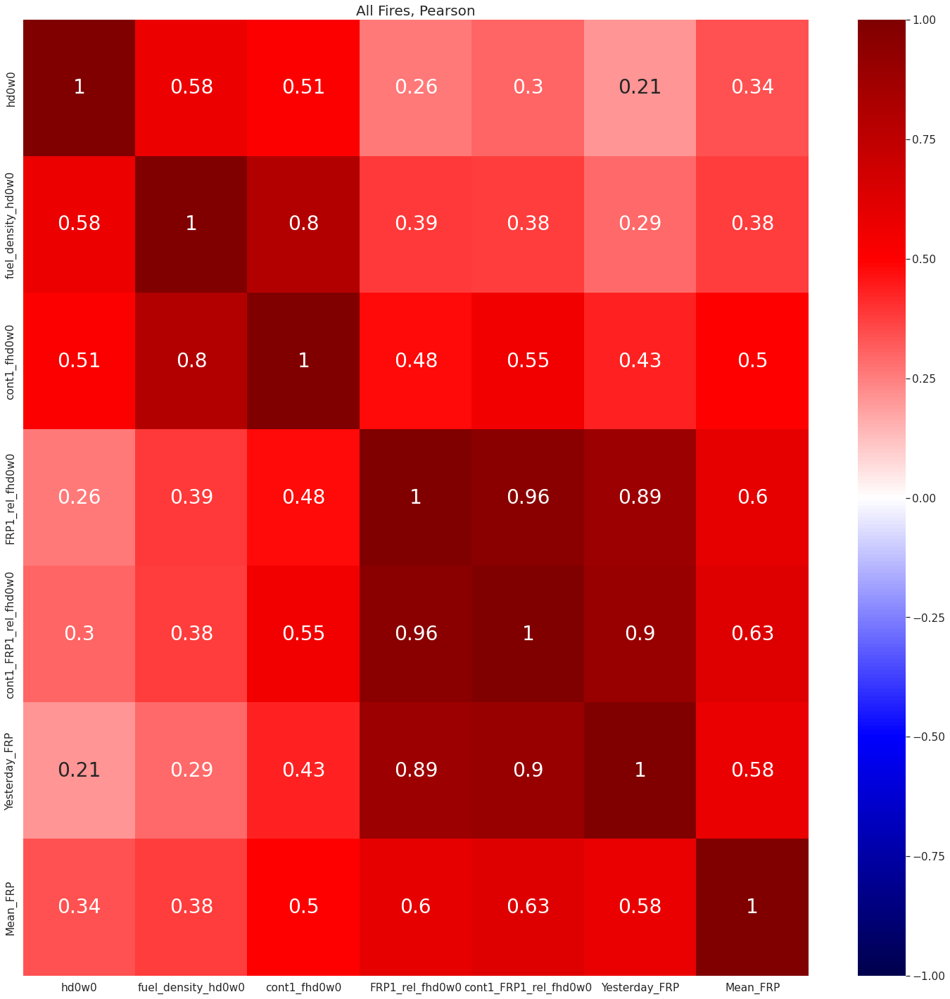

AUGUST COMPLEX


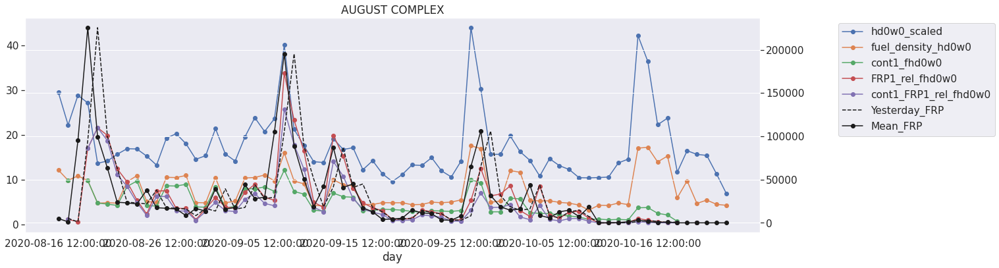

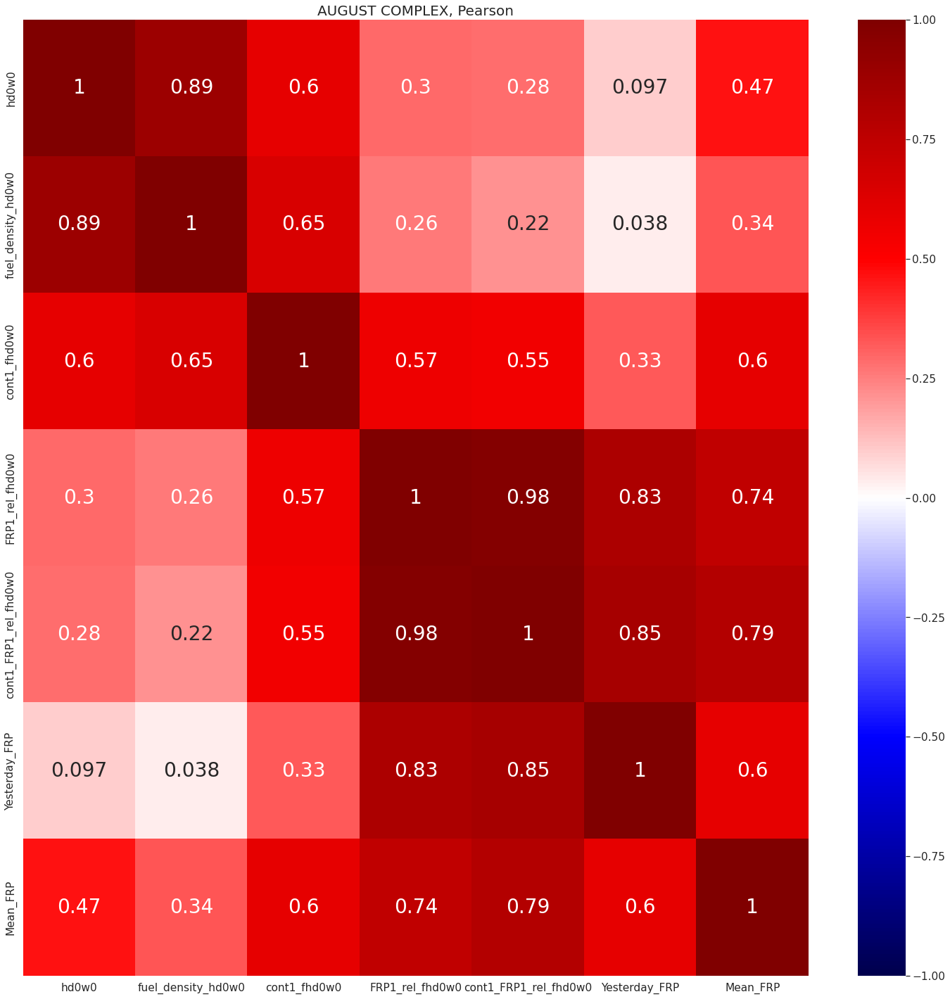

BOBCAT


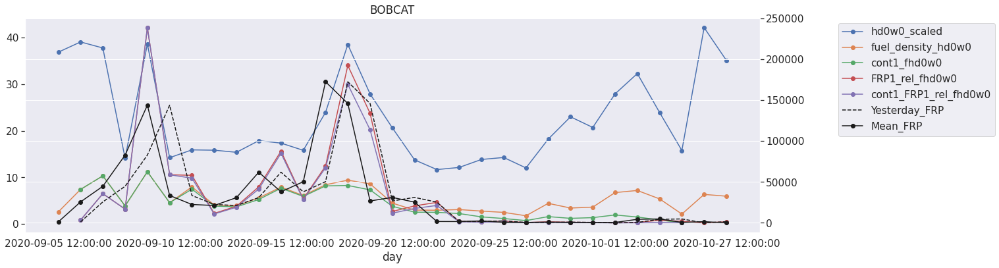

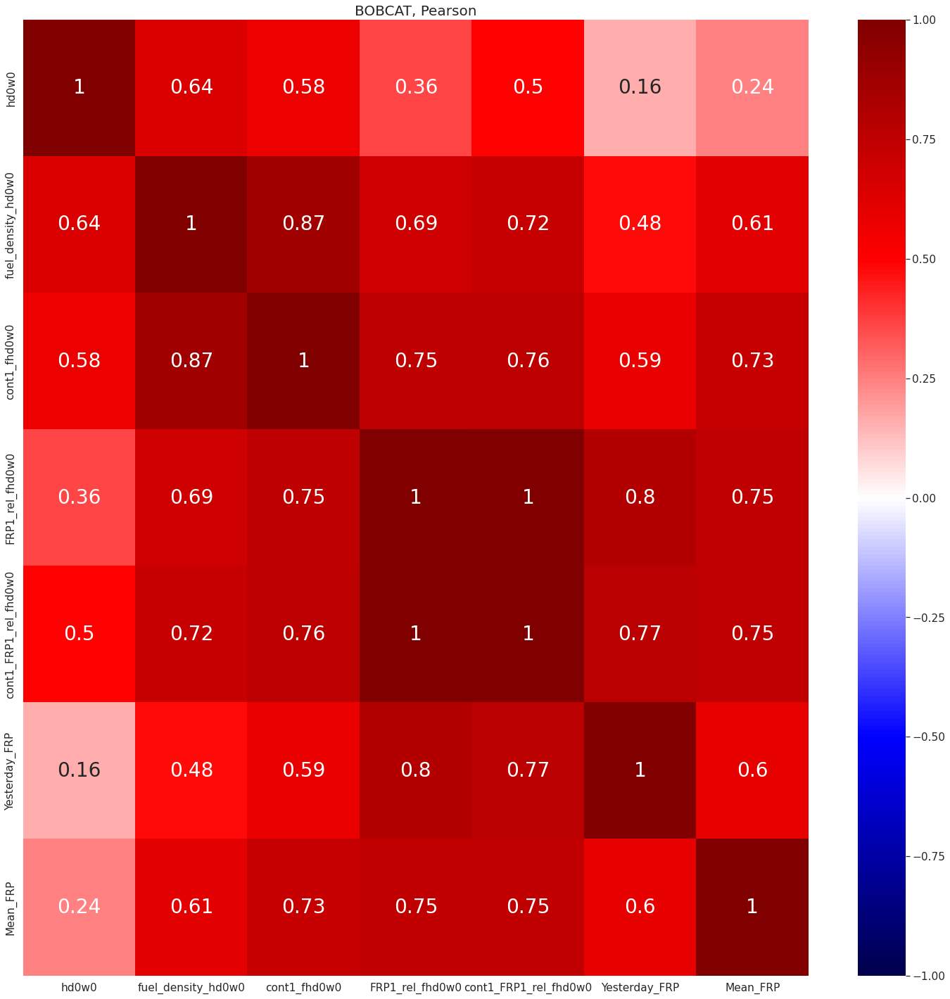

DOLAN


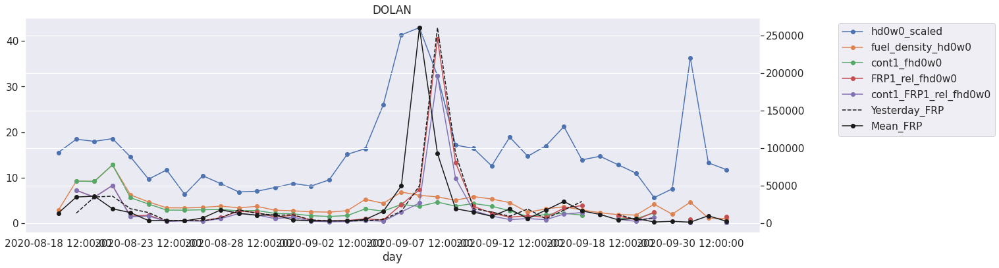

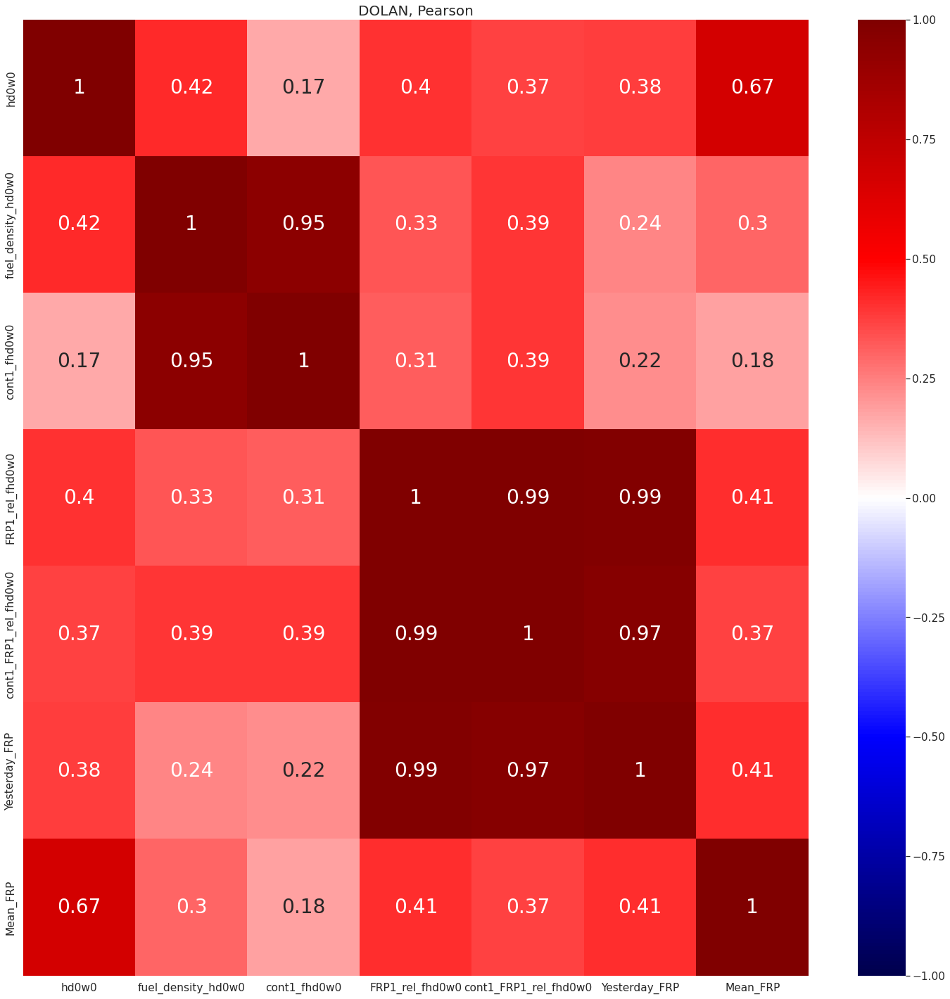

HOLIDAY FARM


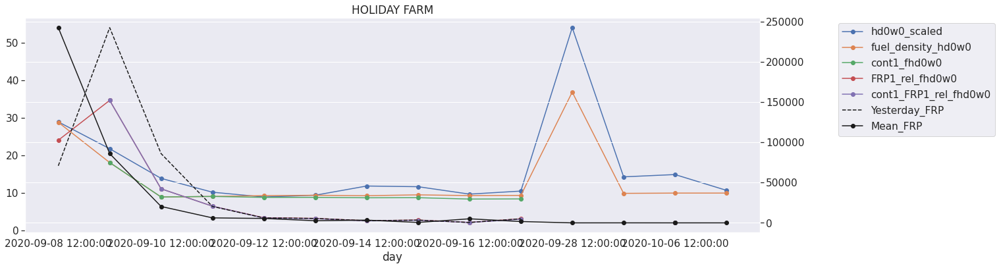

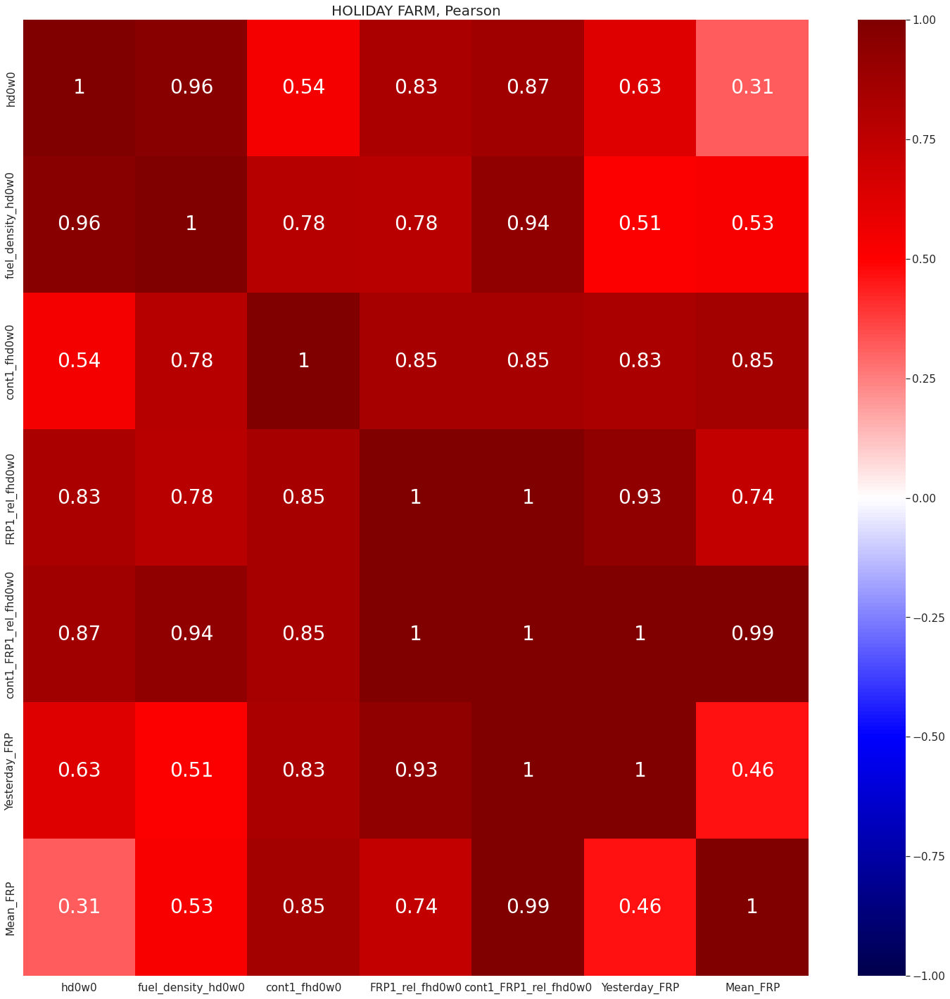

CREEK


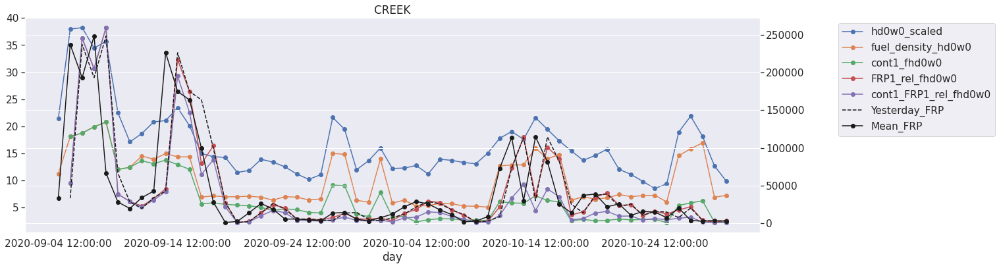

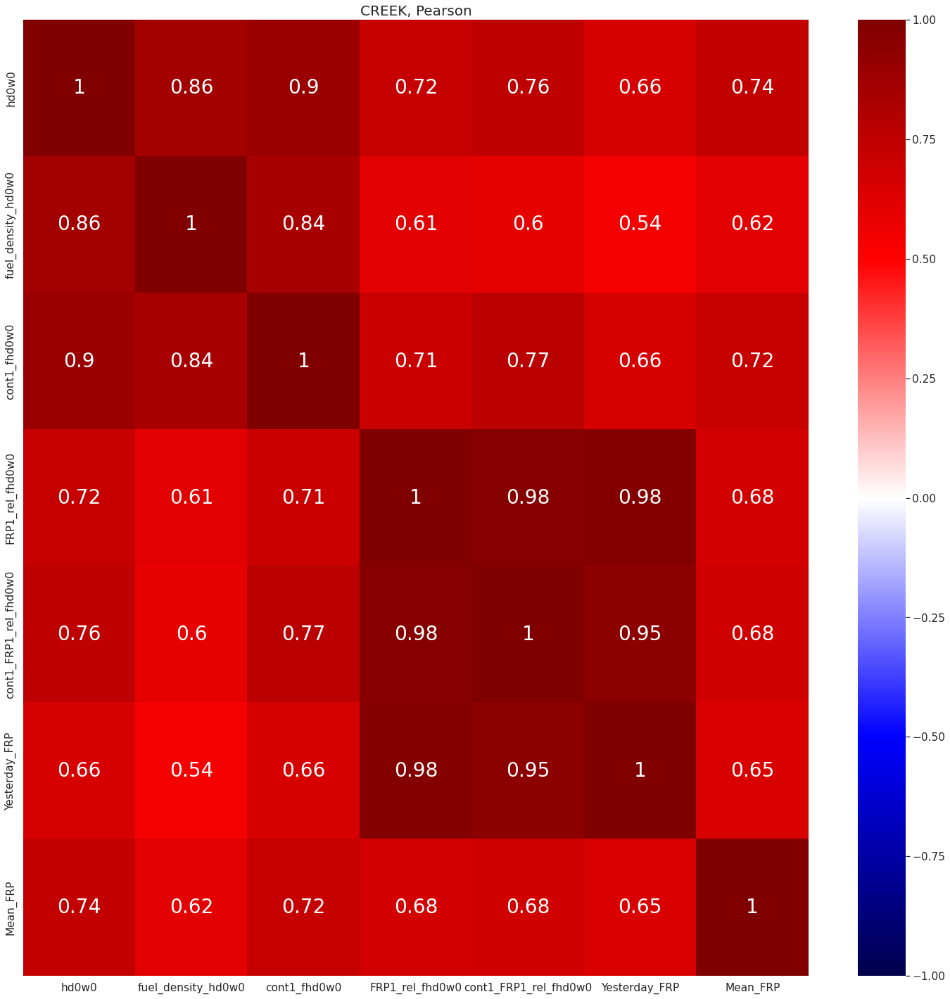

LAKE


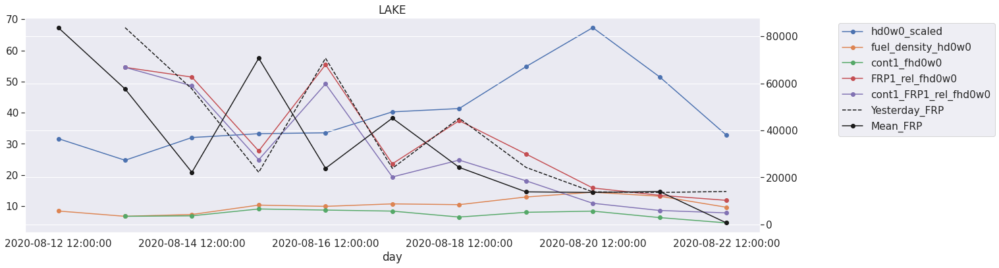

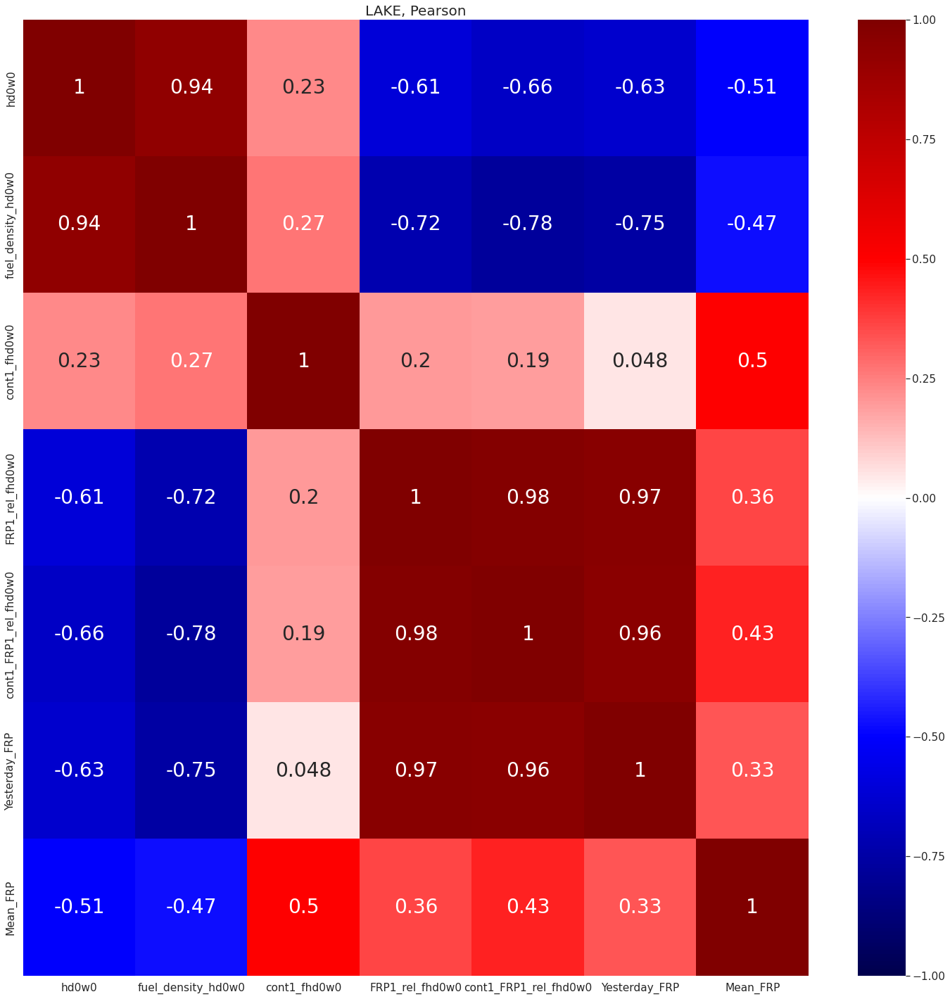

CAMERON PEAK


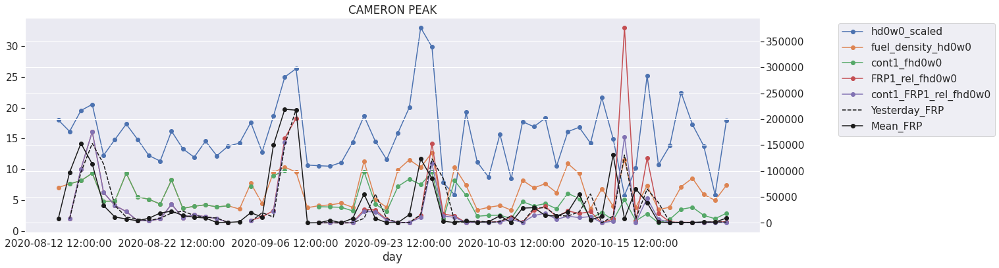

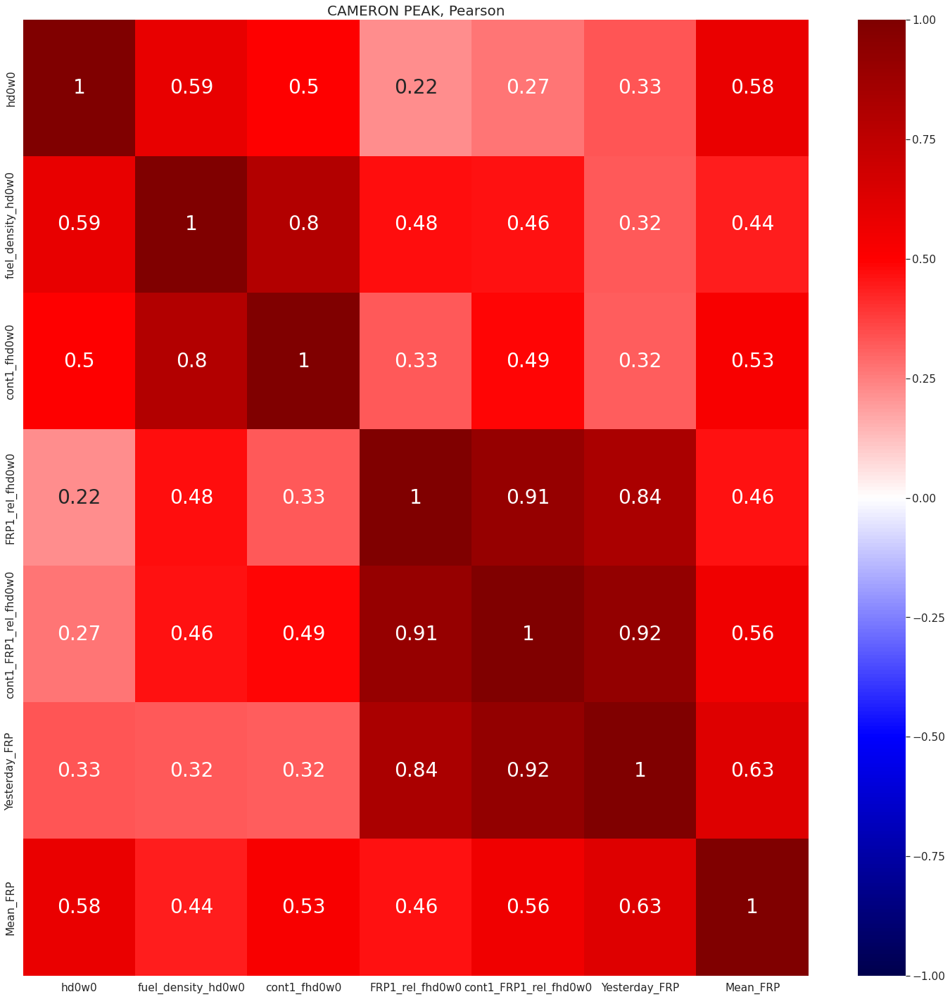

PINE GULCH


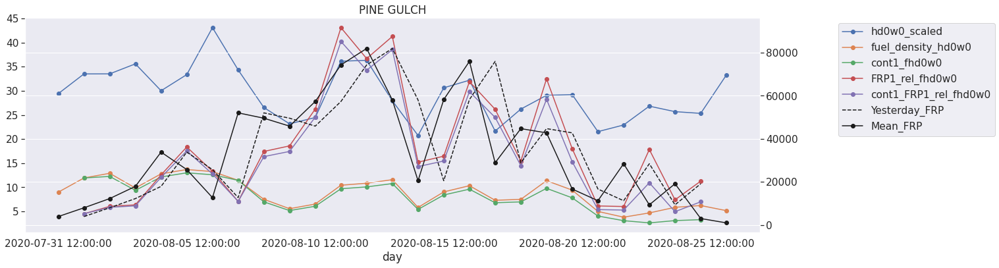

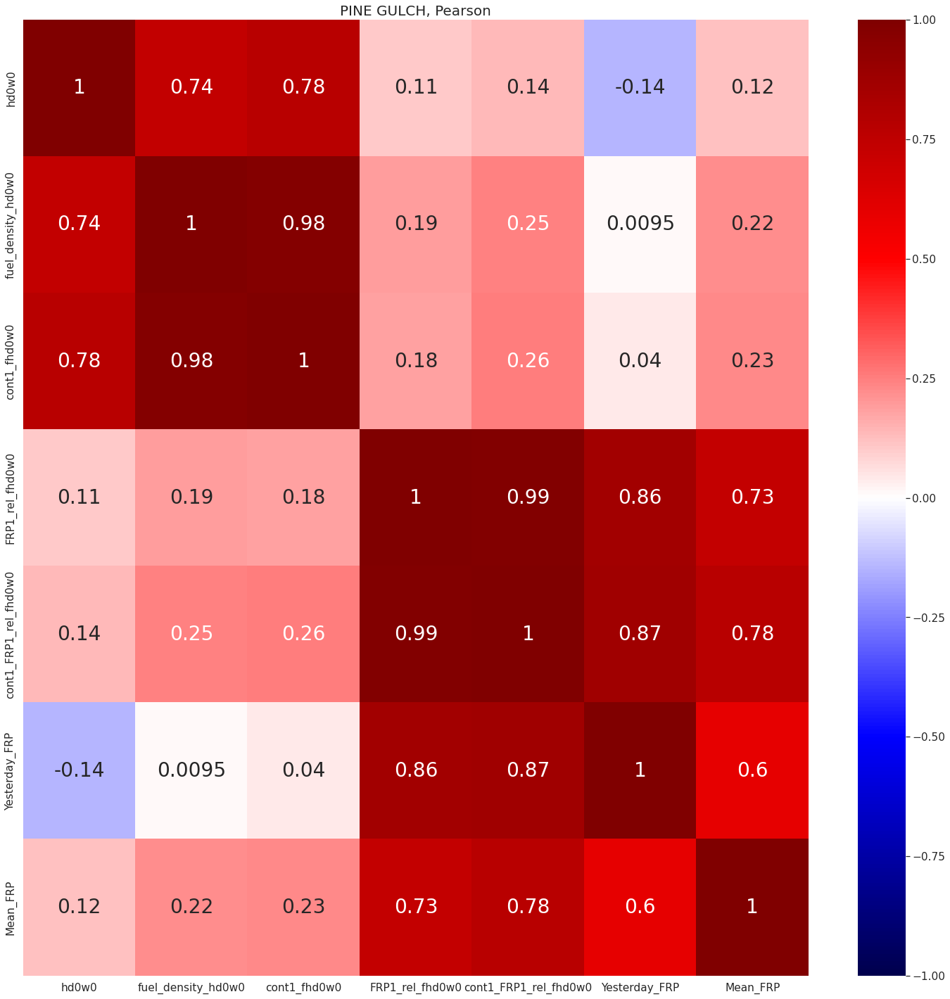

EAST TROUBLESOME


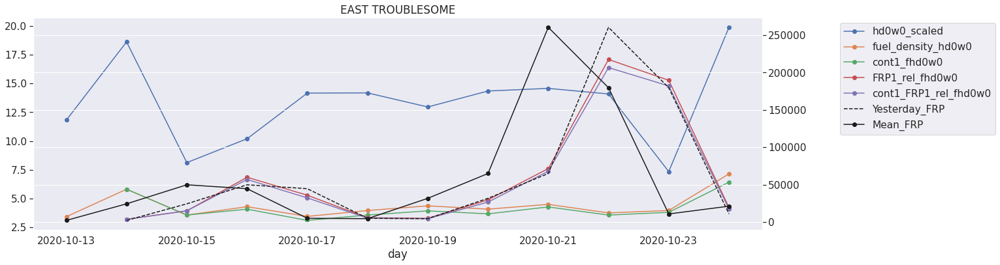

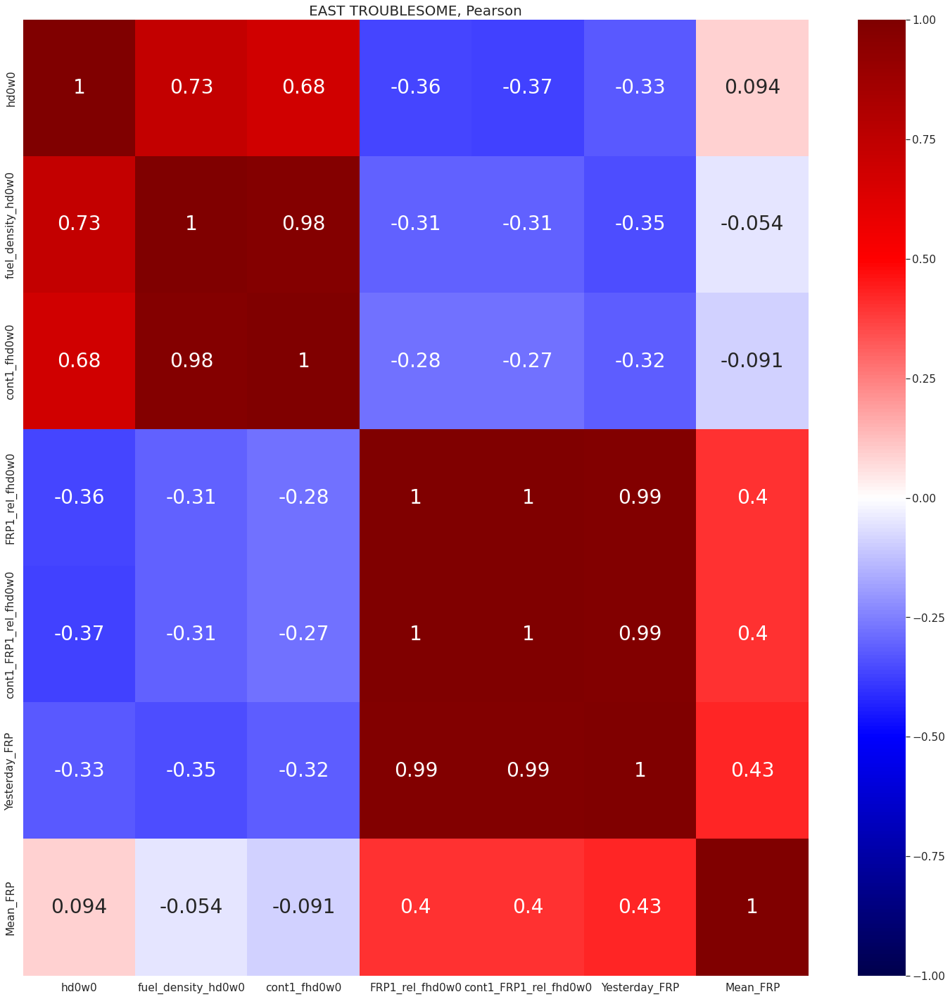

In [14]:
#per fire FUEL density selected using HDW quantiles

vars_fhdw = ['hd0w0','fuel_density_hd0w0','cont1_fhd0w0','FRP1_rel_fhd0w0','cont1_FRP1_rel_fhd0w0','Yesterday_FRP', 'Mean_FRP']
plot_correlations(df_hrrr[vars_fhdw], 'All Fires, Pearson','pearson')


#fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    #print(features_plot)
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['hd0w0_scaled','fuel_density_hd0w0','cont1_fhd0w0'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['FRP1_rel_fhd0w0', 'cont1_FRP1_rel_fhd0w0'],secondary_y=True,
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                            figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()
    
    plot_correlations(features_plot[vars_fhdw], fire_incidents[ii]+', Pearson','pearson')

    

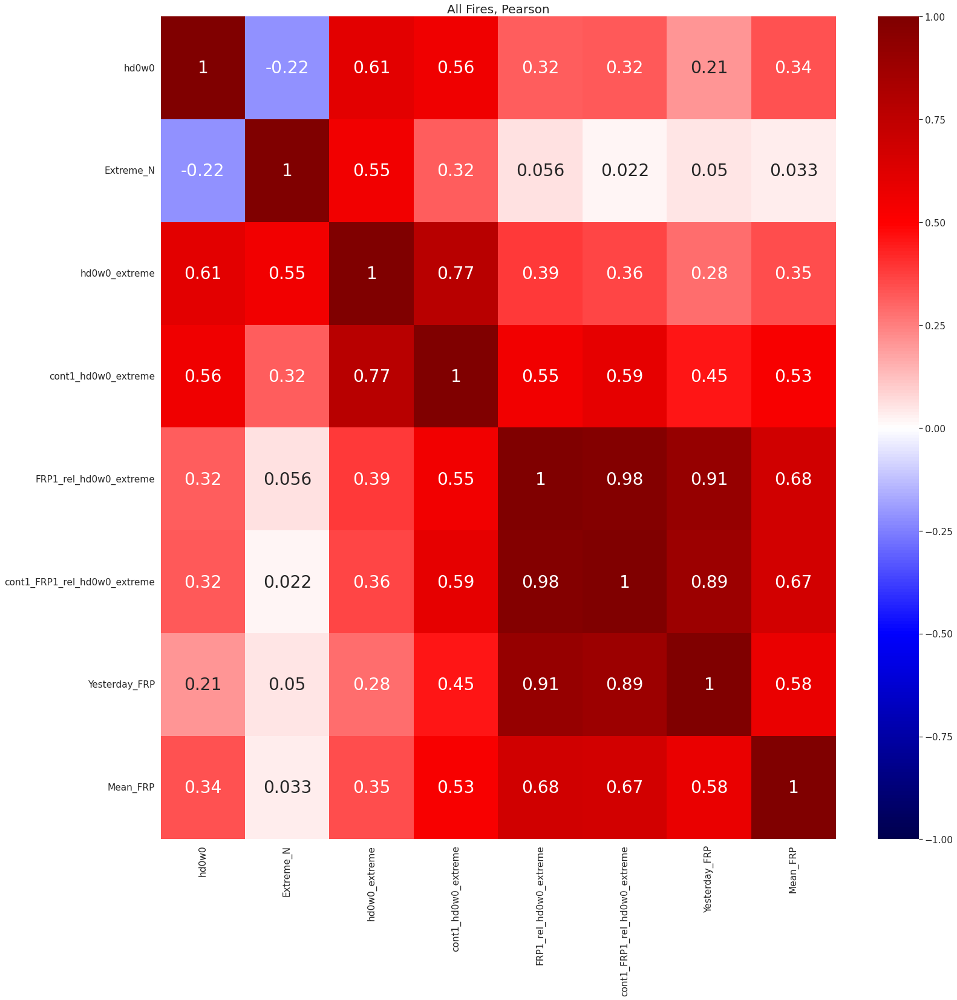

AUGUST COMPLEX


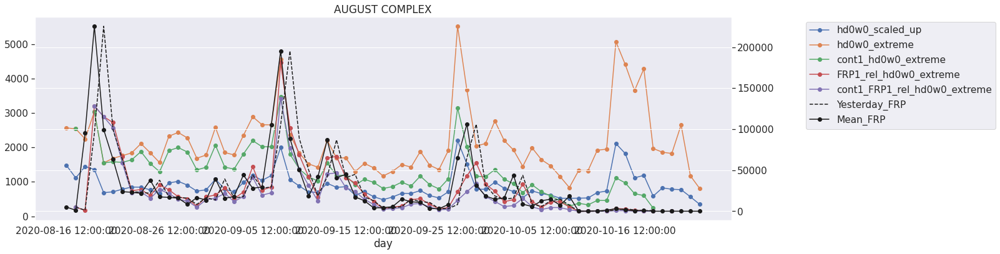

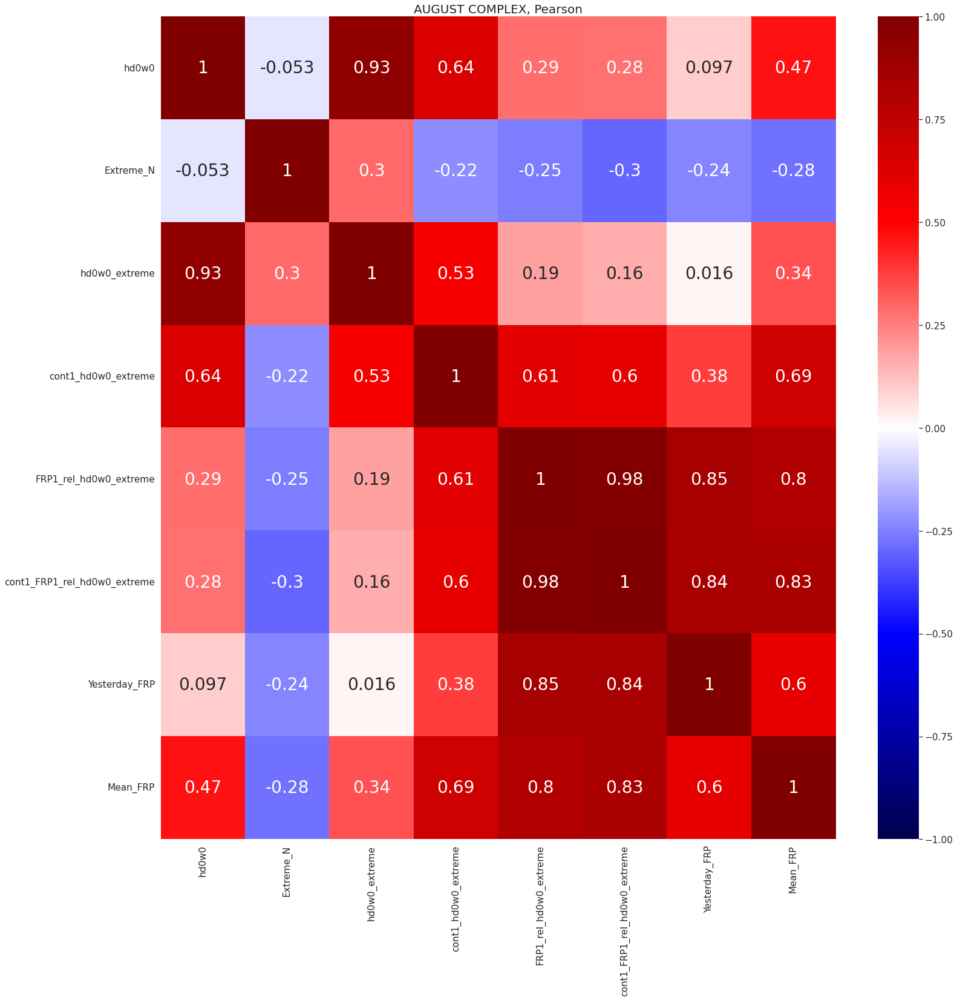

BOBCAT


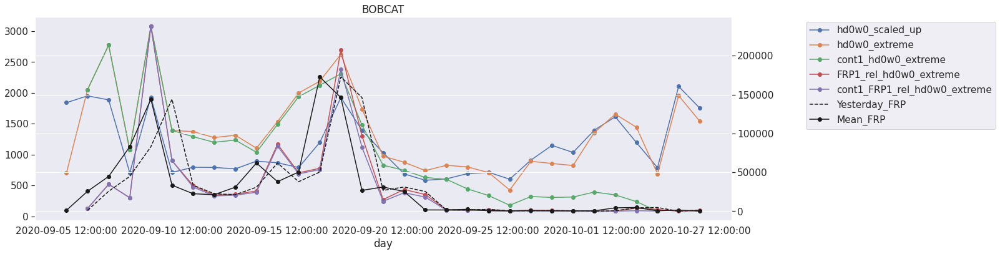

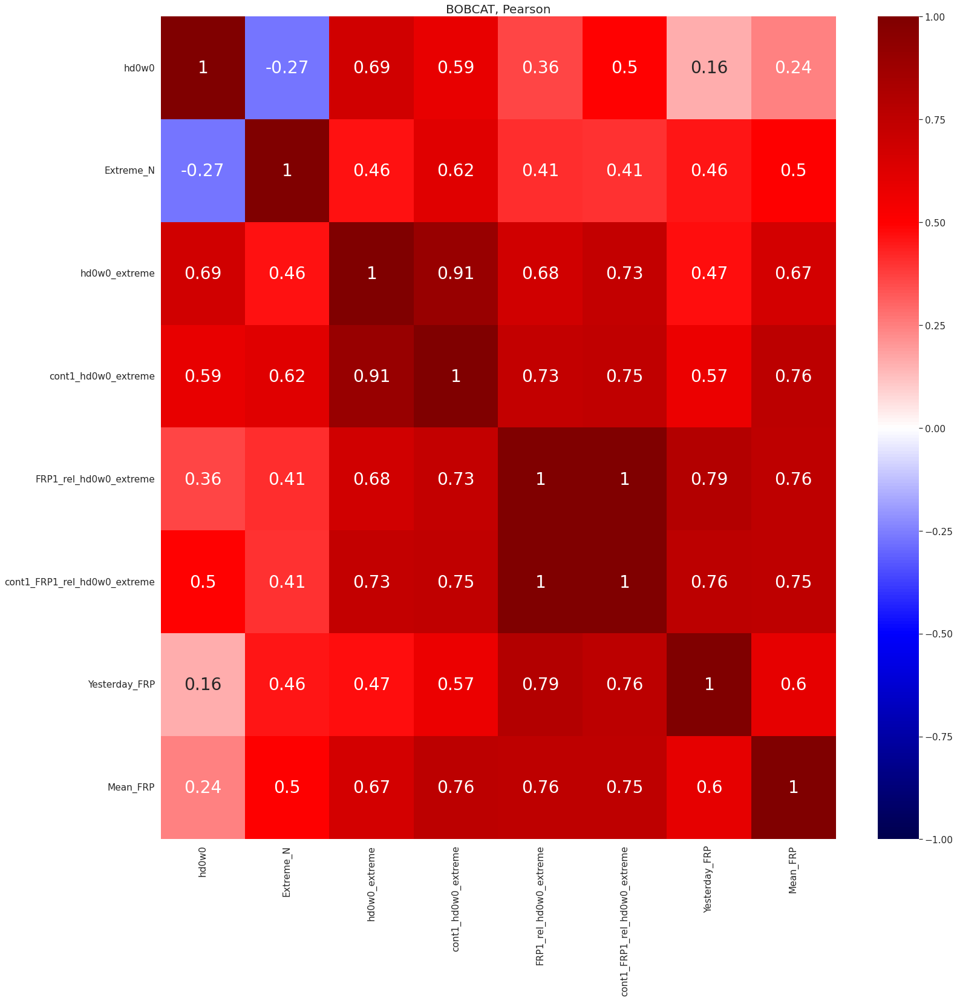

CREEK


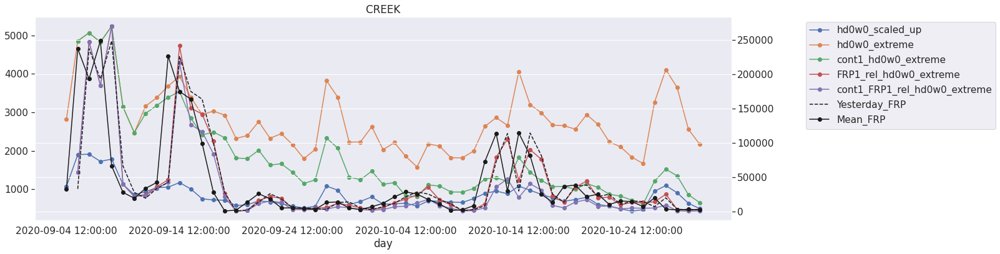

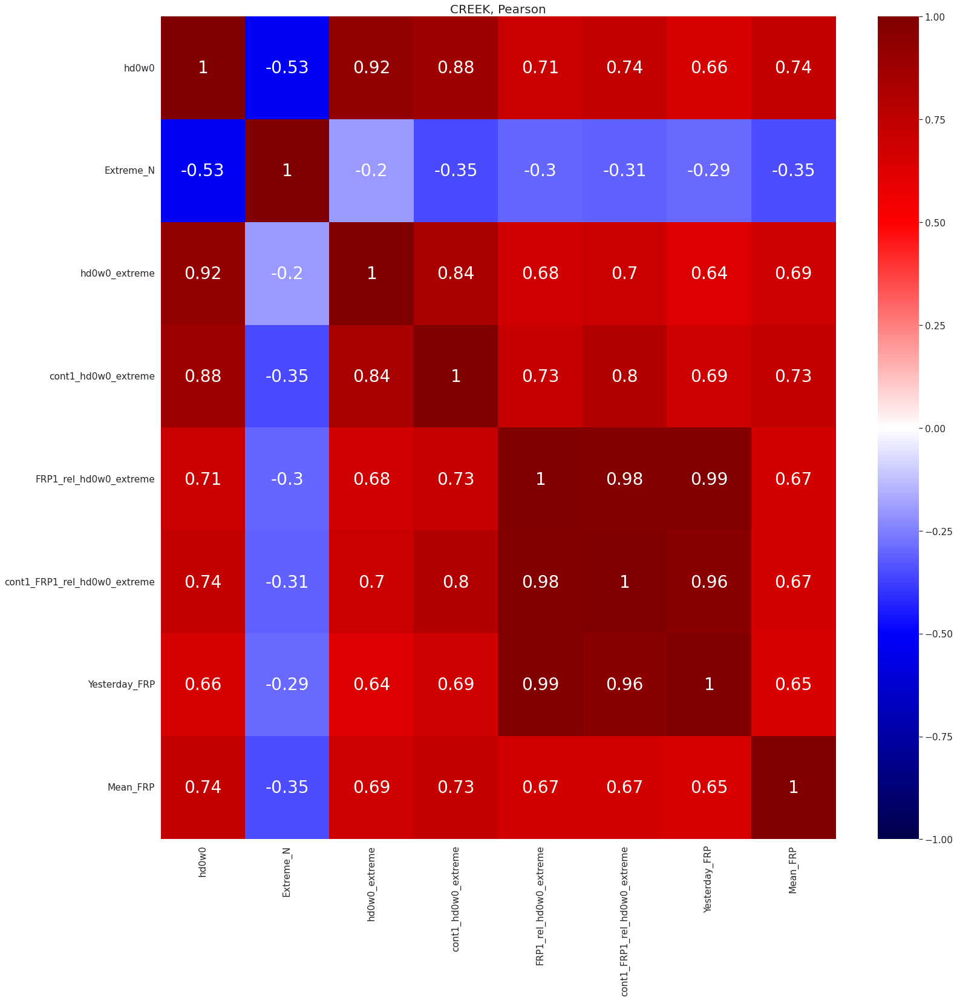

DOLAN


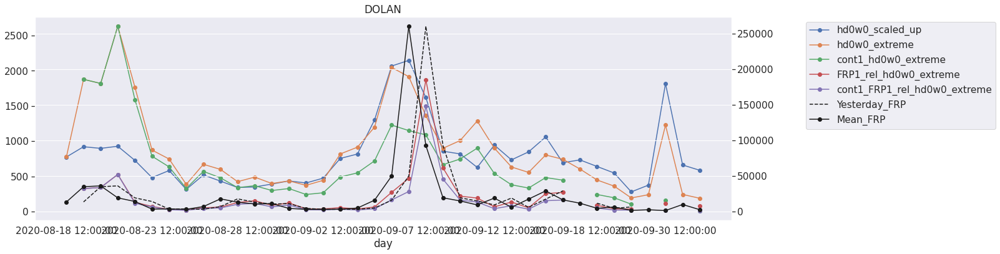

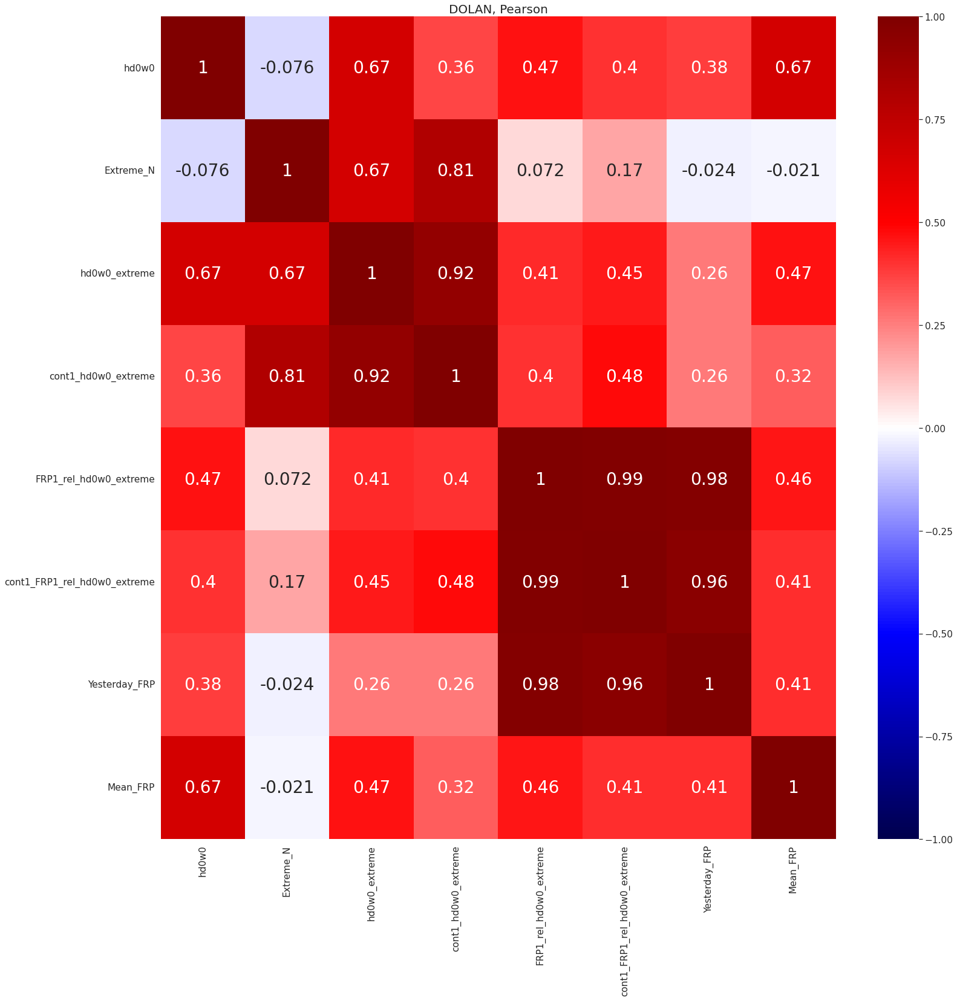

LAKE


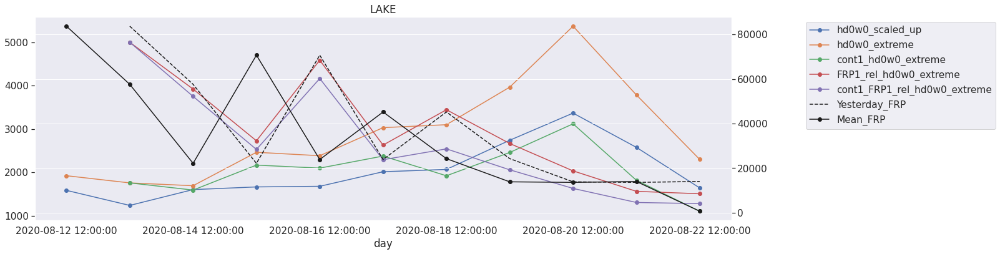

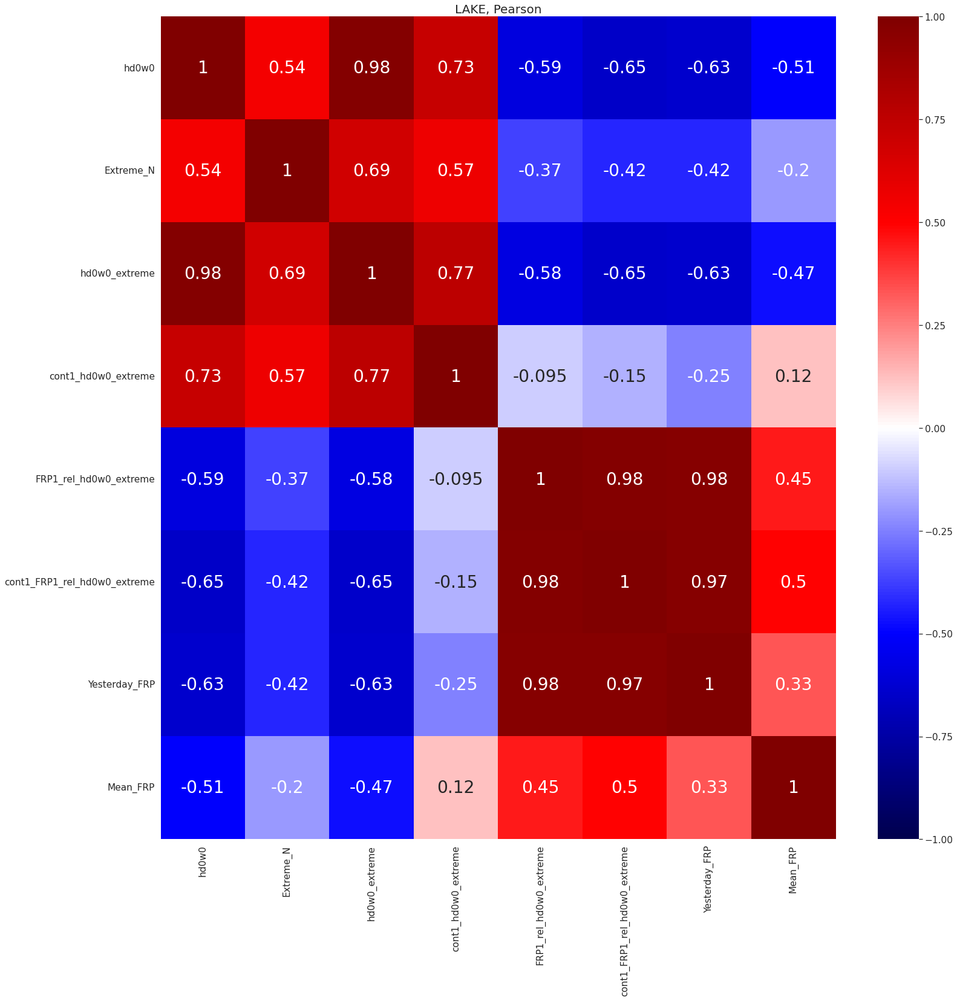

In [18]:
#per fire extreme fuel density* hdw
vars_hd0w0_extreme = ['hd0w0', 'Extreme_N','hd0w0_extreme','cont1_hd0w0_extreme','FRP1_rel_hd0w0_extreme',
             'cont1_FRP1_rel_hd0w0_extreme','Yesterday_FRP', 'Mean_FRP']
plot_correlations(df_hrrr[vars_hd0w0_extreme], 'All Fires, Pearson','pearson')

fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    #print(features_plot)
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['hd0w0_scaled_up','hd0w0_extreme','cont1_hd0w0_extreme'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['FRP1_rel_hd0w0_extreme', 'cont1_FRP1_rel_hd0w0_extreme'],secondary_y=True,
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                            figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()
    
    plot_correlations(features_plot[vars_hd0w0_extreme], fire_incidents[ii]+', Pearson','pearson')

    

AUGUST COMPLEX


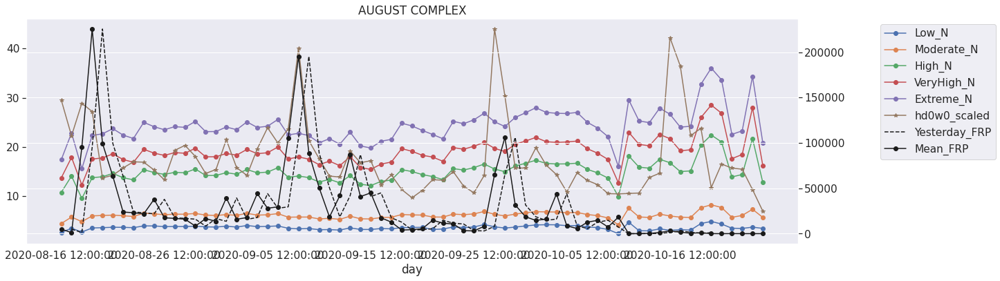

BOBCAT


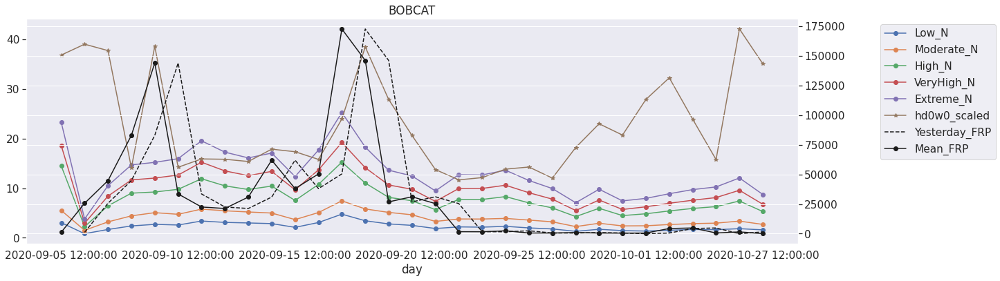

CREEK


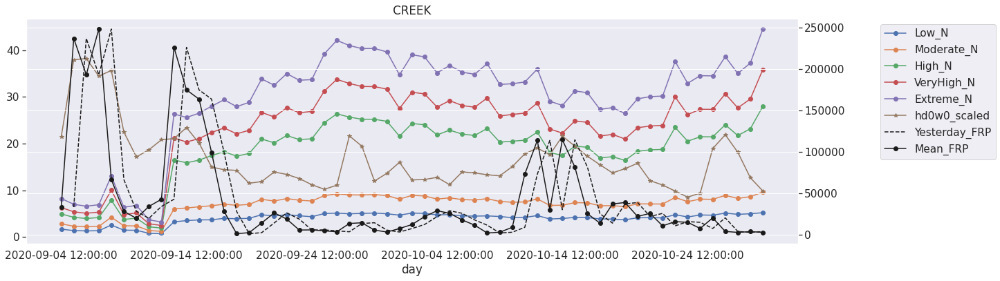

DOLAN


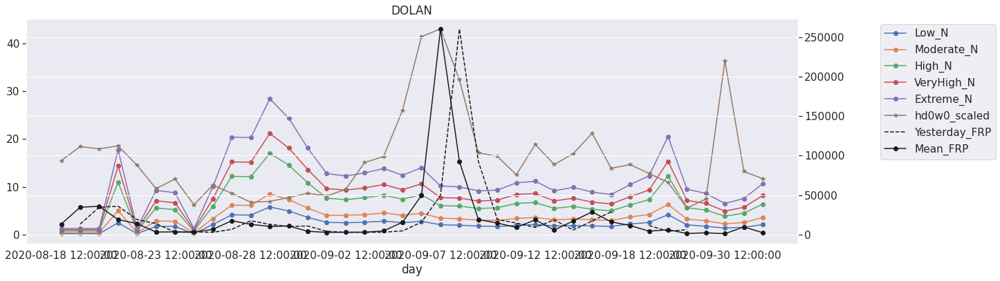

LAKE


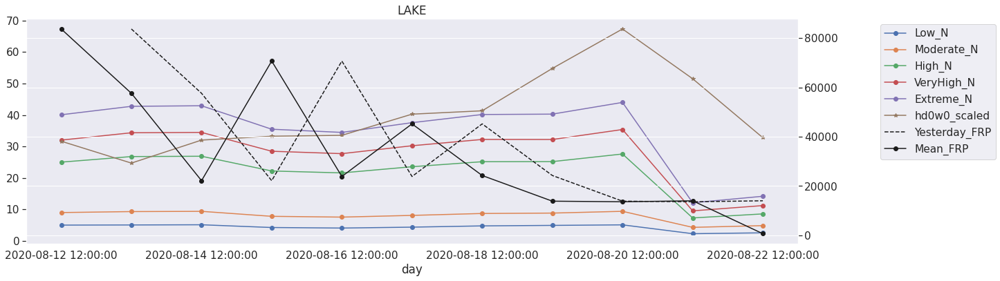

In [46]:
fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    #print(features_plot)
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['Low_N', 'Moderate_N','High_N','VeryHigh_N','Extreme_N'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['hd0w0_scaled'],
                            figsize=(20,6),style='*-',ax=ax )
    features_plot.plot(x='day', y=['Yesterday_FRP'],secondary_y=True,
                            figsize=(20,6),style='k--',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()
    
    

AUGUST COMPLEX


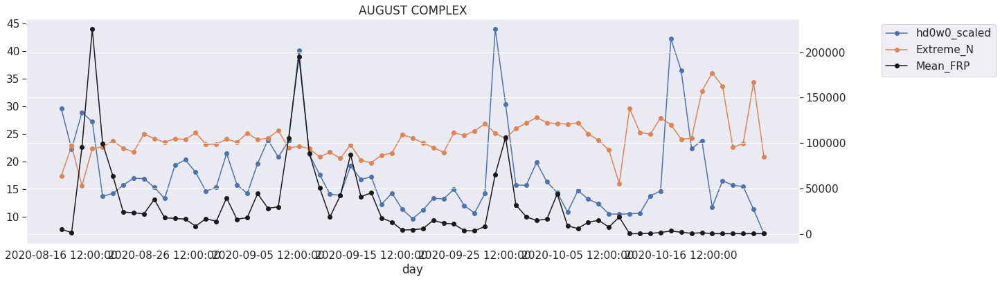

BOBCAT


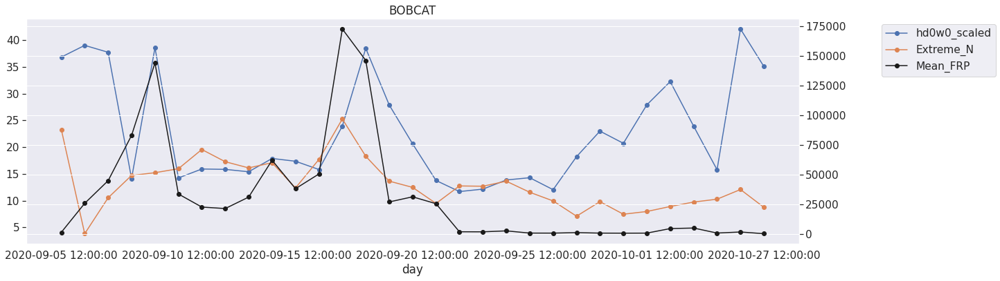

CREEK


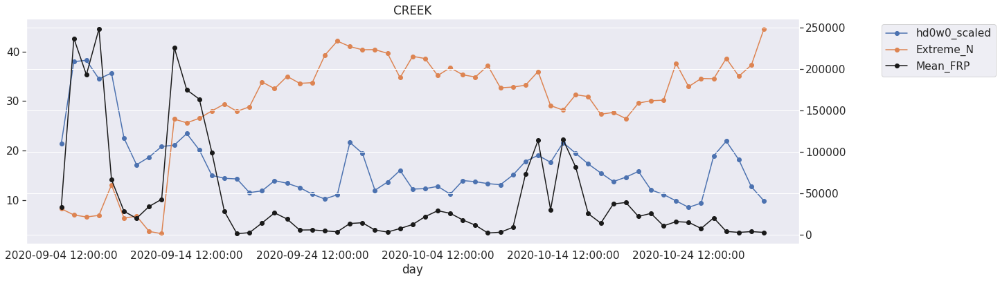

DOLAN


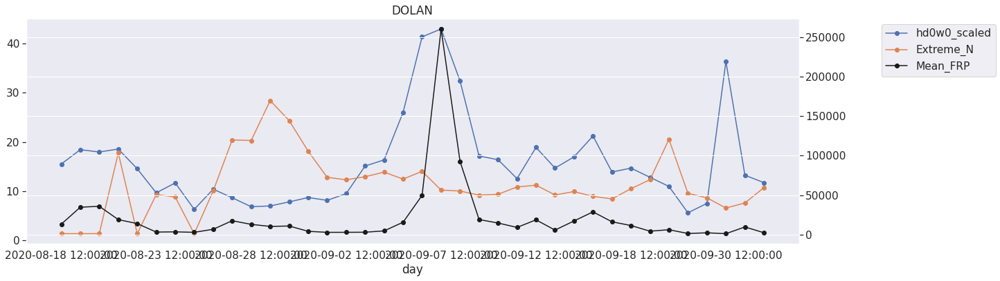

LAKE


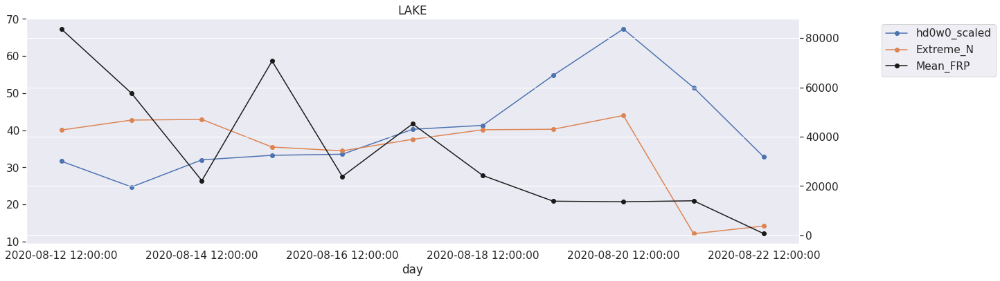

In [65]:
fire_incidents = ['AUGUST COMPLEX','BOBCAT', 'CREEK','DOLAN', 'LAKE'] #only california ones
for ii in range(len(fire_incidents)):
    print(fire_incidents[ii]) 
    features_plot = df_hrrr[df_hrrr['name']==fire_incidents[ii]]
    #print(features_plot)
    fig, ax = plt.subplots(figsize=(20,15)) 
    features_plot.plot(x='day', y=['hd0w0_scaled','Extreme_N'],
                            figsize=(20,6),style='o-',ax=ax )
    features_plot.plot(x='day', y=['Mean_FRP'],secondary_y=True,
                            figsize=(20,6),style='ko-',ax=ax )
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax.right_ax.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2,bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.title(fire_incidents[ii])
    plt.show()
    
    

## some PCA, as a treat

In [ ]:

from sklearn.preprocessing import StandardScaler # for standardizing the Data
from sklearn.decomposition import PCA # for PCA calculation

In [ ]:
df_hrrr=df_hrrr.drop(columns=['day','name'])


In [ ]:
X = df_hrrr.values # getting all values as a matrix of dataframe 
sc = StandardScaler() # creating a StandardScaler object
X_std = sc.fit_transform(X) # standardizing the data

In [ ]:
pca = PCA()
X_pca = pca.fit(X_std)

In [ ]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

In [ ]:
pca = PCA(n_components = 0.99)
X_pca = pca.fit_transform(X_std) # this will fit and reduce dimensions
print(pca.n_components_)

In [ ]:
num_components = 20
pca = PCA(num_components)  
X_pca = pca.fit_transform(X_std) # fit and reduce dimension

In [ ]:
pd.DataFrame(pca.components_, columns = df_hrrr.columns)

In [ ]:
n_pcs= pca.n_components_ # get number of component# get the index of the most important feature on EACH component
most_important = [np.abs(pca.components_[i]).argmax() for i in range(n_pcs)]

initial_feature_names = df_hrrr.columns
# get the most important feature names
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]
print(most_important_names)

## Compare Thapa and Chen Polygon Outputs

In [ ]:
creek_merra_thapa = pd.read_csv('fire_features/creek_Daily_MERRA_12Z_day_start.csv')
creek_merra_chen = pd.read_csv('fire_features/creek_Daily_MERRA_12Z_day_start_Chen.csv')

In [ ]:
print(creek_merra_thapa.head())
print(creek_merra_chen.head())

In [ ]:
print(len(creek_merra_thapa))
print(len(creek_merra_chen))

In [ ]:
fig, ax = plt.subplots(figsize=(20,6)) #set up the figure
ax.plot(creek_merra_thapa['day'], creek_merra_thapa['hd1w0'], 'ro-') # plot the first line
ax.set_ylabel('thapa poly', fontsize=24, color='red')
#ax.set_ylim(bottom=0,top = np.nanmax(datay))
ax2=ax.twinx()
ax2.plot(creek_merra_chen['day'], creek_merra_chen['hd1w0'], 'bo-') #plot the second line
ax2.set_ylabel('chen poly', fontsize=24, color='blue')
plt.xticks(np.arange(1,len(creek_merra_chen['day'].values),15))    
plt.show()